In [1]:
import xarray as xr
import os, glob, sys
import numpy as np
import pandas as pd
import time
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from mpl_toolkits.axes_grid1 import make_axes_locatable

root_dir = '/media/harish/SSD_4TB/EU_SCORES_project'
scripts_dir = f'{root_dir}/scripts'
sys.path.append(scripts_dir)

from analysis.plotters import map_plotter, all_sample_points, variability_plotter, months
from data_processing.libraries import longitude_convert_0_to_360, find_nearest_indice

fig_dir = f'{root_dir}/Reports/D6.4'

# Wind resource assessment

## 100 m wind speed

### Overall wind weibull statistics

In [151]:
cases = ['Portugal_coast','Ireland_coast','Netherlands_coast']
fig_widths = {'Portugal_coast': 5.5,
              'Ireland_coast': 5.5,
              'Netherlands_coast': 5.5}
fig_heights = {'Portugal_coast': 4.5,
              'Ireland_coast': 4,
              'Netherlands_coast': 4}
scale_clevels = {'Portugal_coast':np.arange(7,8.51,0.1),
                 'Ireland_coast':np.arange(10,12.1,0.1),
                 'Netherlands_coast':np.arange(10,11.51,0.1)}
shape_clevels = {'Portugal_coast':np.arange(1.5,2.1,0.05),
                 'Ireland_coast':np.arange(1.5,2.1,0.05),
                 'Netherlands_coast':np.arange(1.5,2.1,0.05)}
cmaps = {'scale':'tab20b',
         'shape':'tab20b'}

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (

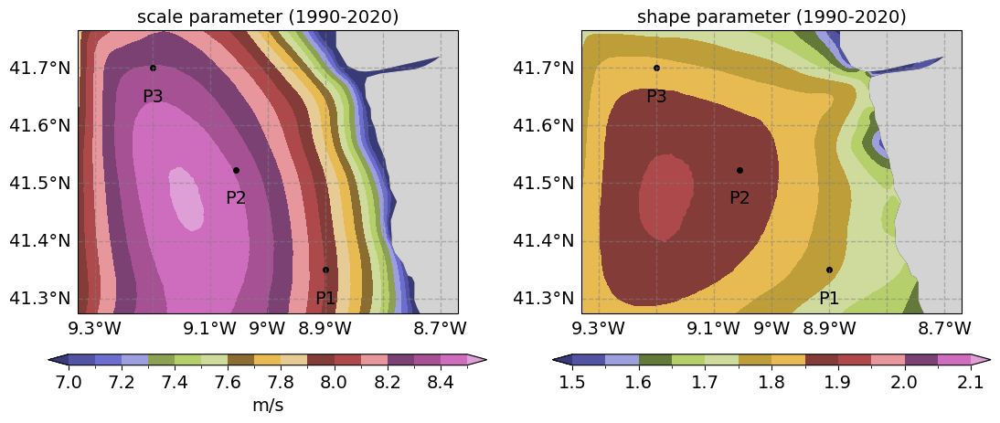

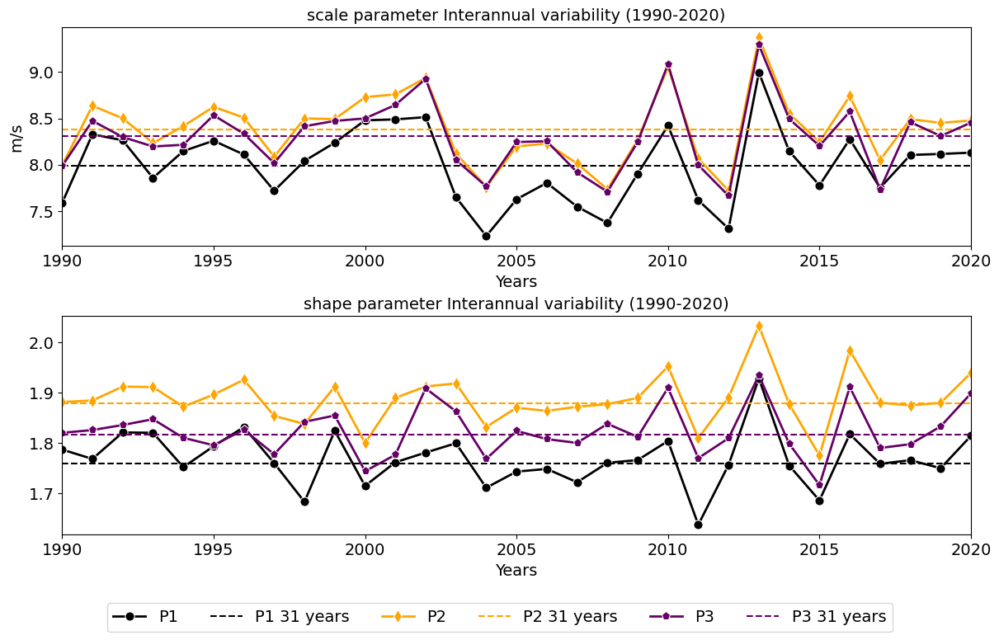

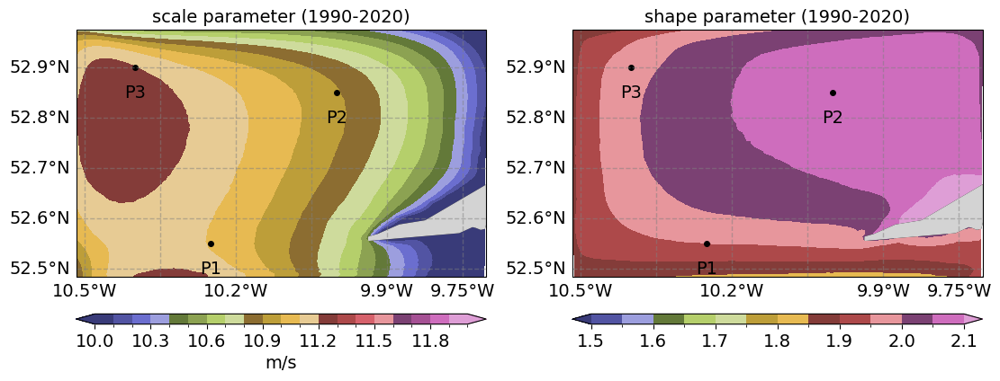

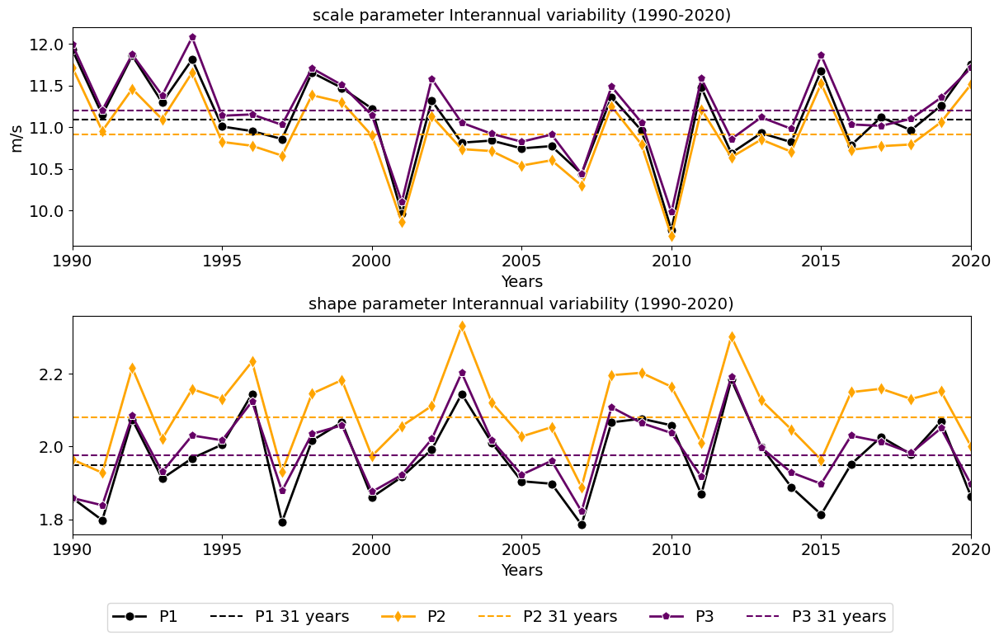

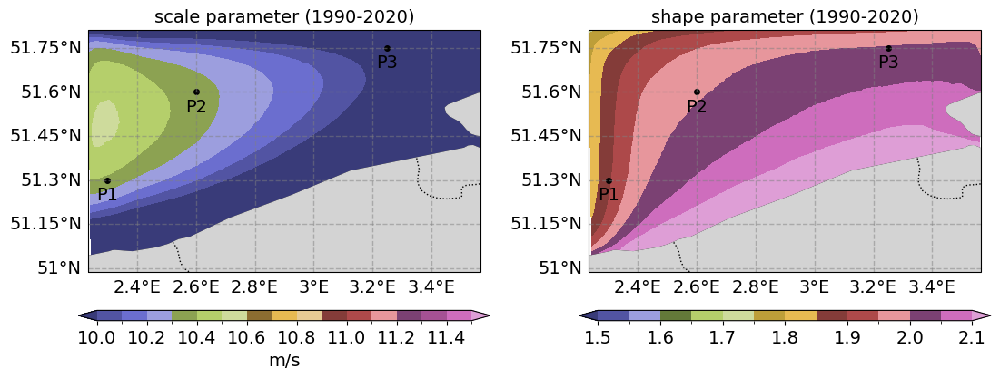

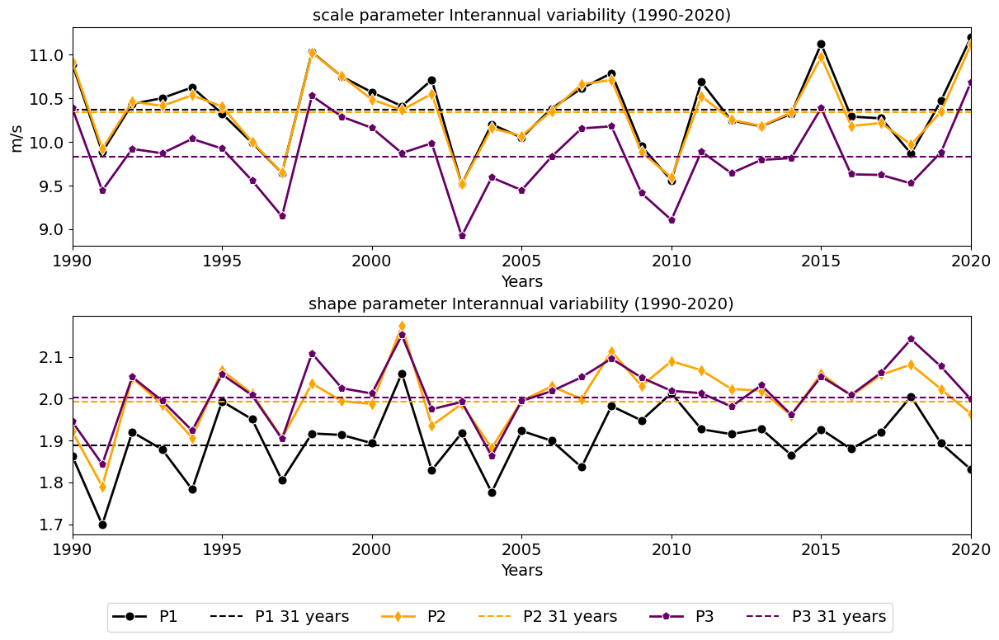

In [152]:
run = 'New_runs'
level = 100
for case in cases:
    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/ws_{level}'
    ds = xr.open_dataset(f'{target_dir}/weibull.nc')

    fig = plt.figure(figsize=(fig_widths[case]*2, fig_heights[case]), constrained_layout=True)
    gs = fig.add_gridspec(1,2)
    for j,parameter in enumerate(['scale', 'shape']):
        clevels = scale_clevels[case] if parameter == 'scale' else shape_clevels[case]
        cmap = cmaps[parameter]
        cbar_args= {'shrink':1,'cbar_label':'m/s','orientation':'horizontal'} if parameter == 'scale' else {'shrink':1,'cbar_label':'','orientation':'horizontal'}
        map_plotter(fig,gs[0,j],ds.overall_values.sel(parameter=parameter)[10:-10,10:-10],'XLONG','XLAT',
                    clevels,cmap,f'{parameter} parameter (1990-2020)',cbar_args,
                    sample_points = all_sample_points[case])
    plt.savefig(f'{fig_dir}/{case}_{level}m_overall_mean_wind_weibulls.png',dpi=300,bbox_inches='tight',pad_inches=0)

    fig = plt.figure(figsize=(12, 7), constrained_layout=True)
    gs = fig.add_gridspec(2,1)

    for j,parameter in enumerate(['scale', 'shape']):
        overall_df = pd.DataFrame()
        yearly_df = pd.DataFrame()
        for i,key in enumerate(all_sample_points[case].keys()):
            indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

            data = ds.overall_values.sel(parameter=parameter,south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index([0],name='Overall'))
            overall_df = pd.concat([overall_df, pointwise_df],axis=1)

            data = ds.yearly_values.sel(parameter=parameter,south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index(ds.year, name='year'))
            yearly_df = pd.concat([yearly_df, pointwise_df],axis=1)
        xlabel = 'Years' if parameter == 'scale' else ''
        xlabel_ticks = None if parameter == 'scale' else not None
        ylabel = 'm/s' if parameter == 'scale' else ''
        axs = variability_plotter(fig,gs[j,0],yearly_df,overall_df,f'{parameter} parameter Interannual variability (1990-2020)',
                            'Years',ylabel,None,None,None)

    # Extract legend from one of the subplots
    handles, labels = axs.get_legend_handles_labels()
    # Create a common legend below the figures
    fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.5, -0.1),fontsize=14)

    plt.savefig(f'{fig_dir}/{case}_{level}m_interannual_wind_weibulls.png',dpi=300,bbox_inches='tight',pad_inches=0)

### Monthly wind weibull statistics
- Plotting monthly statistics in the order of seasonal groups, such as: DJF, MAM, JJA, and SON

In [153]:
months_indices = [12,1,2,3,4,5,6,7,8,9,10,11]
months_in_seasonal_order = ['Dec','Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov']
scale_clevels = {'Portugal_coast':np.arange(7,9.1,0.1),
                 'Ireland_coast':np.arange(9,14.1,0.5),
                 'Netherlands_coast':np.arange(8,13.51,0.5)}
shape_clevels = {'Portugal_coast':np.arange(1.5,2.1,0.05),
                 'Ireland_coast':np.arange(1.9,2.41,0.05),
                 'Netherlands_coast':np.arange(1.8,2.31,0.05)}

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (

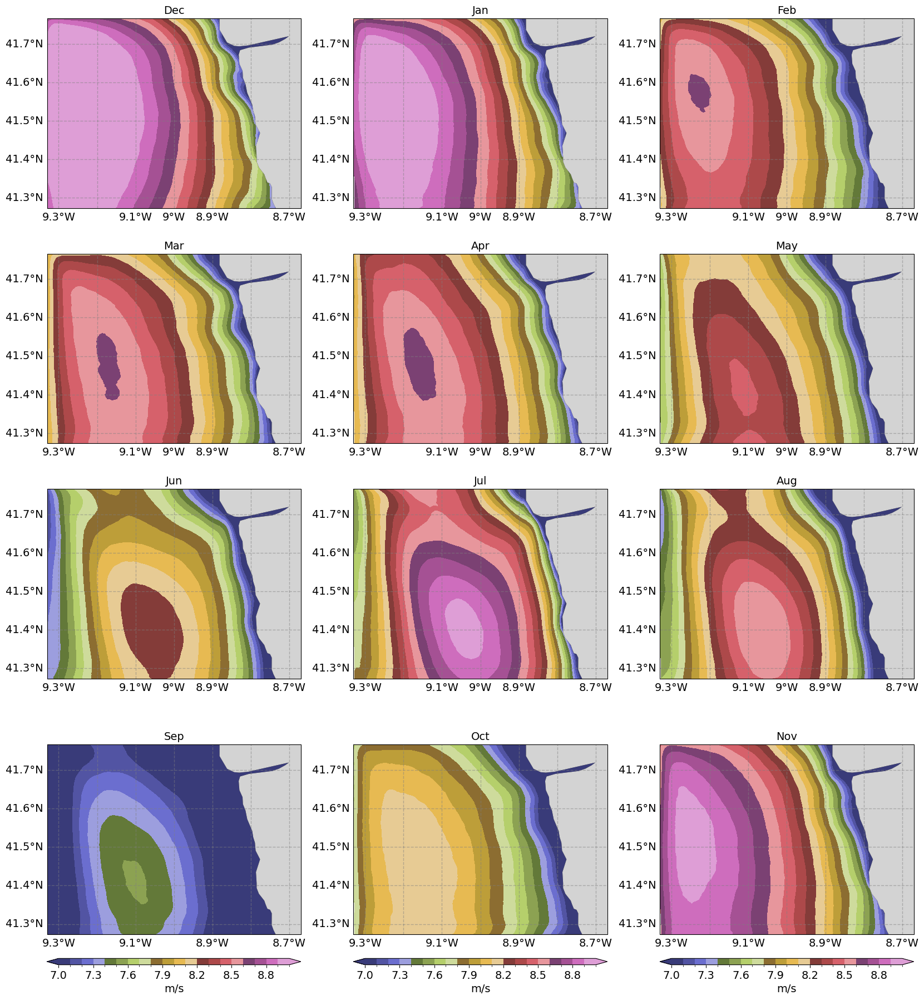

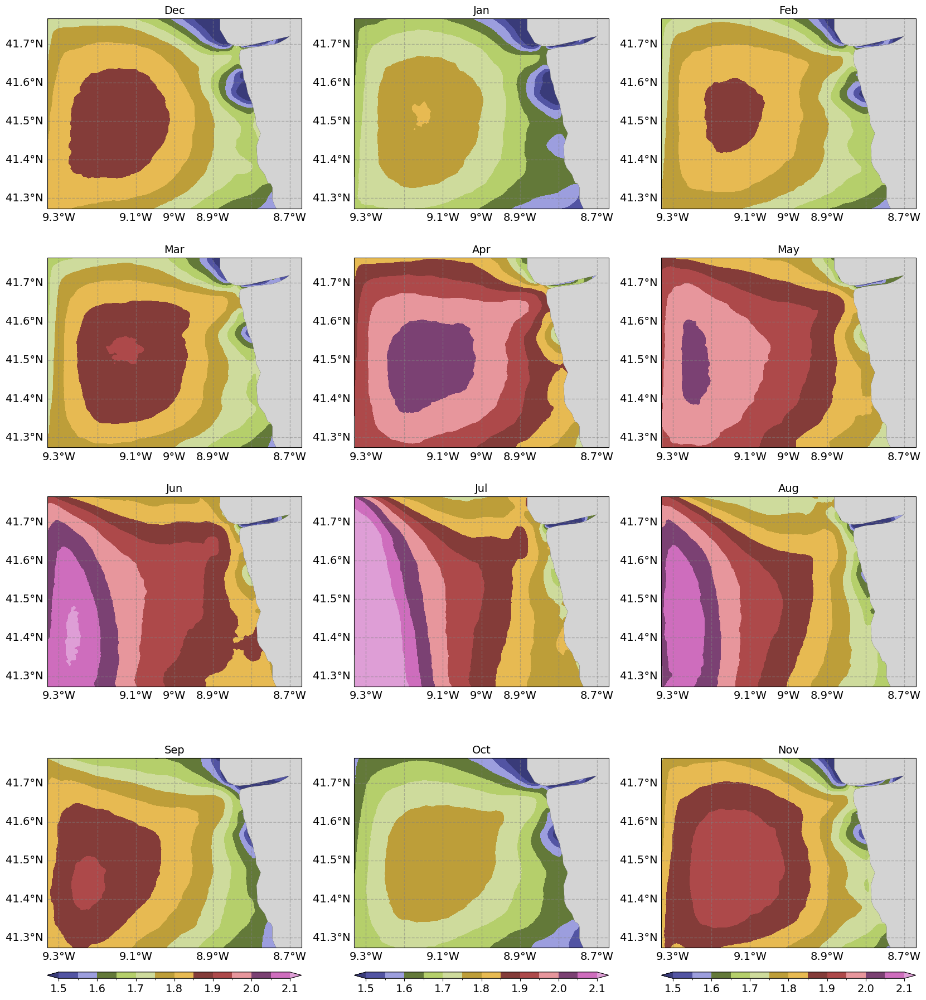

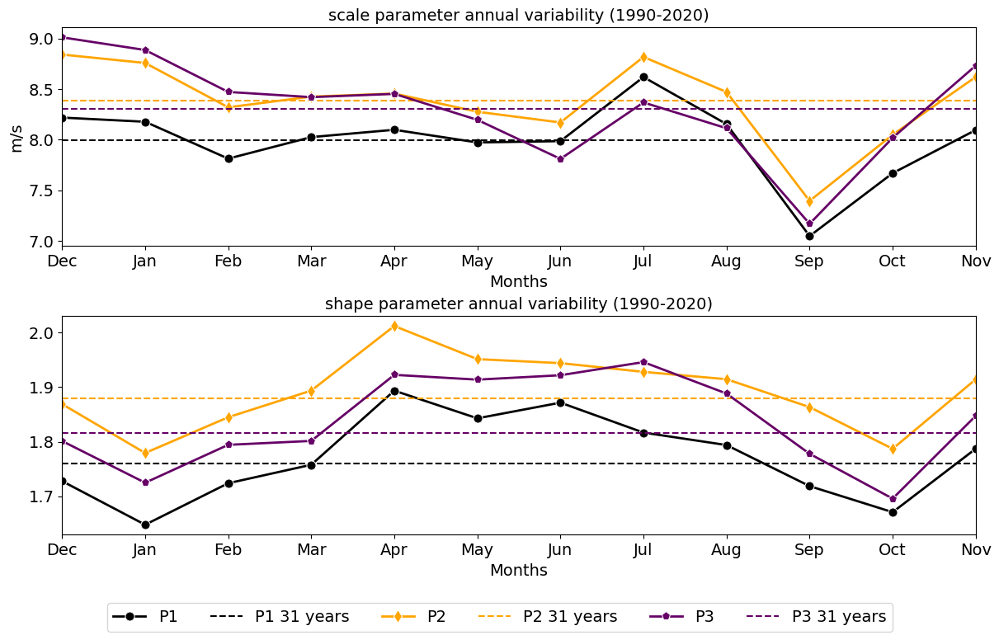

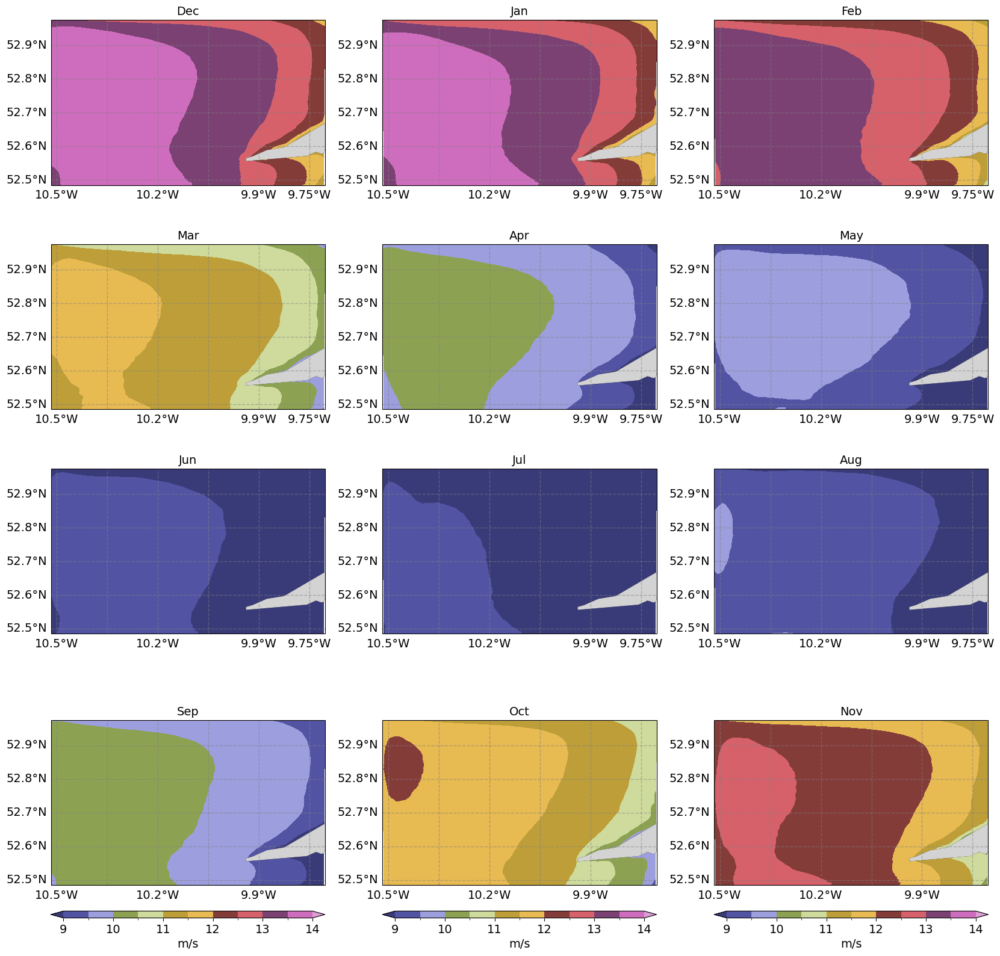

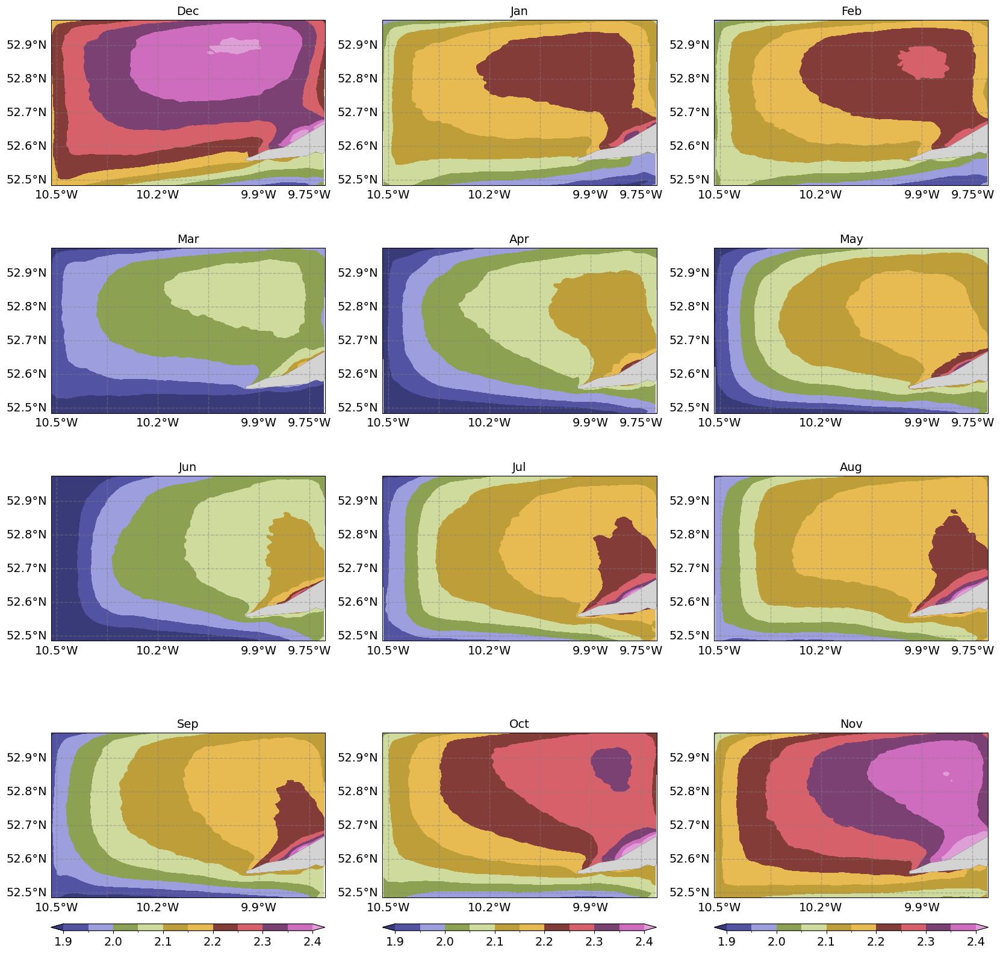

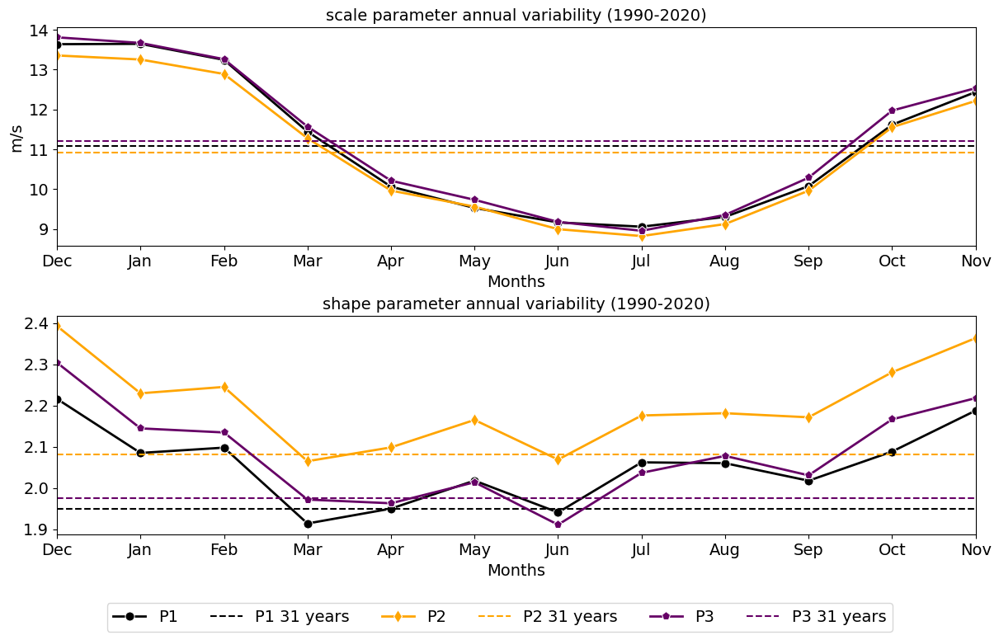

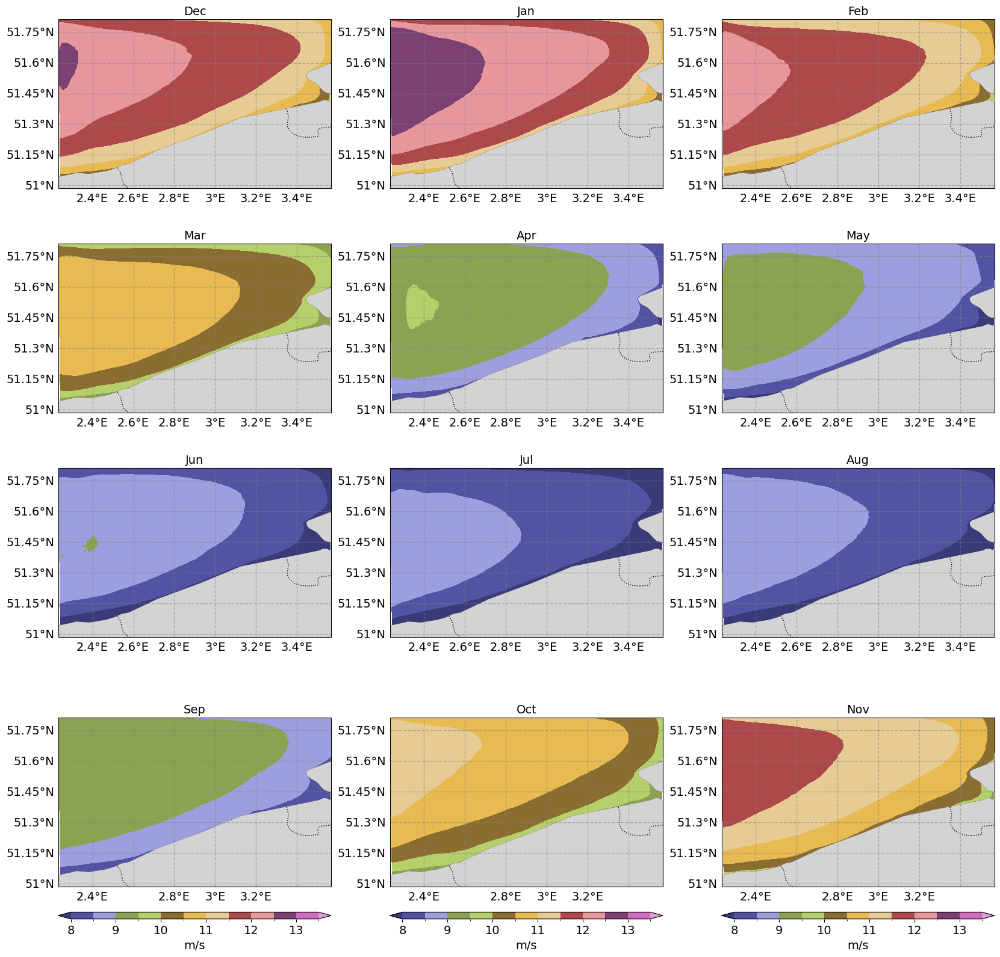

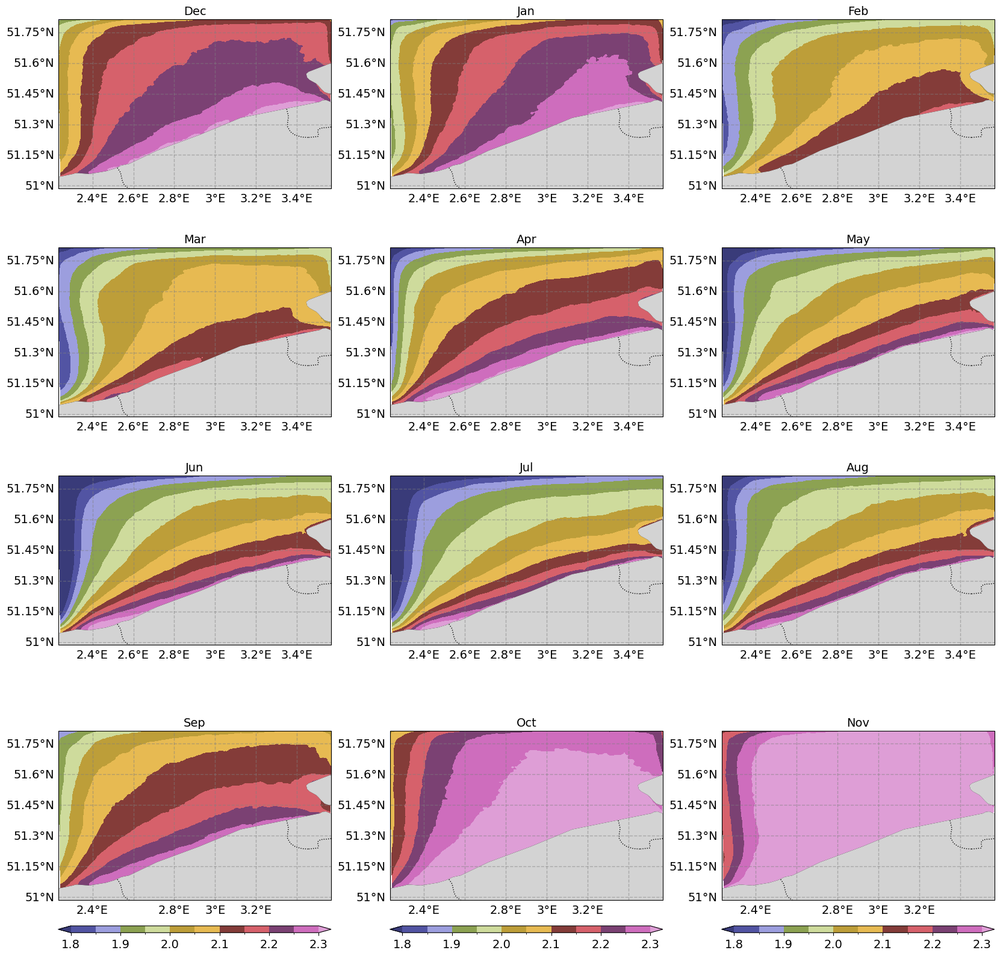

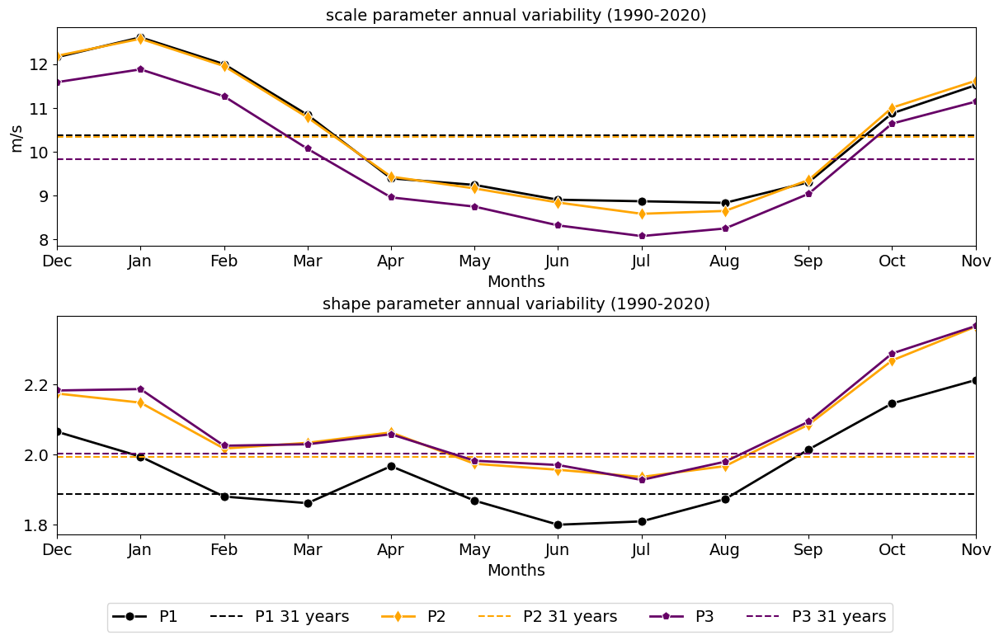

In [155]:
run = 'New_runs'
level = 100
for case in cases:
    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/ws_{level}'
    ds = xr.open_dataset(f'{target_dir}/weibull.nc')

    for j,parameter in enumerate(['scale', 'shape']):
        clevels = scale_clevels[case] if parameter == 'scale' else shape_clevels[case]
        cbar_args_={'shrink':1,'cbar_label':'m/s','orientation':'horizontal'} if parameter=='scale' else {'shrink':1,'cbar_label':'','orientation':'horizontal'}
        cmap = cmaps[parameter]
        rows, cols = 4,3
        fig = plt.figure(figsize=(fig_widths[case]*cols, rows*fig_heights[case]), constrained_layout=True)
        gs = fig.add_gridspec(rows,cols)
        for i,month in enumerate(months_indices):
            cbar_args=cbar_args_ if i//cols == 3 else None
            axs = map_plotter(fig,gs[i//cols,i%cols],ds.monthly_values.sel(parameter=parameter,month=month)[10:-10,10:-10],'XLONG','XLAT',
                    clevels,cmap,f'{months[month-1]}',cbar_args,
                    sample_points = None)
        plt.savefig(f'{fig_dir}/{case}_{level}m_monthly_mean_wind_weibulls_{parameter}.png',dpi=300,bbox_inches='tight',pad_inches=0)

    fig = plt.figure(figsize=(12, 7), constrained_layout=True)
    gs = fig.add_gridspec(2,1)

    for j,parameter in enumerate(['scale', 'shape']):
        overall_df = pd.DataFrame()
        monthly_df = pd.DataFrame()
        for i,key in enumerate(all_sample_points[case].keys()):
            indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

            data = ds.overall_values.sel(parameter=parameter,south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index([0],name='Overall'))
            overall_df = pd.concat([overall_df, pointwise_df],axis=1)

            data = ds.monthly_values.sel(parameter=parameter,south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index(months, name='month'))
            monthly_df = pd.concat([monthly_df, pointwise_df],axis=1)
        monthly_df = monthly_df.reindex(months_in_seasonal_order)

        xlabel = 'Months' if parameter == 'scale' else ''
        xlabel_ticks = months_in_seasonal_order
        ylabel = 'm/s' if parameter == 'scale' else ''
        axs = variability_plotter(fig,gs[j,0],monthly_df,overall_df,f'{parameter} parameter annual variability (1990-2020)',
                            'Months',ylabel,None,None,None,xlabel_ticks=xlabel_ticks)
    # Extract legend from one of the subplots
    handles, labels = axs.get_legend_handles_labels()
    # Create a common legend below the figures
    fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.5, -0.1),fontsize=14)

    plt.savefig(f'{fig_dir}/{case}_{level}m_annual_wind_weibulls.png',dpi=300,bbox_inches='tight',pad_inches=0)

### Diurnal wind weibull statistics

In [132]:
scale_clevels = {'Portugal_coast':np.arange(7,9.1,0.2),
                 'Ireland_coast':np.arange(10.5,11.51,0.2),
                 'Netherlands_coast':np.arange(9.5,11.1,0.2)}
shape_clevels = {'Portugal_coast':np.arange(1.6,2.1,0.1),
                 'Ireland_coast':np.arange(1.8,2.21,0.1),
                 'Netherlands_coast':np.arange(1.8,2.1,0.1)}

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (

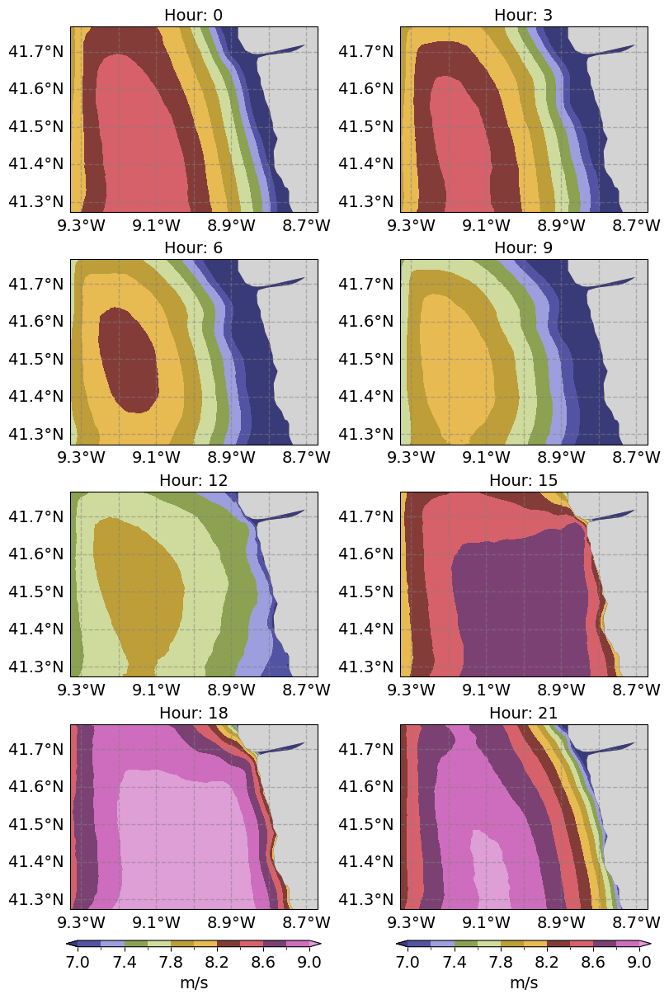

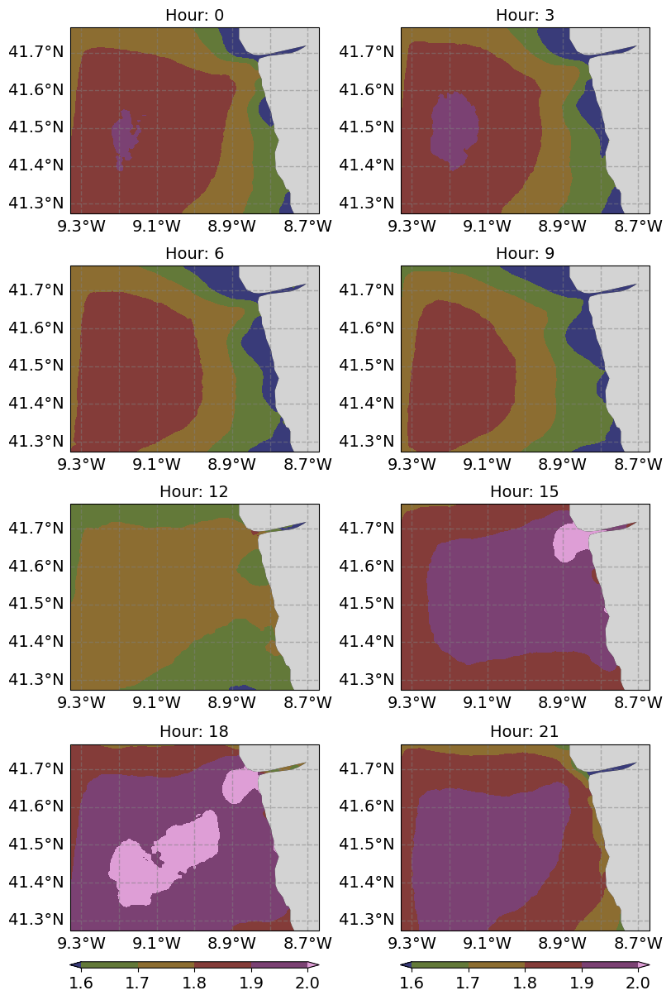

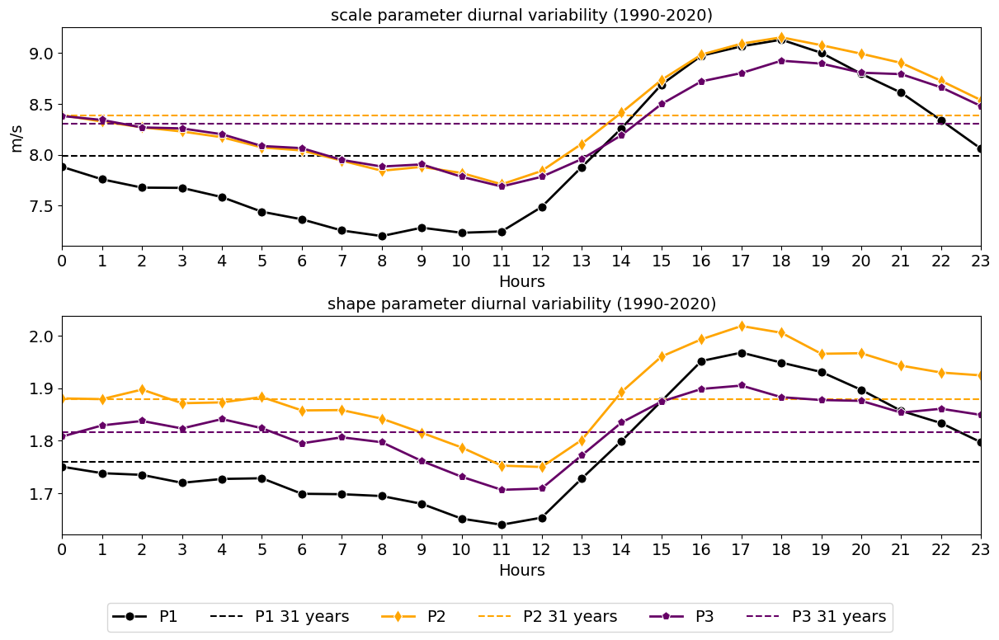

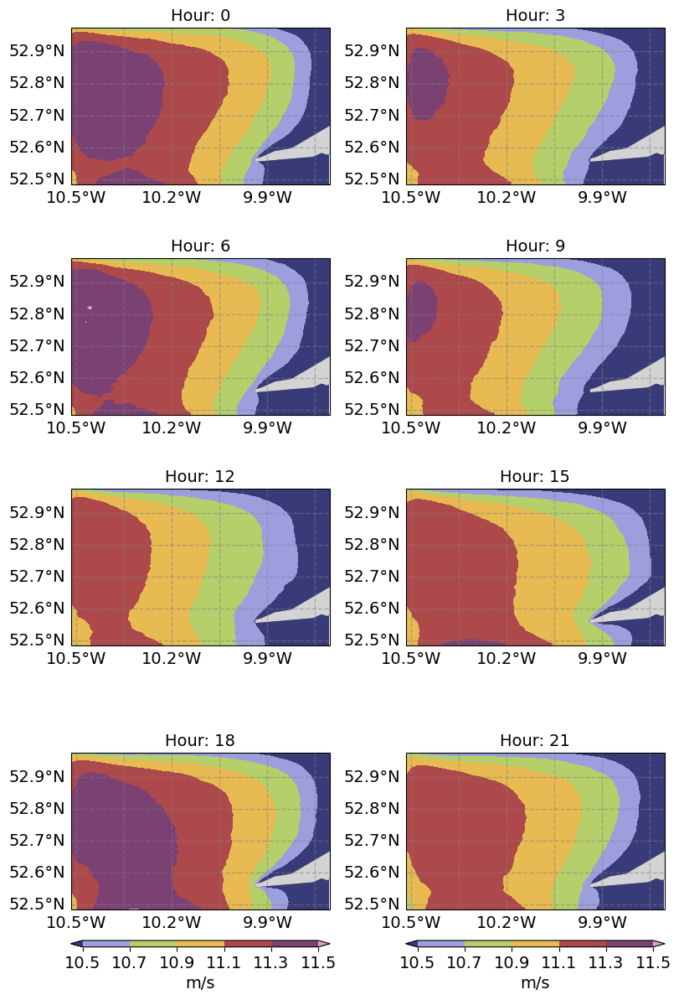

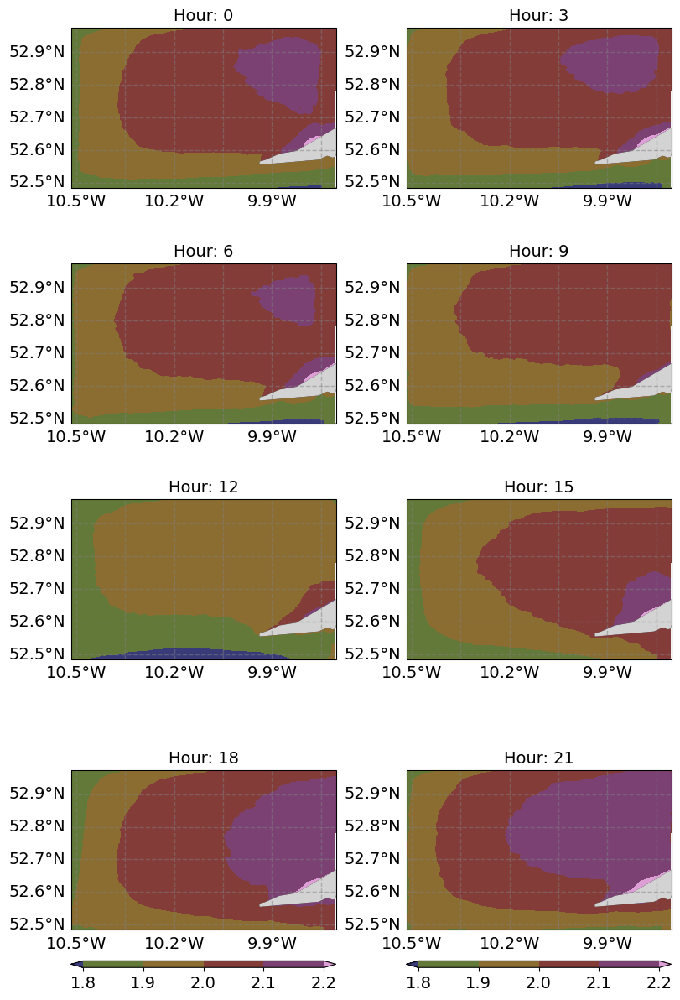

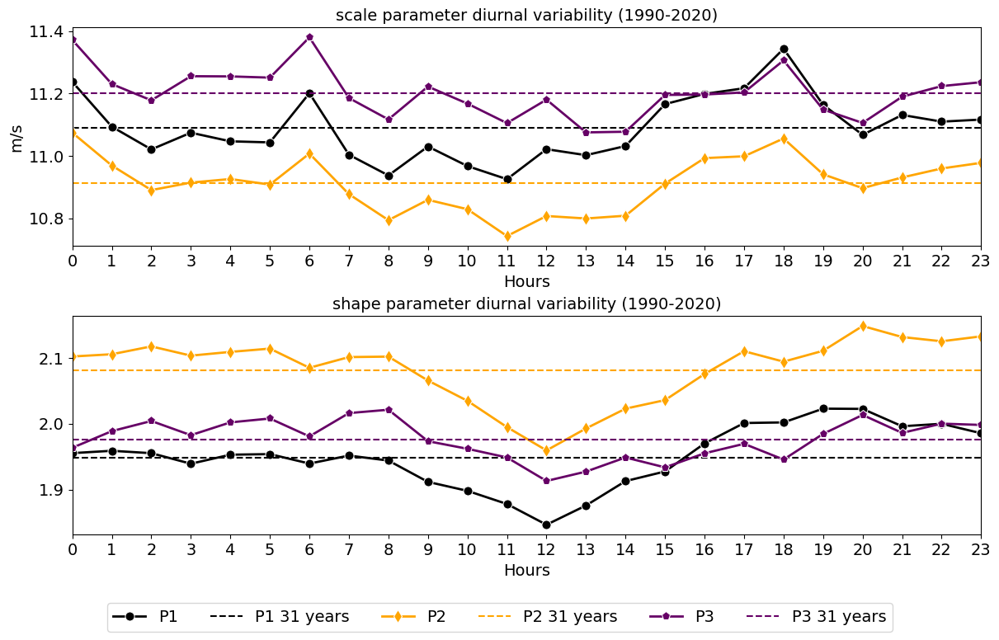

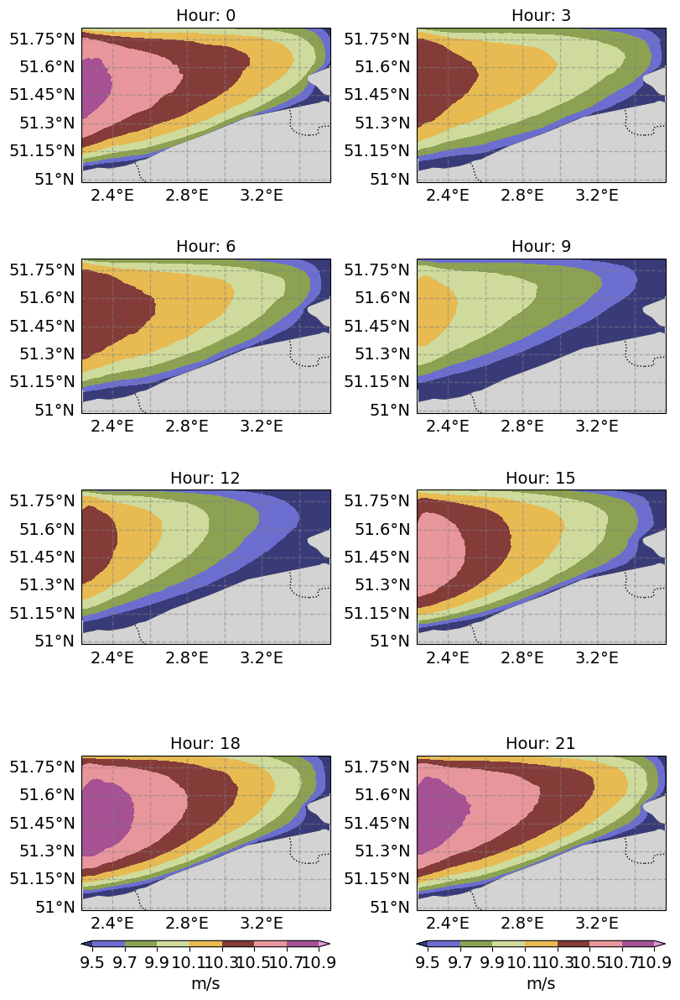

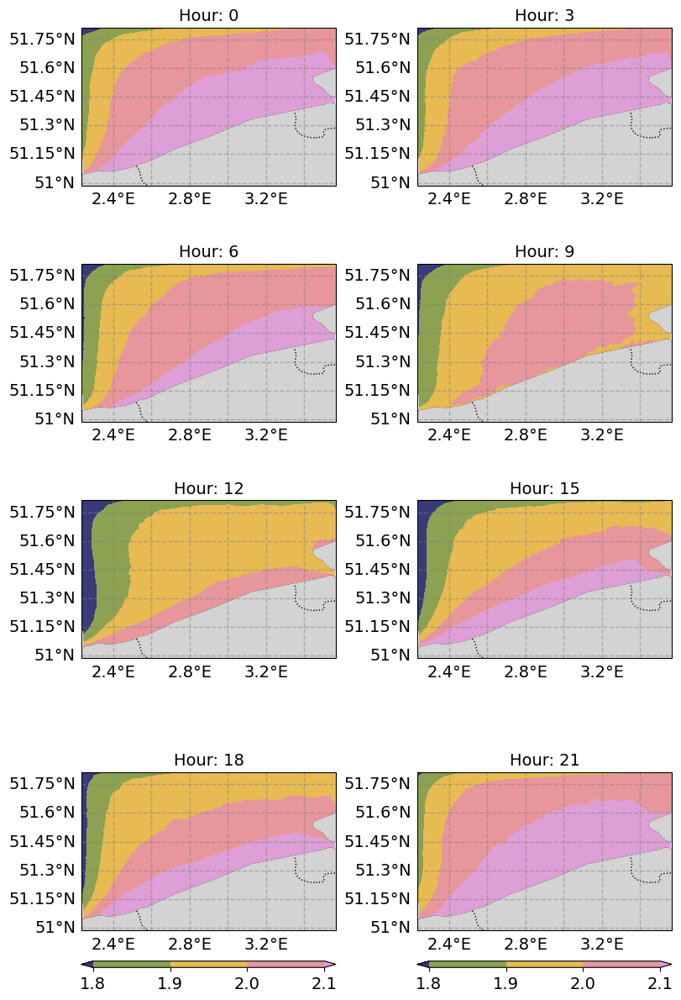

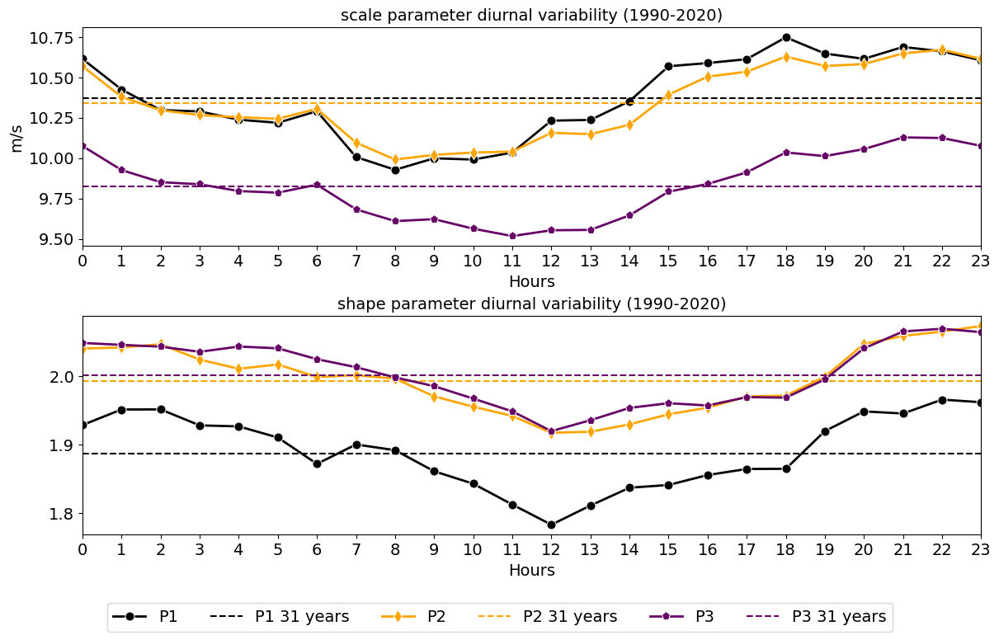

In [133]:
run = 'New_runs'
level = 100
for case in cases:
    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/ws_{level}'
    ds = xr.open_dataset(f'{target_dir}/weibull.nc')

    for j,parameter in enumerate(['scale', 'shape']):
        clevels = scale_clevels[case] if parameter == 'scale' else shape_clevels[case]
        cbar_args_={'shrink':1,'cbar_label':'m/s','orientation':'horizontal'} if parameter=='scale' else {'shrink':1,'cbar_label':'','orientation':'horizontal'}
        cmap = cmaps[parameter]
        rows, cols = 4,2
        fig = plt.figure(figsize=(cols*4, rows*3), constrained_layout=True)
        gs = fig.add_gridspec(rows,cols)
        for i,hour in enumerate(ds.hour.values[::3]):
            cbar_args=cbar_args_ if i//cols == 3 else None
            axs = map_plotter(fig,gs[i//cols,i%cols],ds.hourly_values.sel(parameter=parameter,hour=hour)[10:-10,10:-10],'XLONG','XLAT',
                    clevels,cmap,f'Hour: {hour}',cbar_args,
                    sample_points = None)
        plt.savefig(f'{fig_dir}/{case}_{level}m_hourly_mean_wind_weibulls_{parameter}.png',dpi=300,bbox_inches='tight',pad_inches=0)


    fig = plt.figure(figsize=(12, 7), constrained_layout=True)
    gs = fig.add_gridspec(2,1)

    for j,parameter in enumerate(['scale', 'shape']):
        overall_df = pd.DataFrame()
        hourly_df = pd.DataFrame()
        for i,key in enumerate(all_sample_points[case].keys()):
            indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

            data = ds.overall_values.sel(parameter=parameter,south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index([0],name='Overall'))
            overall_df = pd.concat([overall_df, pointwise_df],axis=1)

            data = ds.hourly_values.sel(parameter=parameter,south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index(ds.hour, name='hour'))
            hourly_df = pd.concat([hourly_df, pointwise_df],axis=1)

        xlabel = 'Hours' if parameter == 'scale' else ''
        xlabel_ticks = ds.hour.values
        ylabel = 'm/s' if parameter == 'scale' else ''
        axs = variability_plotter(fig,gs[j,0],hourly_df,overall_df,f'{parameter} parameter diurnal variability (1990-2020)',
                            'Hours',ylabel,None,None,None,xlabel_ticks=xlabel_ticks)
    # Extract legend from one of the subplots
    handles, labels = axs.get_legend_handles_labels()
    # Create a common legend below the figures
    fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.5, -0.1),fontsize=14)

    plt.savefig(f'{fig_dir}/{case}_{level}m_diurnal_wind_weibulls.png',dpi=300,bbox_inches='tight',pad_inches=0)

## 100 m wind power density

### Overall wind power density sttistics

In [164]:
cases = ['Portugal_coast','Ireland_coast','Netherlands_coast']
WPD_clevels = {'Portugal_coast':np.arange(350,650.1,50),
                 'Ireland_coast':np.arange(700,1500.1,100),
                 'Netherlands_coast':np.arange(600,1200.1,100)}
cmaps = 'tab20b'

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (78, 18)
Closest indices in the order of latitude (y) and longitude (x) are : (142, 59)
Closest indices in the order of latitude (y) and longitude (x) are : (175, 146)


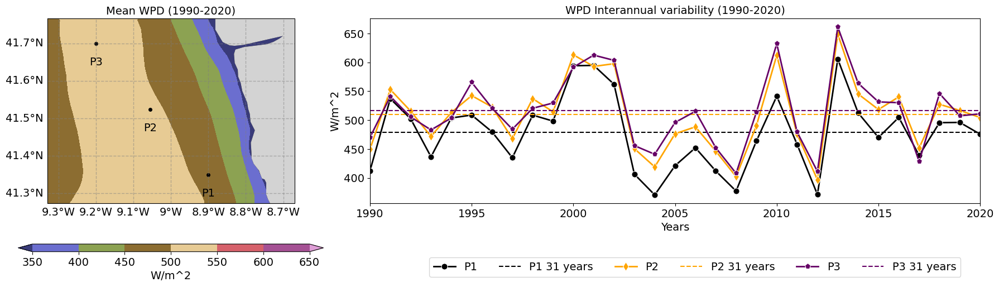

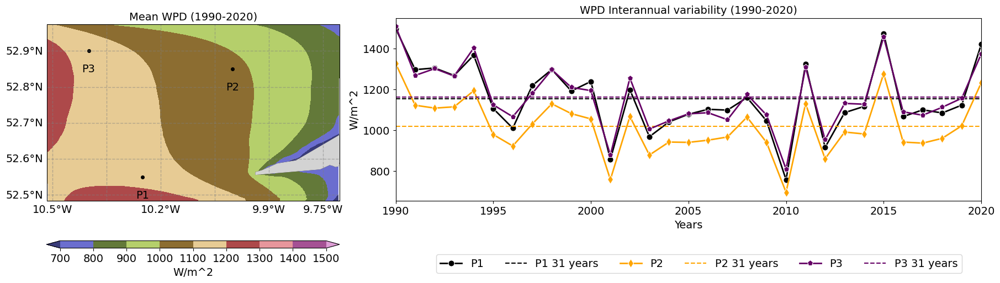

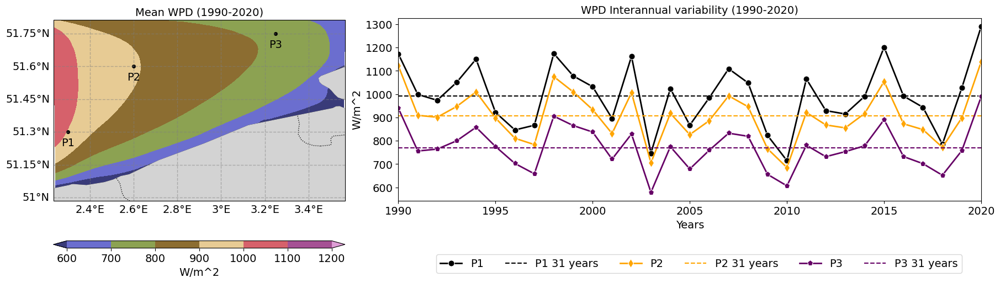

In [135]:
run = 'New_runs'
level = 100
for case in cases:
    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/wpd_{level}'
    ds = xr.open_dataset(f'{target_dir}/mean.nc')
    
    fig = plt.figure(figsize=(18, 5), constrained_layout=True)
    gs = fig.add_gridspec(1,3)
    
    clevels = WPD_clevels[case]
    cmap = cmaps
    cbar_args= {'shrink':1,'cbar_label':'W/m^2','orientation':'horizontal'} 
    map_plotter(fig,gs[0,0],ds.overall_values[10:-10,10:-10],'XLONG','XLAT',
                clevels,cmap,f'Mean WPD (1990-2020)',cbar_args,
                sample_points = all_sample_points[case])

    overall_df = pd.DataFrame()
    yearly_df = pd.DataFrame()
    for i,key in enumerate(all_sample_points[case].keys()):
        indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

        data = ds.yearly_values.sel(south_north=indices[0],west_east=indices[1]).values
        pointwise_df = pd.DataFrame({key: data}, index=pd.Index(ds.year, name='year'))
        yearly_df = pd.concat([yearly_df, pointwise_df],axis=1)
    xlabel = 'Years'
    ylabel = 'W/m^2'
    axs = variability_plotter(fig,gs[0,1:3],yearly_df,None,f'WPD Interannual variability (1990-2020)',
                        'Years',ylabel,None,None,None)

    # Extract legend from one of the subplots
    handles, labels = axs.get_legend_handles_labels()
    # Create a common legend below the figures
    fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.7, -0.00),fontsize=14)

    plt.savefig(f'{fig_dir}/{case}_{level}m_overall_mean_and_interannual_WPD.png',dpi=300,bbox_inches='tight',pad_inches=0)

### Monthly wind power density statistics

In [173]:
months_indices = [12,1,2,3,4,5,6,7,8,9,10,11]
months_in_seasonal_order = ['Dec','Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov']
WPD_clevels = {'Portugal_coast':np.arange(300,700.1,50),
                 'Ireland_coast':np.arange(500,2000.1,100),
                 'Netherlands_coast':np.arange(500,1700.1,100)}

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (78, 18)
Closest indices in the order of latitude (y) and longitude (x) are : (142, 59)
Closest indices in the order of latitude (y) and longitude (x) are : (175, 146)


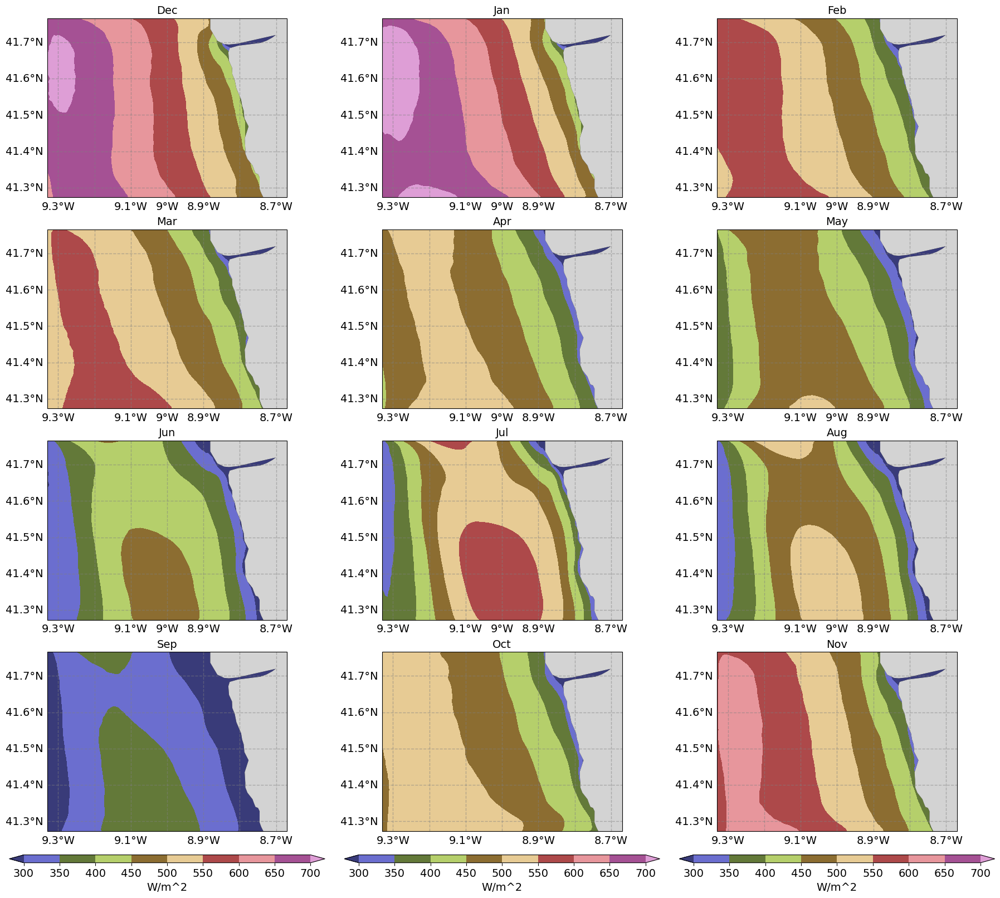

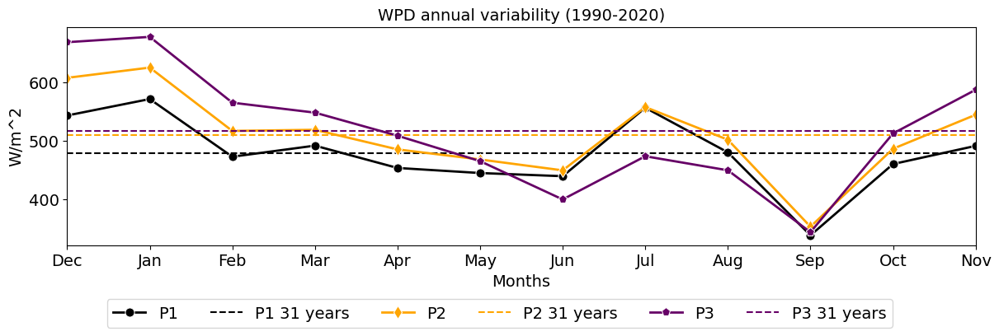

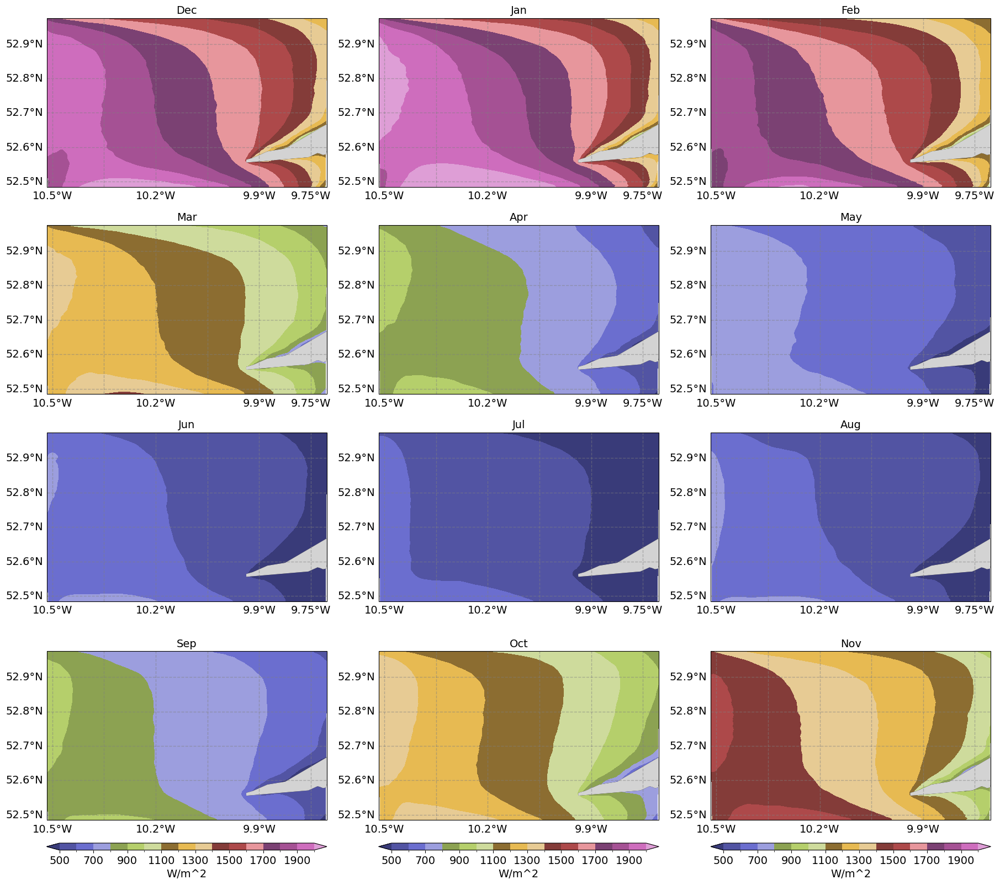

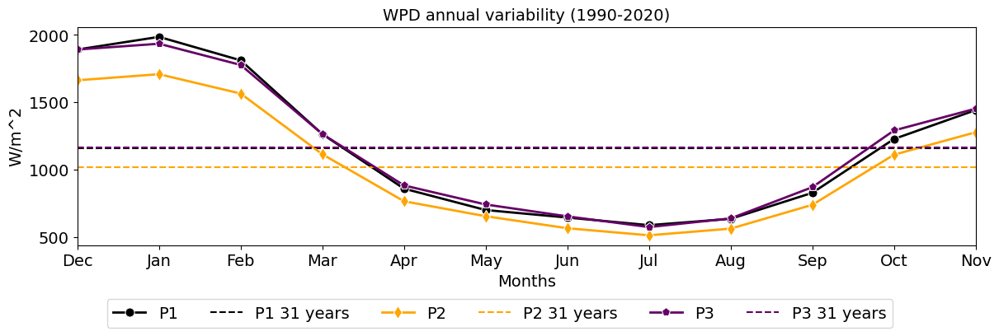

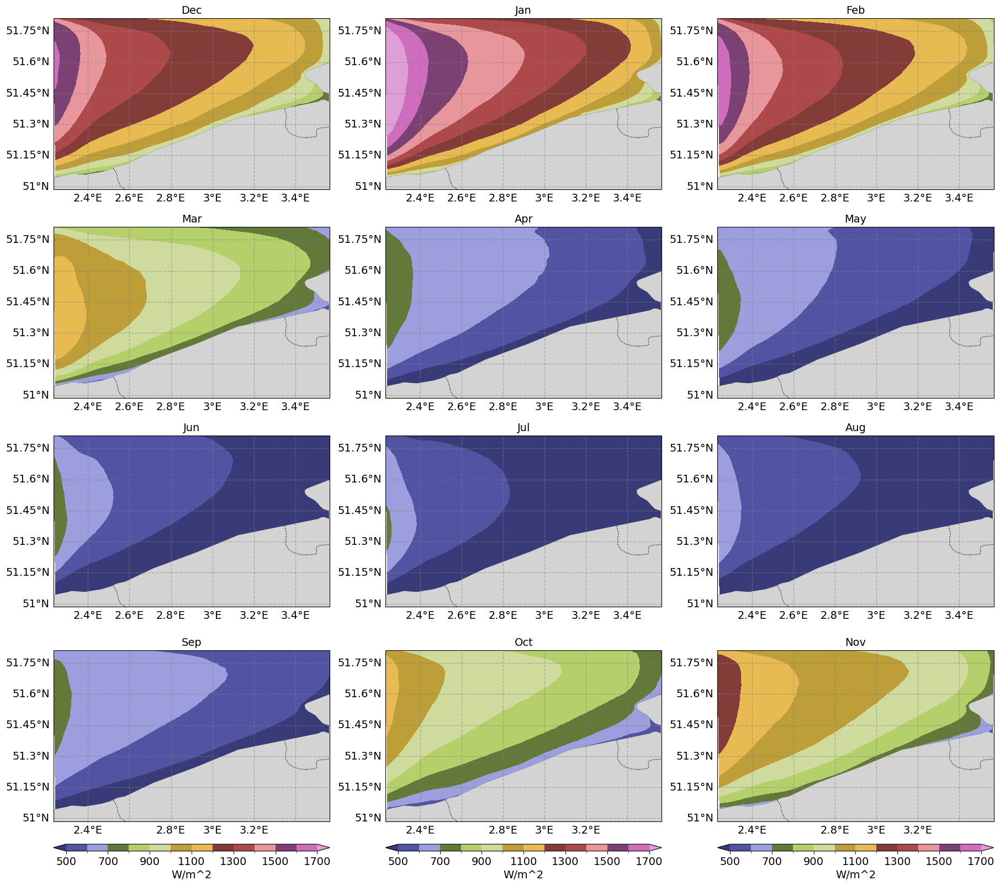

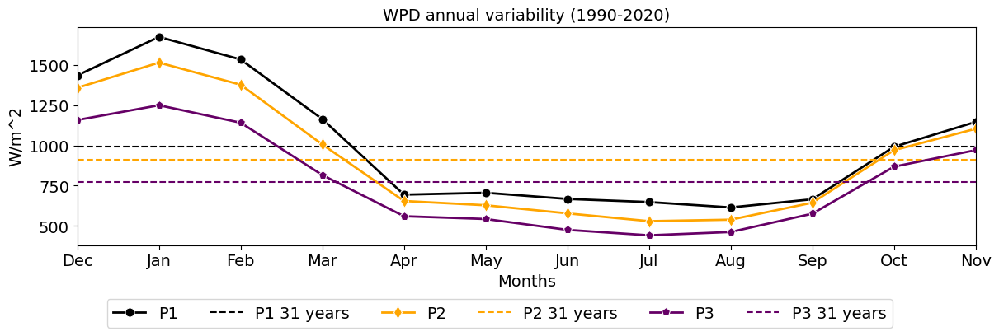

In [174]:
run = 'New_runs'
level = 100
for case in cases:
    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/wpd_{level}'
    ds = xr.open_dataset(f'{target_dir}/mean.nc')

    clevels = WPD_clevels[case]
    cbar_args_={'shrink':1,'cbar_label':'W/m^2','orientation':'horizontal'}
    cmap = cmaps
    rows, cols = 4,3
    fig = plt.figure(figsize=(cols*6, rows*4), constrained_layout=True)
    gs = fig.add_gridspec(rows,cols)
    for i,month in enumerate(months_indices):
        cbar_args=cbar_args_ if i//cols == 3 else None
        axs = map_plotter(fig,gs[i//cols,i%cols],ds.monthly_values.sel(month=month)[10:-10,10:-10],'XLONG','XLAT',
                clevels,cmap,f'{months[month-1]}',cbar_args,
                sample_points = None)
    plt.savefig(f'{fig_dir}/{case}_{level}m_monthly_mean_WPD.png',dpi=300,bbox_inches='tight',pad_inches=0)

    fig = plt.figure(figsize=(12, 3.5), constrained_layout=True)
    gs = fig.add_gridspec(1,1)

    overall_df = pd.DataFrame()
    monthly_df = pd.DataFrame()
    for i,key in enumerate(all_sample_points[case].keys()):
        indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

        data = ds.monthly_values.sel(south_north=indices[0],west_east=indices[1]).values
        pointwise_df = pd.DataFrame({key: data}, index=pd.Index(months, name='month'))
        monthly_df = pd.concat([monthly_df, pointwise_df],axis=1)
    monthly_df = monthly_df.reindex(months_in_seasonal_order)

    xlabel = 'Months'
    xlabel_ticks = months_in_seasonal_order
    ylabel = 'W/m^2'
    axs = variability_plotter(fig,gs[0],monthly_df,None,f'WPD annual variability (1990-2020)',
                        'Months',ylabel,None,None,None,xlabel_ticks=xlabel_ticks)
    # Extract legend from one of the subplots
    handles, labels = axs.get_legend_handles_labels()
    # Create a common legend below the figures
    fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.5, -0.15),fontsize=14)

    plt.savefig(f'{fig_dir}/{case}_{level}m_WPD.png',dpi=300,bbox_inches='tight',pad_inches=0)

### Diurnal wind power density statistics

In [171]:
months_indices = [12,1,2,3,4,5,6,7,8,9,10,11]
months_in_seasonal_order = ['Dec','Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov']
WPD_clevels = {'Portugal_coast':np.arange(350,650.1,50),
                 'Ireland_coast':np.arange(950,1250.1,50),
                 'Netherlands_coast':np.arange(700,1100.1,50)}

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (78, 18)
Closest indices in the order of latitude (y) and longitude (x) are : (142, 59)
Closest indices in the order of latitude (y) and longitude (x) are : (175, 146)


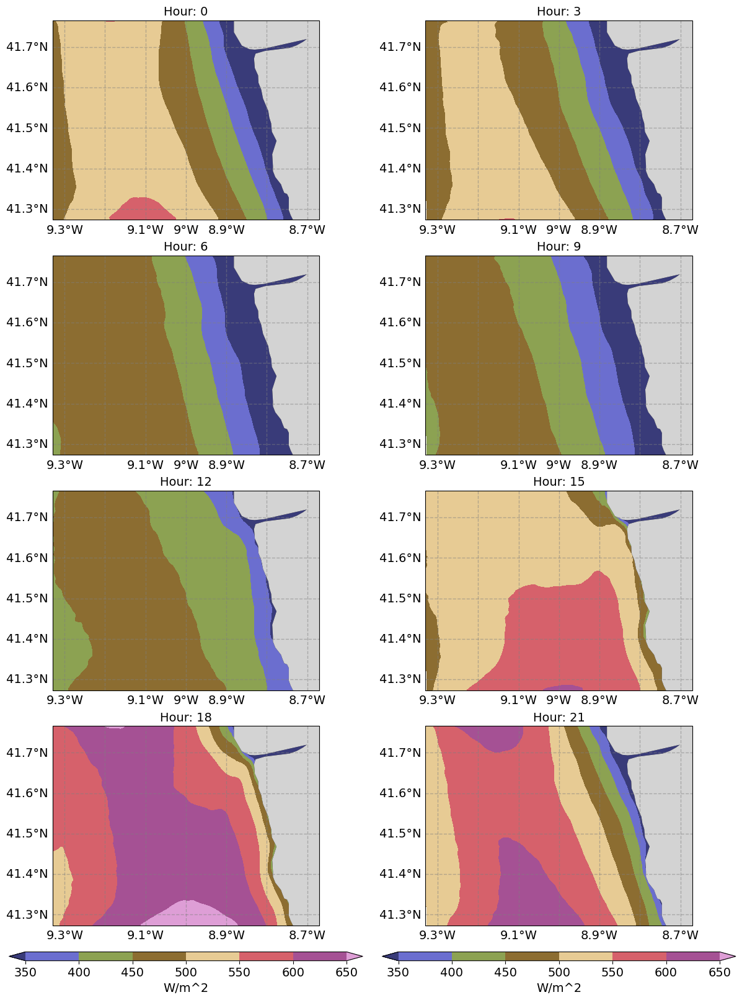

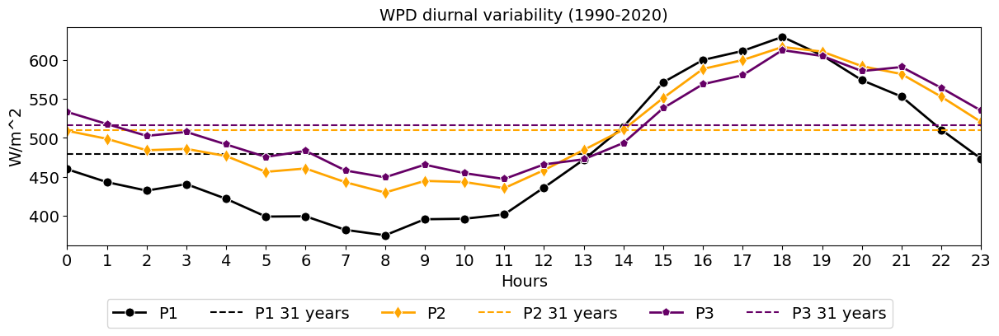

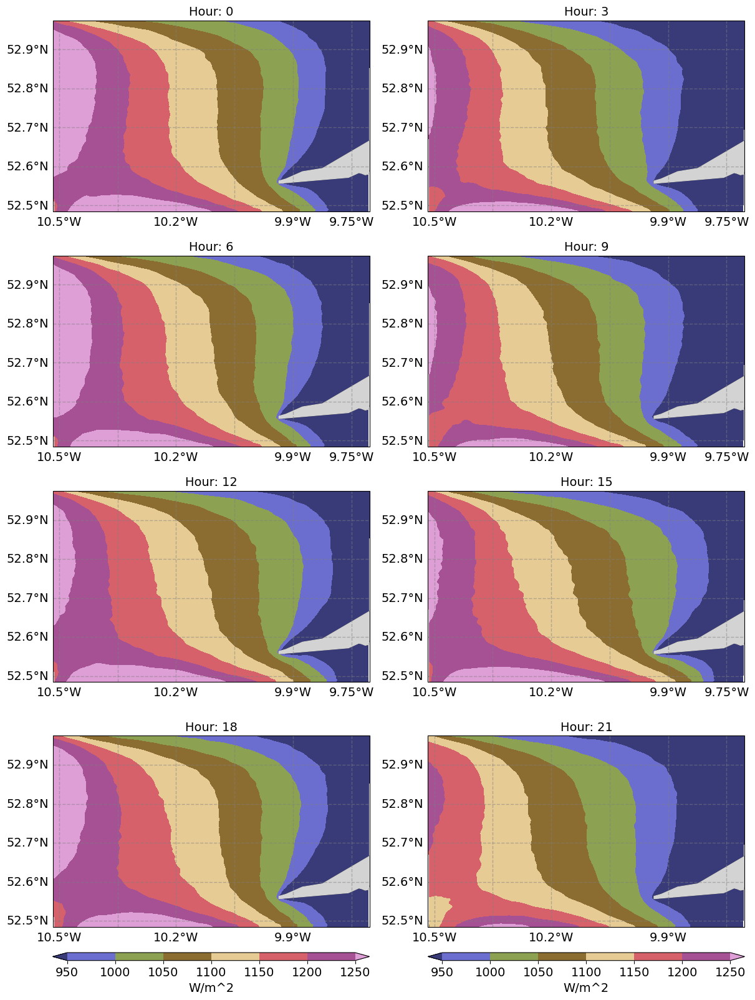

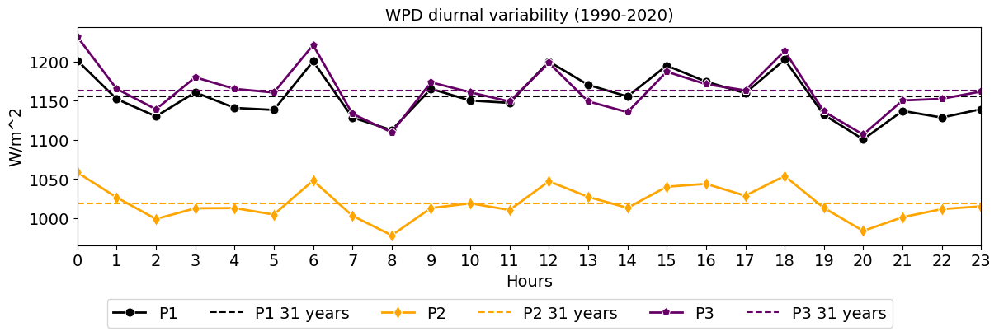

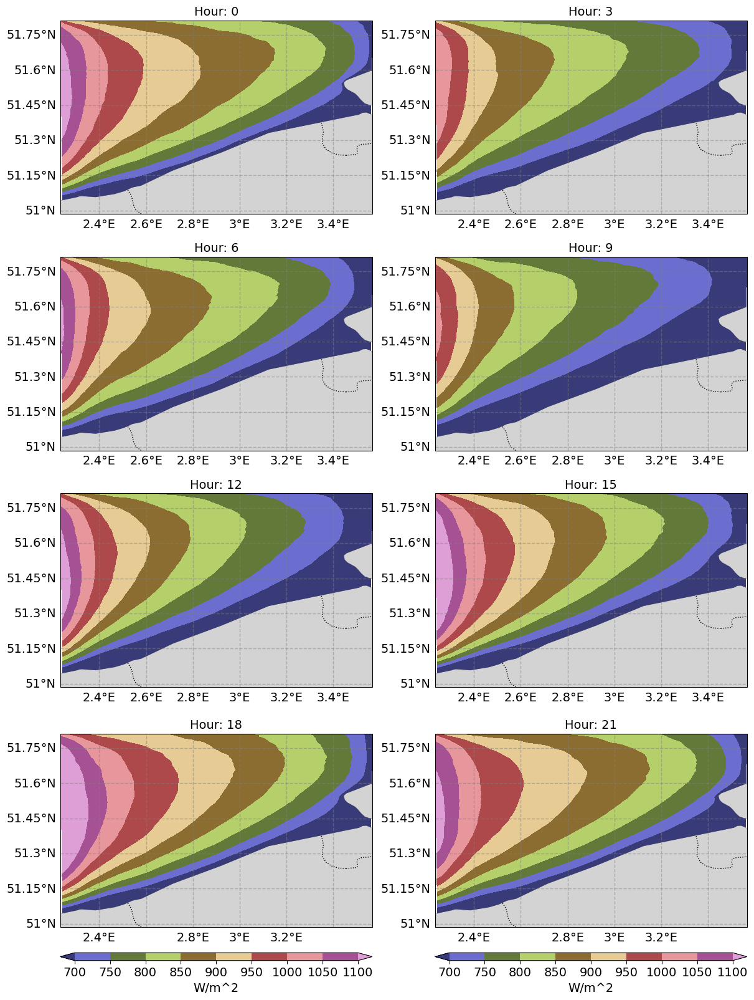

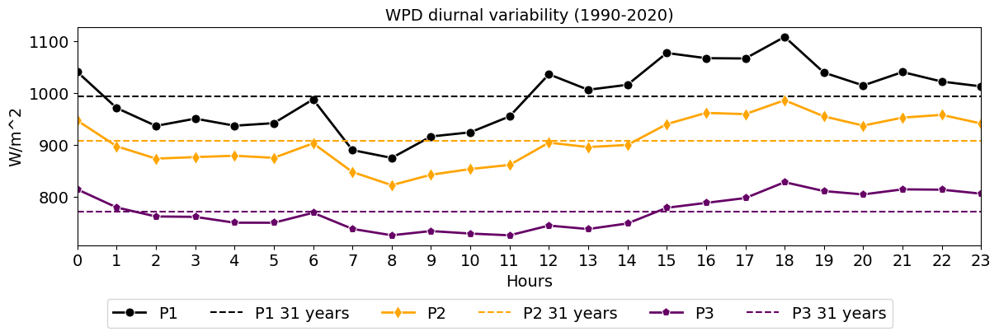

In [172]:
run = 'New_runs'
level = 100
for case in cases:
    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/wpd_{level}'
    ds = xr.open_dataset(f'{target_dir}/mean.nc')

    clevels = WPD_clevels[case]
    cbar_args_={'shrink':1,'cbar_label':'W/m^2','orientation':'horizontal'}
    cmap = cmaps
    rows, cols = 4,2
    fig = plt.figure(figsize=(cols*6, rows*4), constrained_layout=True)
    gs = fig.add_gridspec(rows,cols)
    for i,hour in enumerate(ds.hour.values[::3]):
        cbar_args=cbar_args_ if i//cols == 3 else None
        axs = map_plotter(fig,gs[i//cols,i%cols],ds.hourly_values.sel(hour=hour)[10:-10,10:-10],'XLONG','XLAT',
                clevels,cmap,f'Hour: {hour}',cbar_args,
                sample_points = None)
    plt.savefig(f'{fig_dir}/{case}_{level}m_hourly_mean_WPD.png',dpi=300,bbox_inches='tight',pad_inches=0)

    fig = plt.figure(figsize=(12, 3.5), constrained_layout=True)
    gs = fig.add_gridspec(1,1)

    overall_df = pd.DataFrame()
    hourly_df = pd.DataFrame()
    for i,key in enumerate(all_sample_points[case].keys()):
        indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

        data = ds.hourly_values.sel(south_north=indices[0],west_east=indices[1]).values
        pointwise_df = pd.DataFrame({key: data}, index=pd.Index(ds.hour.values, name='hour'))
        hourly_df = pd.concat([hourly_df, pointwise_df],axis=1)

    xlabel = 'Hours'
    xlabel_ticks = ds.hour.values
    ylabel = 'W/m^2'
    axs = variability_plotter(fig,gs[0],hourly_df,None,f'WPD diurnal variability (1990-2020)',
                        'Hours',ylabel,None,None,None,xlabel_ticks=xlabel_ticks)
    # Extract legend from one of the subplots
    handles, labels = axs.get_legend_handles_labels()
    # Create a common legend below the figures
    fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.5, -0.15),fontsize=14)

    plt.savefig(f'{fig_dir}/{case}_{level}m_diurnal_WPD.png',dpi=300,bbox_inches='tight',pad_inches=0)

# Solar resource assessment

## 10 m wind speed

### Overall 10m wind weibull statistics

In [193]:
cases = ['Portugal_coast','Ireland_coast','Netherlands_coast']
fig_widths = {'Portugal_coast': 6,
              'Ireland_coast': 6,
              'Netherlands_coast': 6}
fig_heights = {'Portugal_coast': 5,
              'Ireland_coast': 4,
              'Netherlands_coast': 4}
scale_clevels = {'Portugal_coast':np.arange(6,8.1,0.1),
                 'Ireland_coast':np.arange(8,9.51,0.1),
                 'Netherlands_coast':np.arange(7,9.1,0.1)}
shape_clevels = {'Portugal_coast':np.arange(1.5,2.1,0.05),
                 'Ireland_coast':np.arange(1.9,2.51,0.05),
                 'Netherlands_coast':np.arange(1.8,2.31,0.05)}
cmaps = {'scale':'tab20b',
         'shape':'tab20b'}

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (

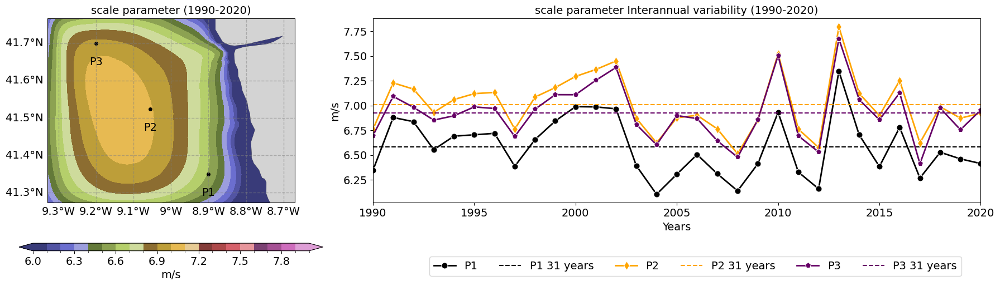

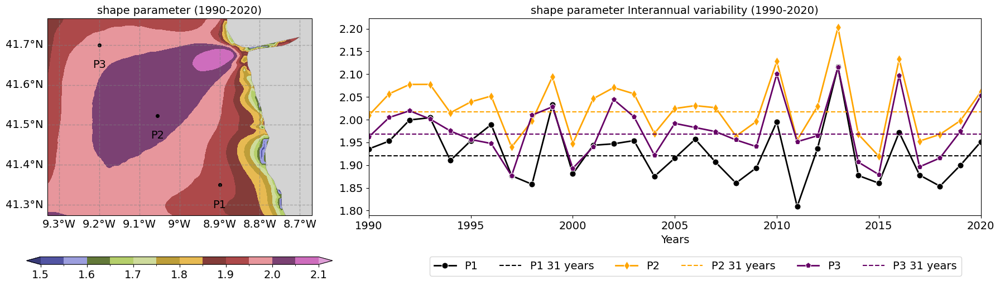

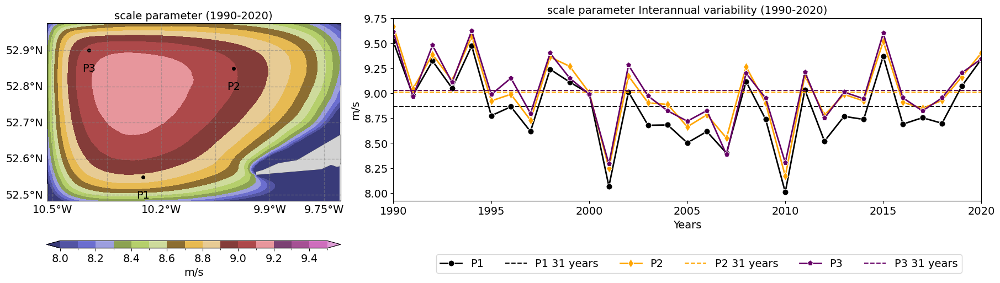

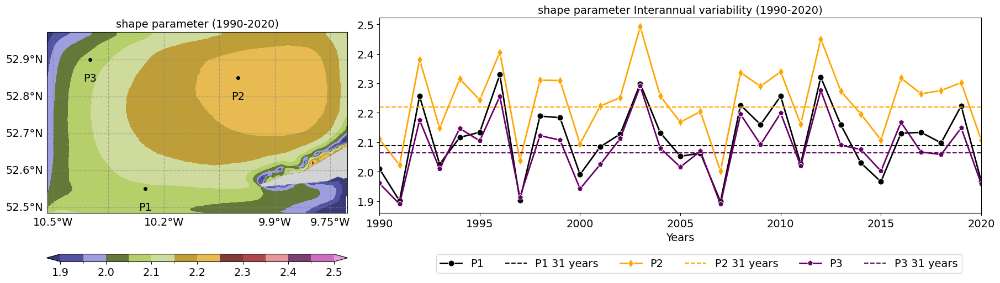

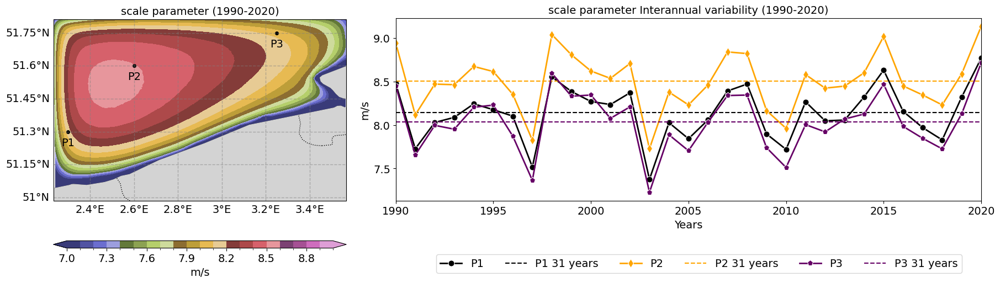

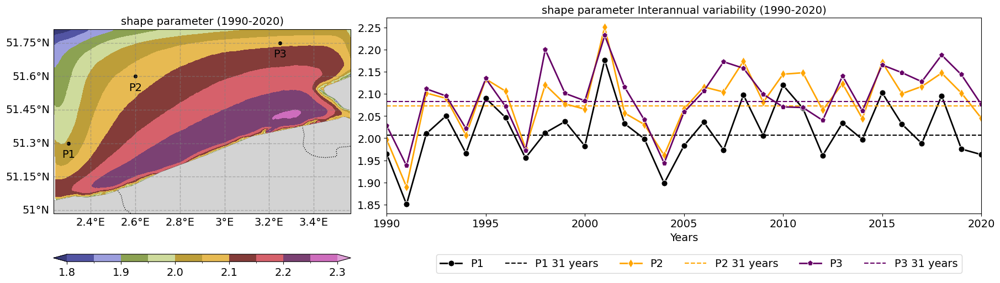

In [195]:
run = 'New_runs'
level = 10
for case in cases:
    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/ws_{level}'
    ds = xr.open_dataset(f'{target_dir}/weibull.nc')

    for j,parameter in enumerate(['scale', 'shape']):
        fig = plt.figure(figsize=(18, 5), constrained_layout=True)
        gs = fig.add_gridspec(1,3)
    
        clevels = scale_clevels[case] if parameter == 'scale' else shape_clevels[case]
        cmap = cmaps[parameter]
        cbar_args= {'shrink':1,'cbar_label':'m/s','orientation':'horizontal'} if parameter == 'scale' else {'shrink':1,'cbar_label':'','orientation':'horizontal'}
        map_plotter(fig,gs[0,0],ds.overall_values.sel(parameter=parameter)[10:-10,10:-10],'XLONG','XLAT',
                    clevels,cmap,f'{parameter} parameter (1990-2020)',cbar_args,
                    sample_points = all_sample_points[case])

        overall_df = pd.DataFrame()
        yearly_df = pd.DataFrame()
        for i,key in enumerate(all_sample_points[case].keys()):
            indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

            data = ds.overall_values.sel(parameter=parameter,south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index([0],name='Overall'))
            overall_df = pd.concat([overall_df, pointwise_df],axis=1)

            data = ds.yearly_values.sel(parameter=parameter,south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index(ds.year, name='year'))
            yearly_df = pd.concat([yearly_df, pointwise_df],axis=1)
        xlabel = 'Years'
        ylabel = 'm/s' if parameter == 'scale' else ''
        axs = variability_plotter(fig,gs[0,1:3],yearly_df,overall_df,f'{parameter} parameter Interannual variability (1990-2020)',
                            'Years',ylabel,None,None,None)

        # Extract legend from one of the subplots
        handles, labels = axs.get_legend_handles_labels()
        # Create a common legend below the figures
        fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.7, -0.00),fontsize=14)

        plt.savefig(f'{fig_dir}/{case}_{level}m_overall_mean_and_interannual_wind_weibulls.png',dpi=300,bbox_inches='tight',pad_inches=0)

### Monthly wind weibull statistics
- Plotting monthly statistics in the order of seasonal groups, such as: DJF, MAM, JJA, and SON

In [185]:
months_indices = [12,1,2,3,4,5,6,7,8,9,10,11]
months_in_seasonal_order = ['Dec','Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov']
scale_clevels = {'Portugal_coast':np.arange(5.5,8.1,0.1),
                 'Ireland_coast':np.arange(7,11.1,0.5),
                 'Netherlands_coast':np.arange(7,11.1,0.5)}
shape_clevels = {'Portugal_coast':np.arange(1.5,2.1,0.05),
                 'Ireland_coast':np.arange(1.9,2.61,0.05),
                 'Netherlands_coast':np.arange(1.9,2.61,0.05)}

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (

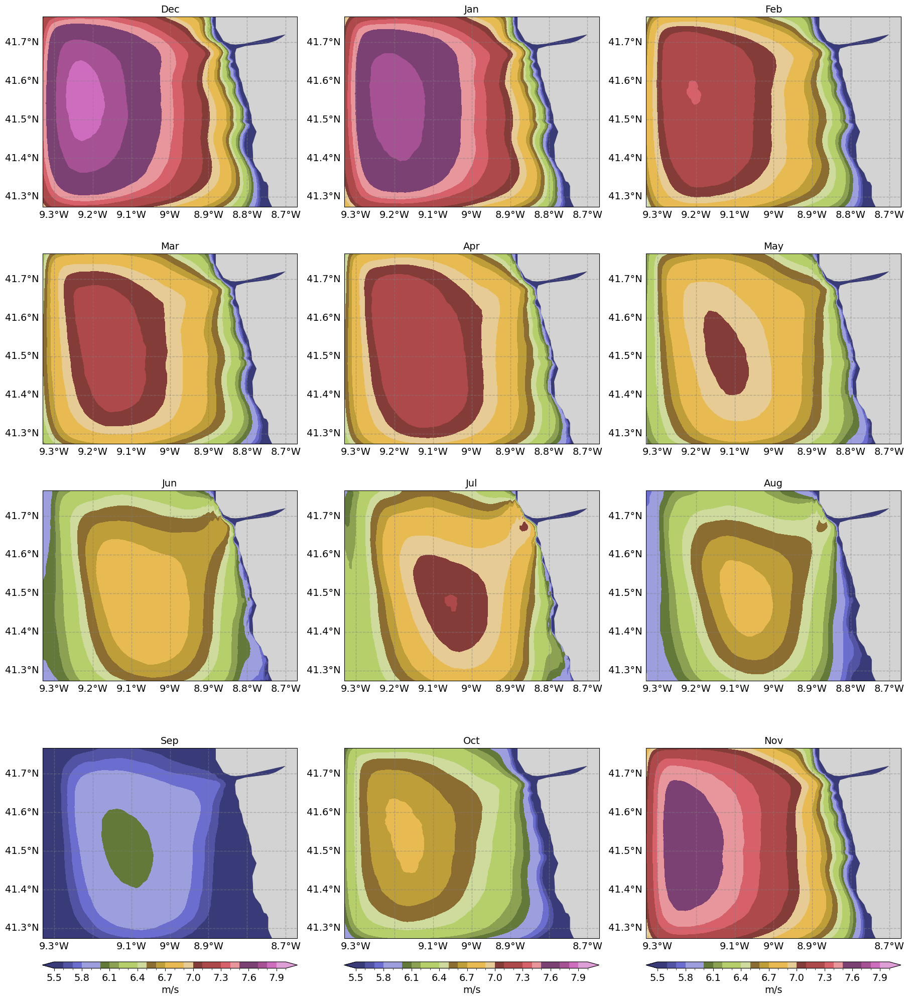

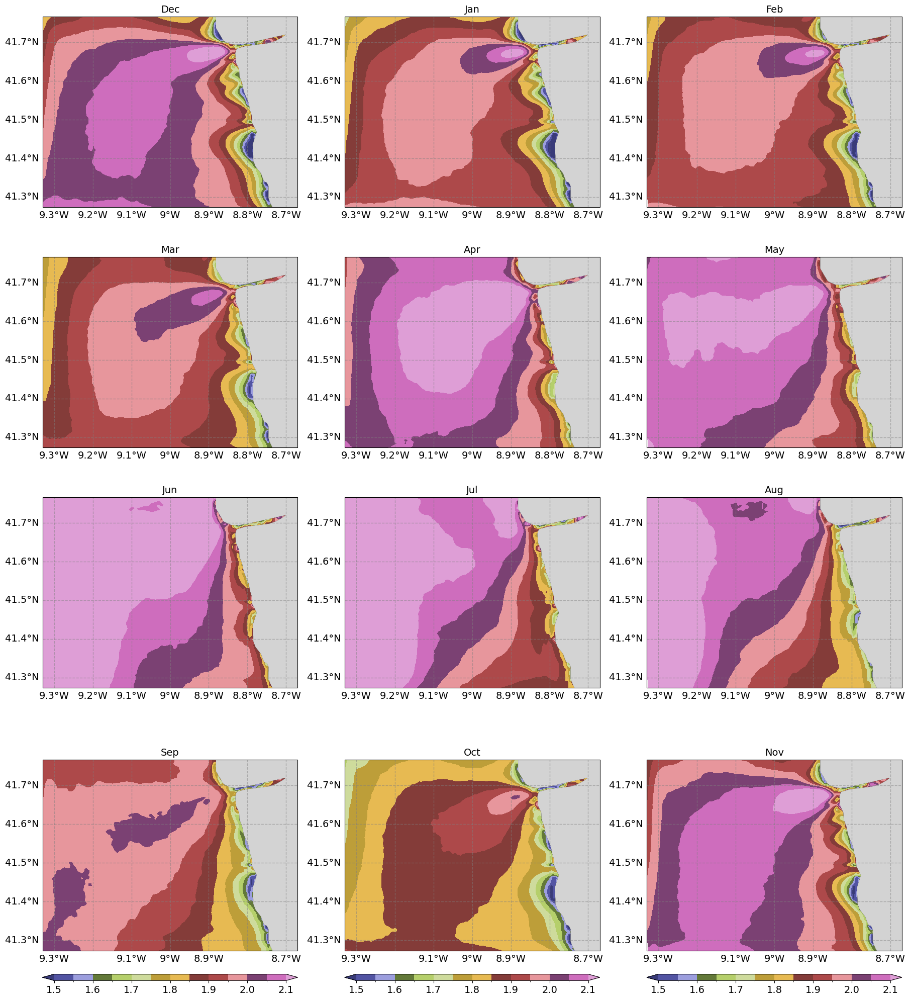

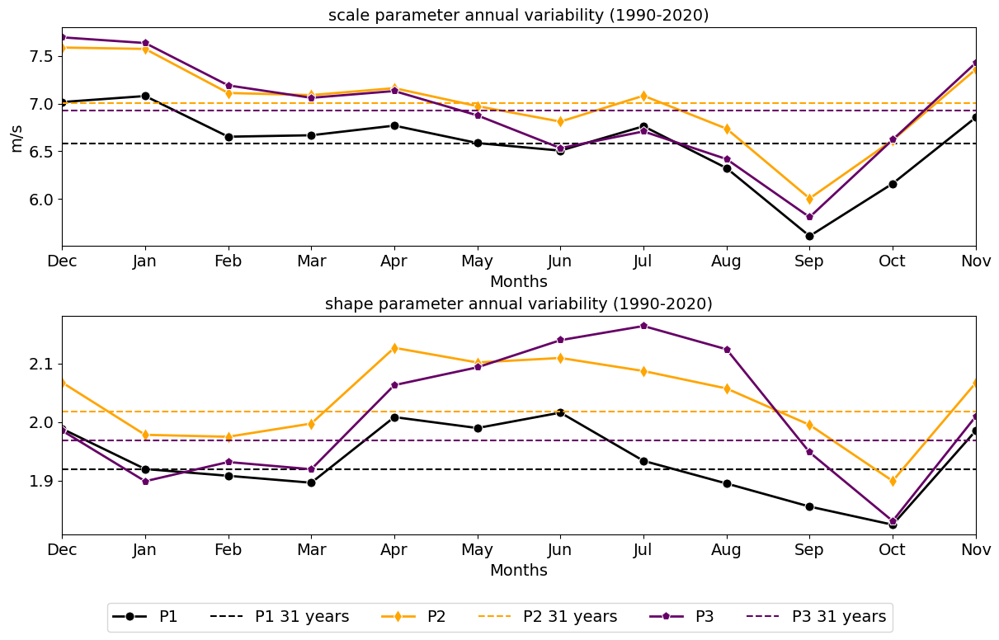

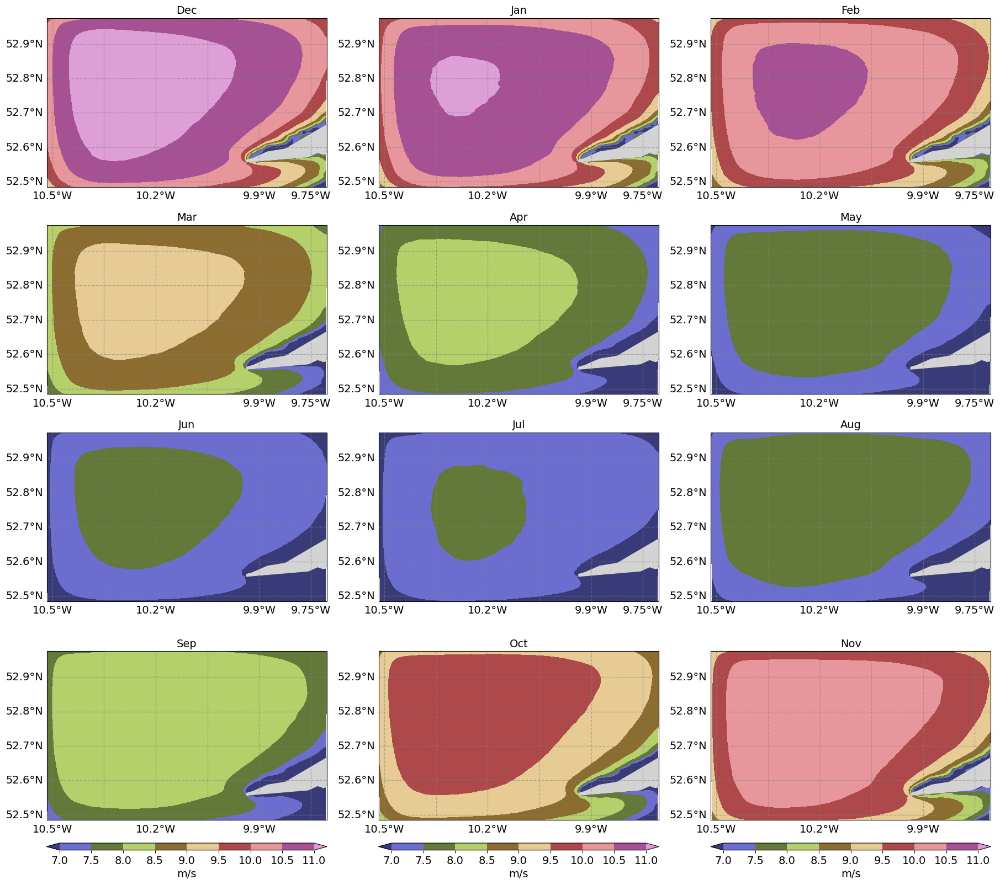

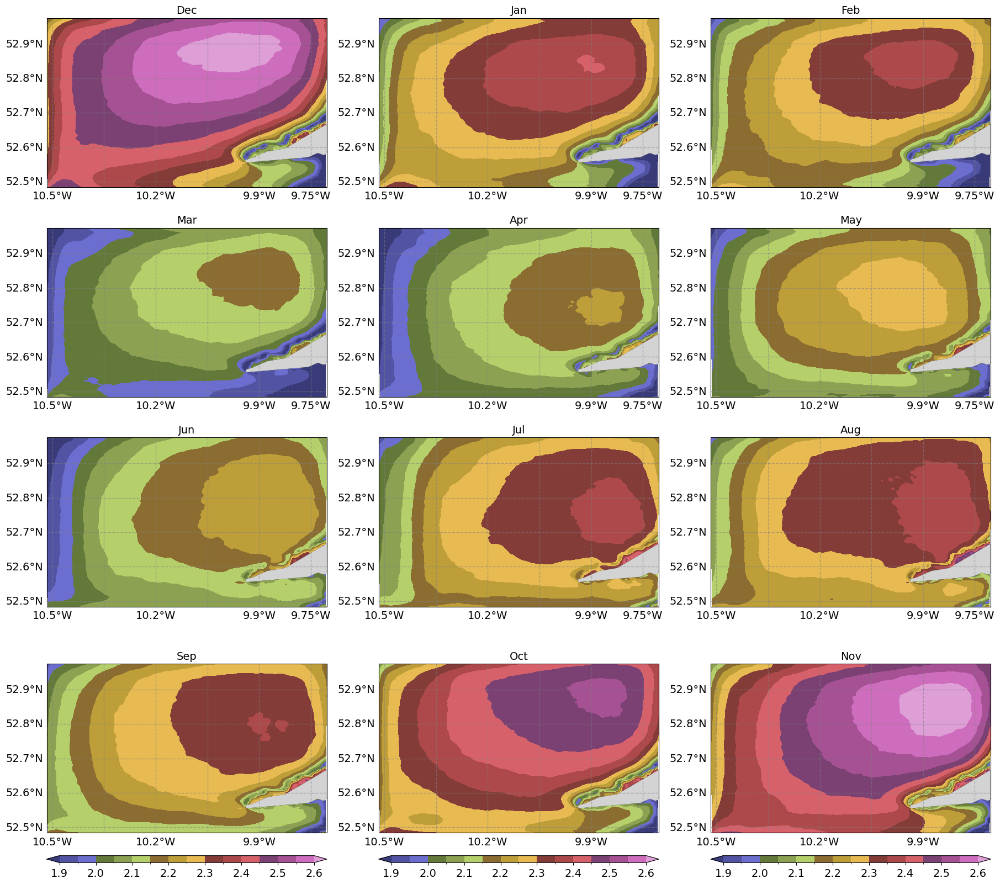

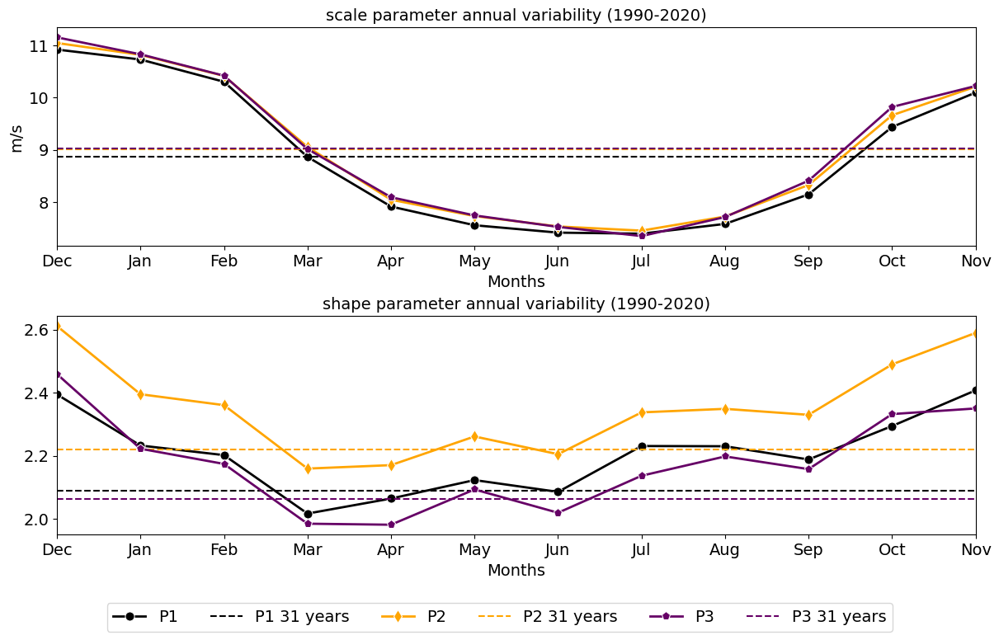

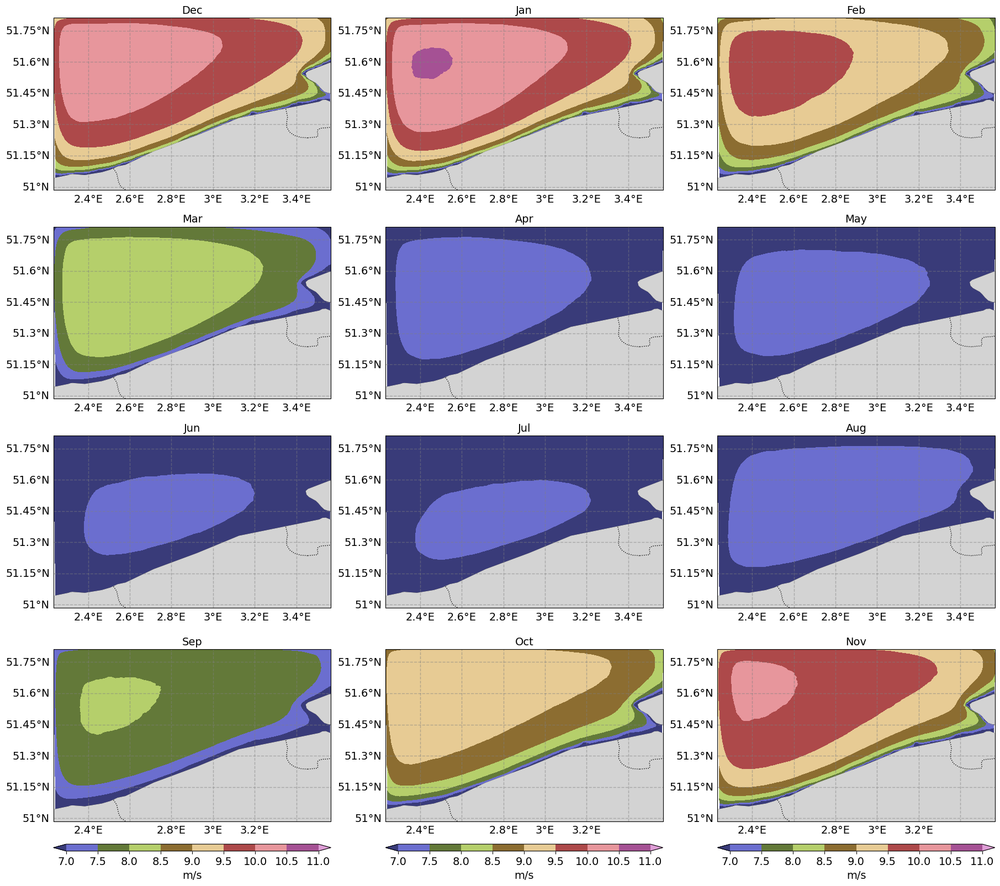

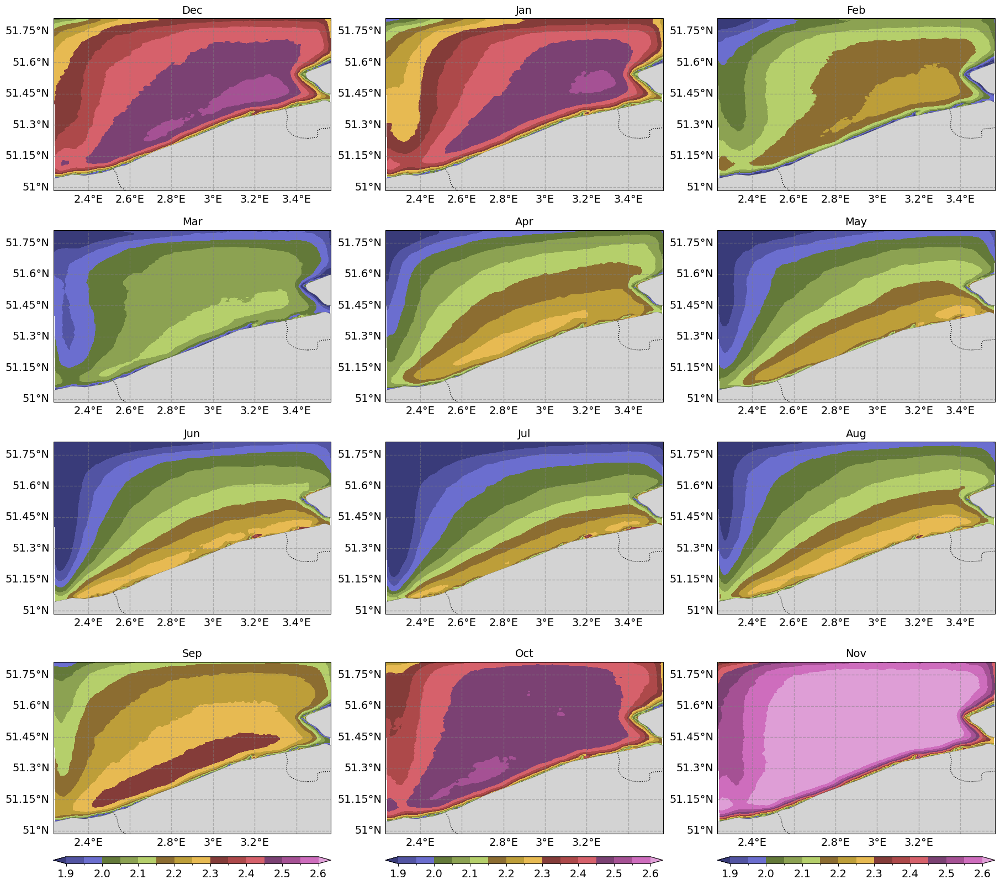

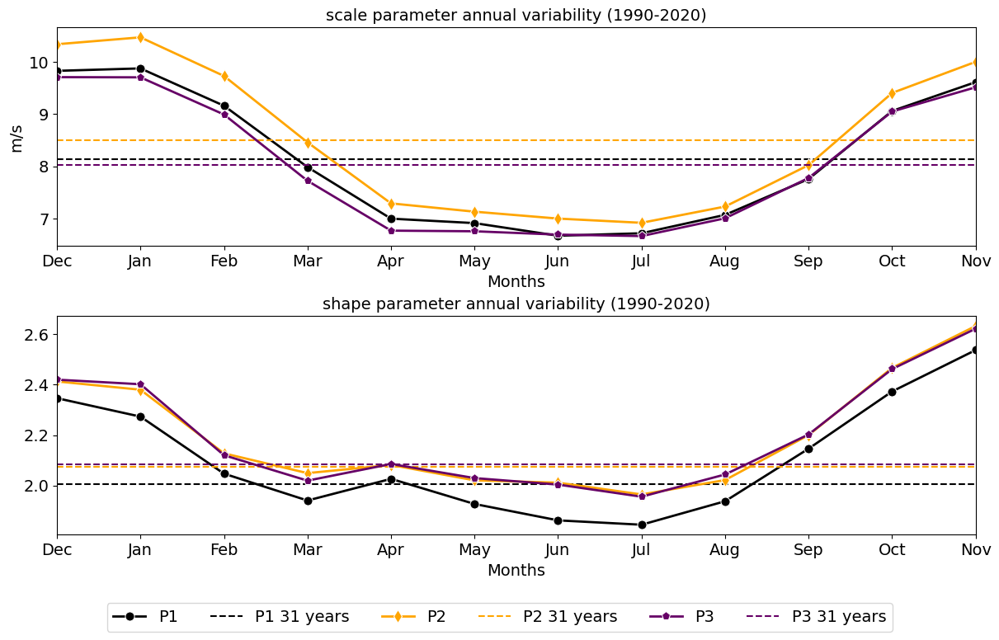

In [186]:
run = 'New_runs'
level = 10
for case in cases:
    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/ws_{level}'
    ds = xr.open_dataset(f'{target_dir}/weibull.nc')

    for j,parameter in enumerate(['scale', 'shape']):
        clevels = scale_clevels[case] if parameter == 'scale' else shape_clevels[case]
        cbar_args_={'shrink':1,'cbar_label':'m/s','orientation':'horizontal'} if parameter=='scale' else {'shrink':1,'cbar_label':'','orientation':'horizontal'}
        cmap = cmaps[parameter]
        rows, cols = 4,3
        fig = plt.figure(figsize=(6*cols, rows*fig_heights[case]), constrained_layout=True)
        gs = fig.add_gridspec(rows,cols)
        for i,month in enumerate(months_indices):
            cbar_args=cbar_args_ if i//cols == 3 else None
            axs = map_plotter(fig,gs[i//cols,i%cols],ds.monthly_values.sel(parameter=parameter,month=month)[10:-10,10:-10],'XLONG','XLAT',
                    clevels,cmap,f'{months[month-1]}',cbar_args,
                    sample_points = None)
        plt.savefig(f'{fig_dir}/{case}_{level}m_monthly_mean_wind_weibulls_{parameter}.png',dpi=300,bbox_inches='tight',pad_inches=0)

    fig = plt.figure(figsize=(12, 7), constrained_layout=True)
    gs = fig.add_gridspec(2,1)

    for j,parameter in enumerate(['scale', 'shape']):
        overall_df = pd.DataFrame()
        monthly_df = pd.DataFrame()
        for i,key in enumerate(all_sample_points[case].keys()):
            indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

            data = ds.overall_values.sel(parameter=parameter,south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index([0],name='Overall'))
            overall_df = pd.concat([overall_df, pointwise_df],axis=1)

            data = ds.monthly_values.sel(parameter=parameter,south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index(months, name='month'))
            monthly_df = pd.concat([monthly_df, pointwise_df],axis=1)
        monthly_df = monthly_df.reindex(months_in_seasonal_order)

        xlabel = 'Months' if parameter == 'scale' else ''
        xlabel_ticks = months_in_seasonal_order
        ylabel = 'm/s' if parameter == 'scale' else ''
        axs = variability_plotter(fig,gs[j,0],monthly_df,overall_df,f'{parameter} parameter annual variability (1990-2020)',
                            'Months',ylabel,None,None,None,xlabel_ticks=xlabel_ticks)
    # Extract legend from one of the subplots
    handles, labels = axs.get_legend_handles_labels()
    # Create a common legend below the figures
    fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.5, -0.1),fontsize=14)

    plt.savefig(f'{fig_dir}/{case}_{level}m_annual_wind_weibulls.png',dpi=300,bbox_inches='tight',pad_inches=0)

### Diurnal wind weibull statistics

In [189]:
scale_clevels = {'Portugal_coast':np.arange(6,7.51,0.1),
                 'Ireland_coast':np.arange(8.5,9.51,0.1),
                 'Netherlands_coast':np.arange(7.8,8.61,0.1)}
shape_clevels = {'Portugal_coast':np.arange(1.7,2.21,0.1),
                 'Ireland_coast':np.arange(1.8,2.41,0.1),
                 'Netherlands_coast':np.arange(1.8,2.21,0.1)}

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (

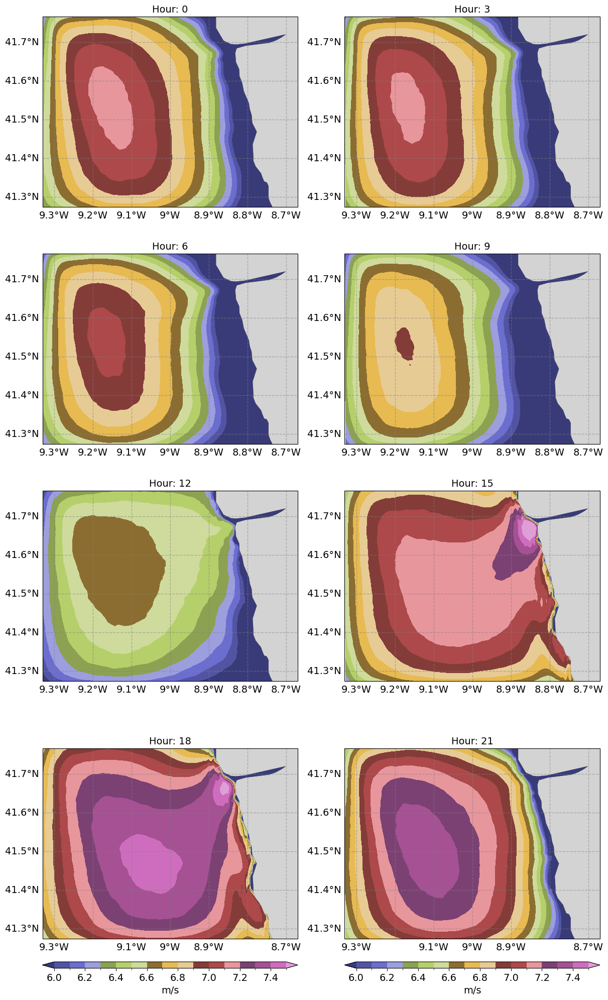

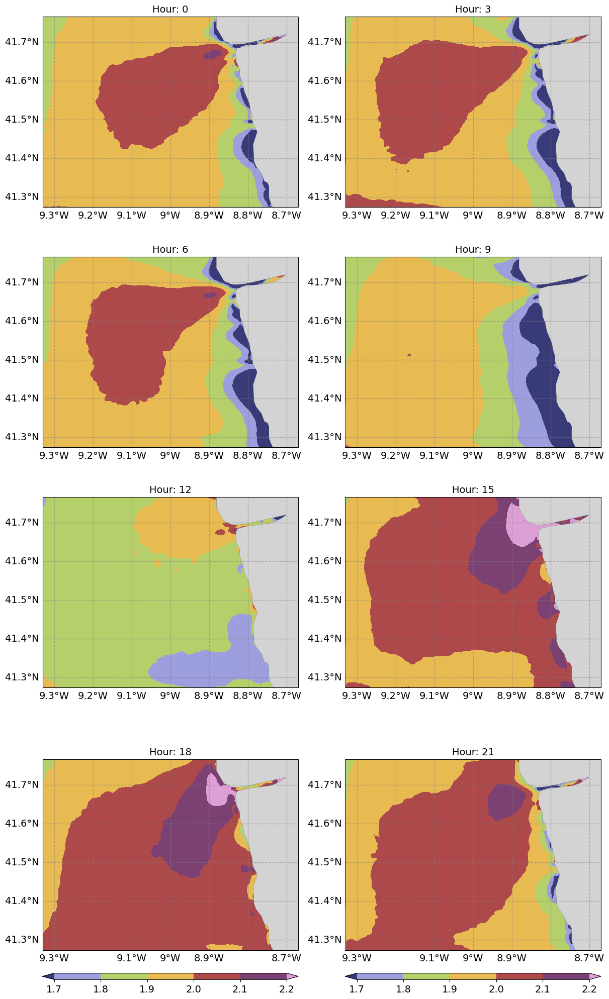

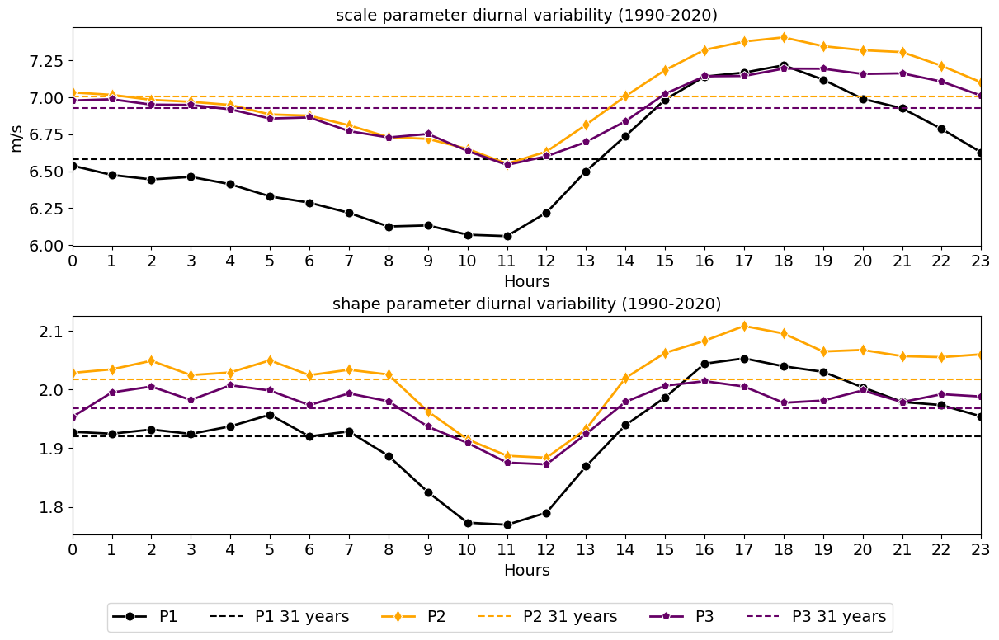

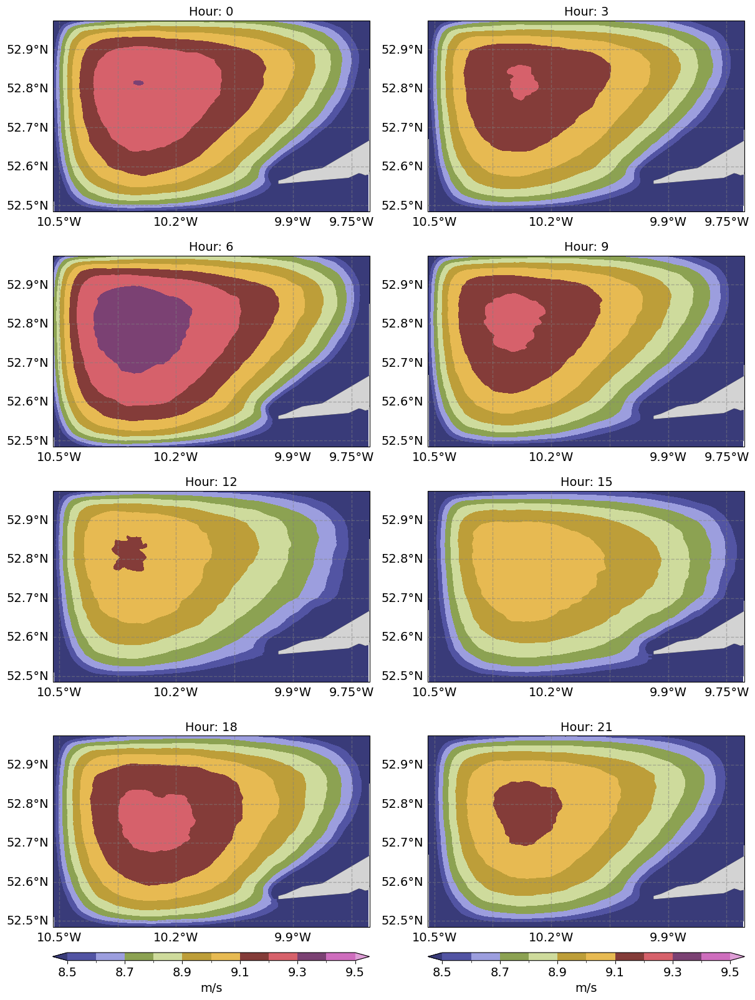

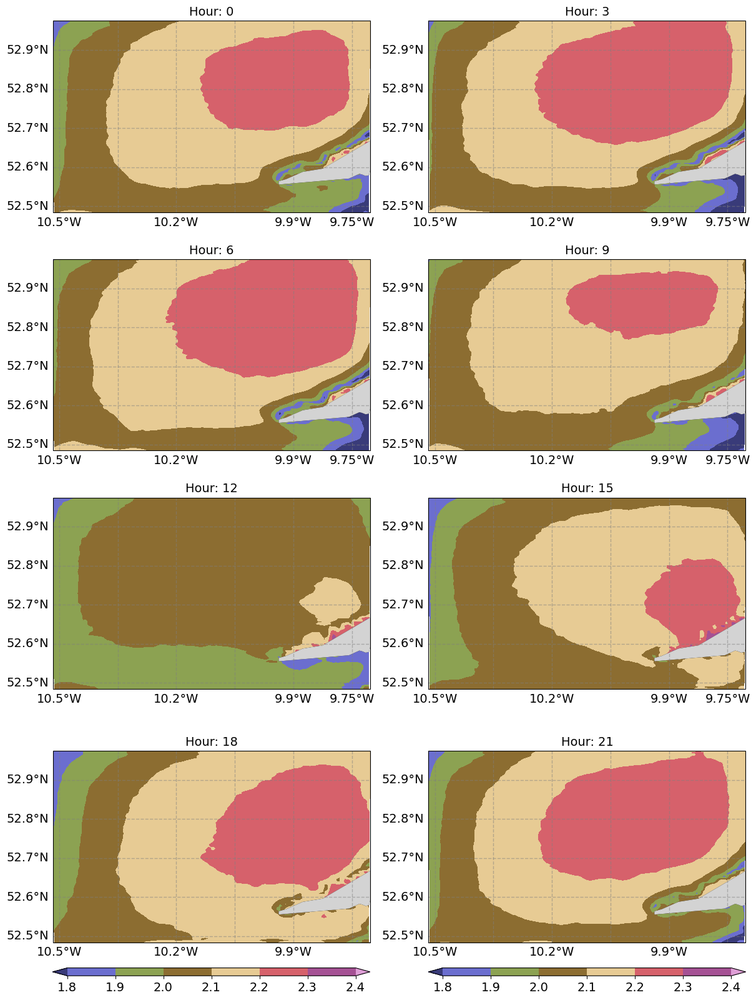

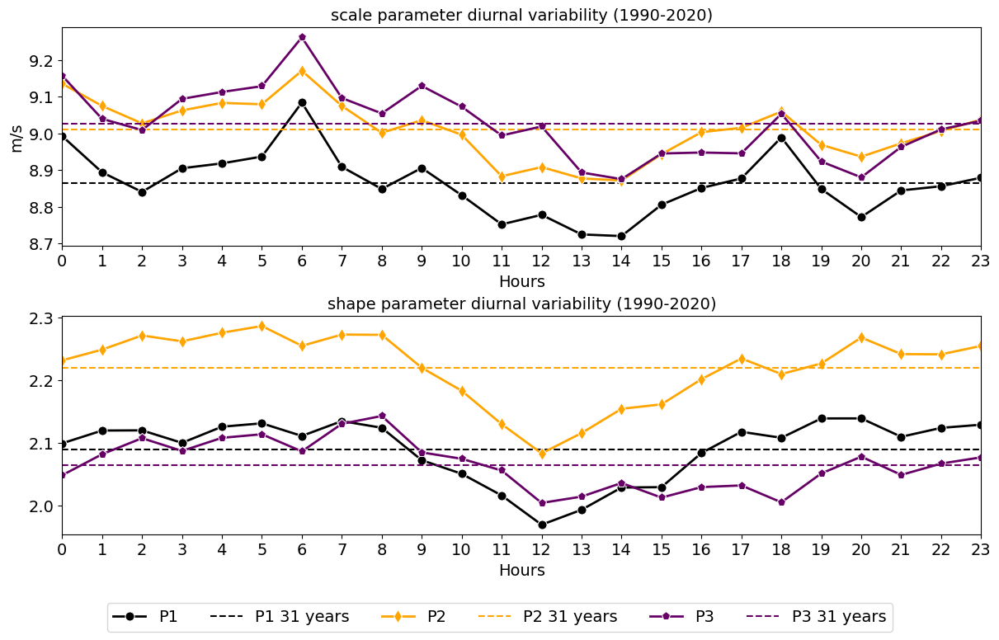

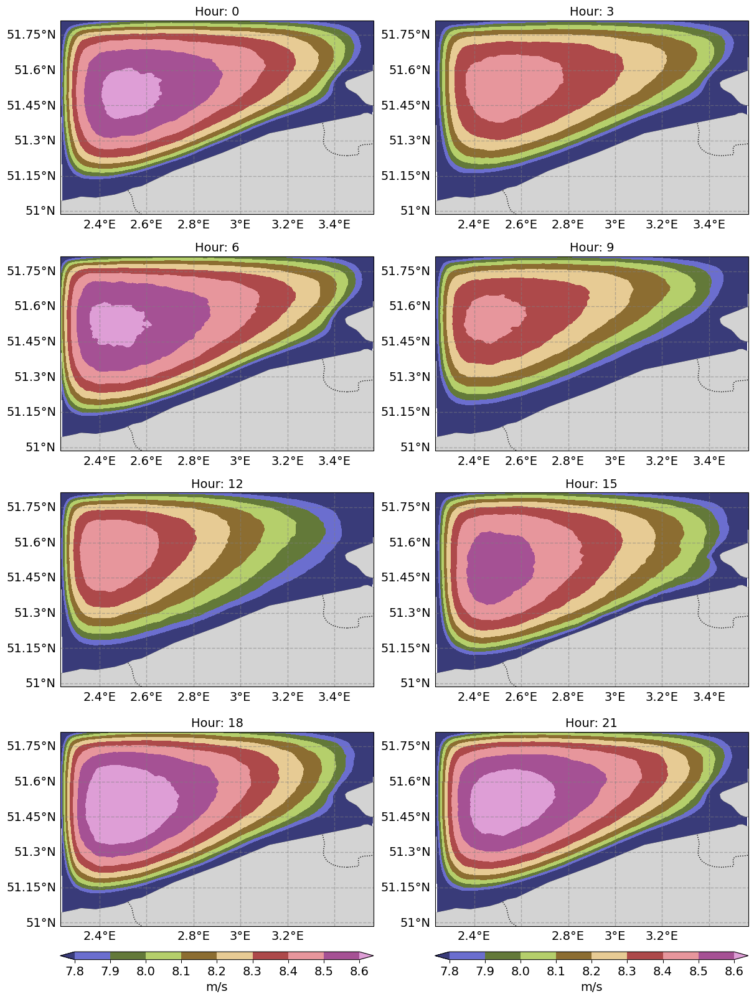

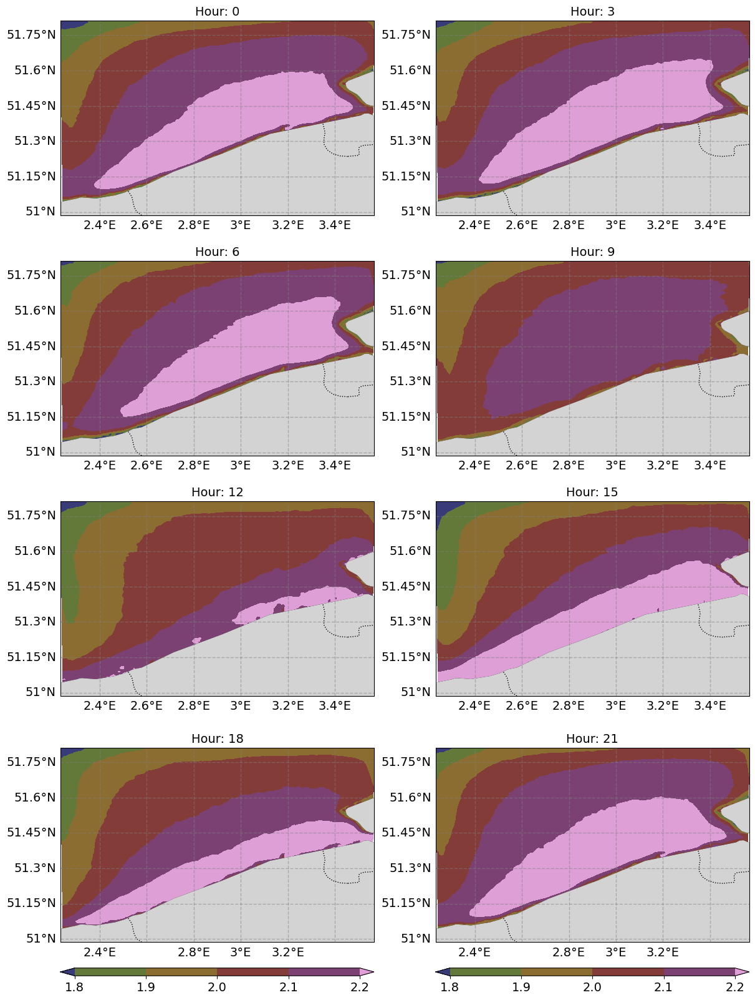

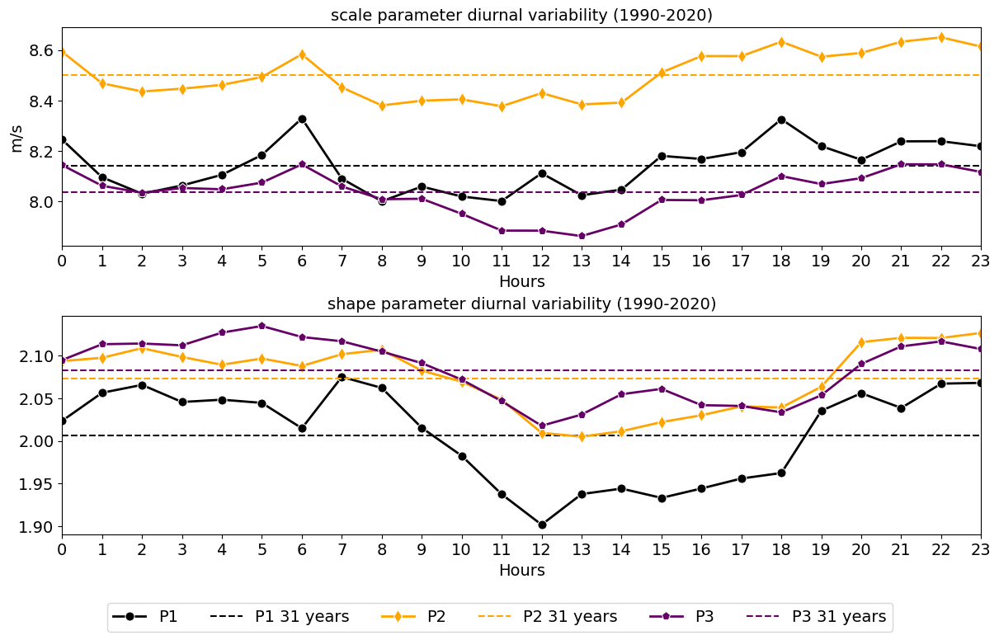

In [190]:
run = 'New_runs'
level = 10
for case in cases:
    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/ws_{level}'
    ds = xr.open_dataset(f'{target_dir}/weibull.nc')

    for j,parameter in enumerate(['scale', 'shape']):
        clevels = scale_clevels[case] if parameter == 'scale' else shape_clevels[case]
        cbar_args_={'shrink':1,'cbar_label':'m/s','orientation':'horizontal'} if parameter=='scale' else {'shrink':1,'cbar_label':'','orientation':'horizontal'}
        cmap = cmaps[parameter]
        rows, cols = 4,2
        fig = plt.figure(figsize=(6*cols, rows*fig_heights[case]), constrained_layout=True)
        gs = fig.add_gridspec(rows,cols)
        for i,hour in enumerate(ds.hour.values[::3]):
            cbar_args=cbar_args_ if i//cols == 3 else None
            axs = map_plotter(fig,gs[i//cols,i%cols],ds.hourly_values.sel(parameter=parameter,hour=hour)[10:-10,10:-10],'XLONG','XLAT',
                    clevels,cmap,f'Hour: {hour}',cbar_args,
                    sample_points = None)
        plt.savefig(f'{fig_dir}/{case}_{level}m_hourly_mean_wind_weibulls_{parameter}.png',dpi=300,bbox_inches='tight',pad_inches=0)


    fig = plt.figure(figsize=(12, 7), constrained_layout=True)
    gs = fig.add_gridspec(2,1)

    for j,parameter in enumerate(['scale', 'shape']):
        overall_df = pd.DataFrame()
        hourly_df = pd.DataFrame()
        for i,key in enumerate(all_sample_points[case].keys()):
            indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

            data = ds.overall_values.sel(parameter=parameter,south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index([0],name='Overall'))
            overall_df = pd.concat([overall_df, pointwise_df],axis=1)

            data = ds.hourly_values.sel(parameter=parameter,south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index(ds.hour, name='hour'))
            hourly_df = pd.concat([hourly_df, pointwise_df],axis=1)

        xlabel = 'Hours' if parameter == 'scale' else ''
        xlabel_ticks = ds.hour.values
        ylabel = 'm/s' if parameter == 'scale' else ''
        axs = variability_plotter(fig,gs[j,0],hourly_df,overall_df,f'{parameter} parameter diurnal variability (1990-2020)',
                            'Hours',ylabel,None,None,None,xlabel_ticks=xlabel_ticks)
    # Extract legend from one of the subplots
    handles, labels = axs.get_legend_handles_labels()
    # Create a common legend below the figures
    fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.5, -0.1),fontsize=14)

    plt.savefig(f'{fig_dir}/{case}_{level}m_diurnal_wind_weibulls.png',dpi=300,bbox_inches='tight',pad_inches=0)

## 2m temperature

### Overall mean statistics

In [4]:
cases = ['Portugal_coast','Ireland_coast','Netherlands_coast']
fig_widths = {'Portugal_coast': 6,
              'Ireland_coast': 6,
              'Netherlands_coast': 6}
fig_heights = {'Portugal_coast': 5,
              'Ireland_coast': 4,
              'Netherlands_coast': 4}
mean_clevels = {'Portugal_coast':np.arange(14.5,16.1,0.1),
                 'Ireland_coast':np.arange(10.8,12.21,0.1),
                 'Netherlands_coast':np.arange(9.5,12.51,0.1)}
cov_clevels = {'Portugal_coast':np.arange(0.1,0.21,0.01),
                 'Ireland_coast':np.arange(0.22,0.41,0.01),
                 'Netherlands_coast':np.arange(0.3,0.61,0.01)}
cmaps = {'mean':'tab20b',
         'cov':'tab20b'}

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (

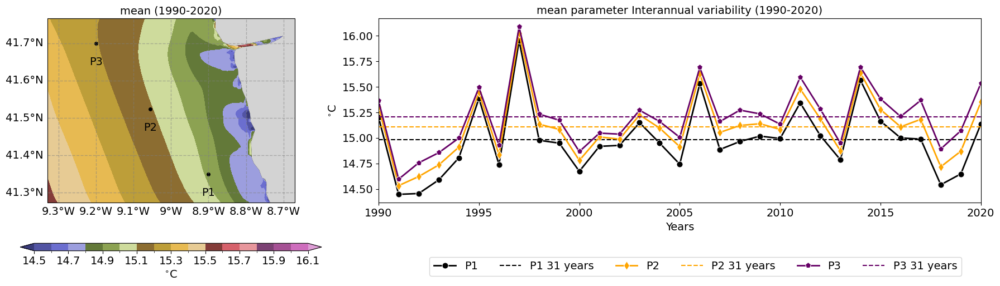

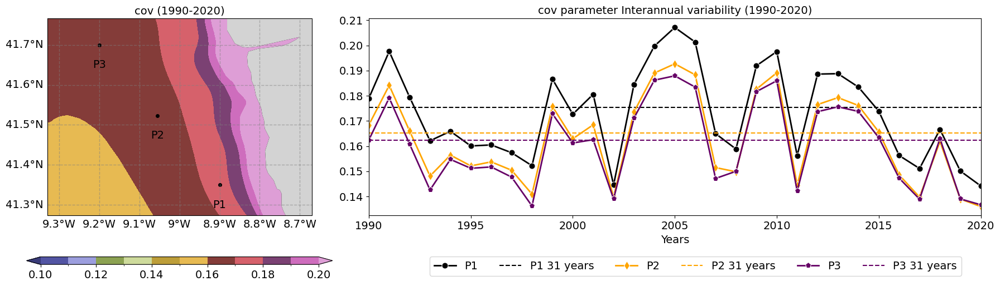

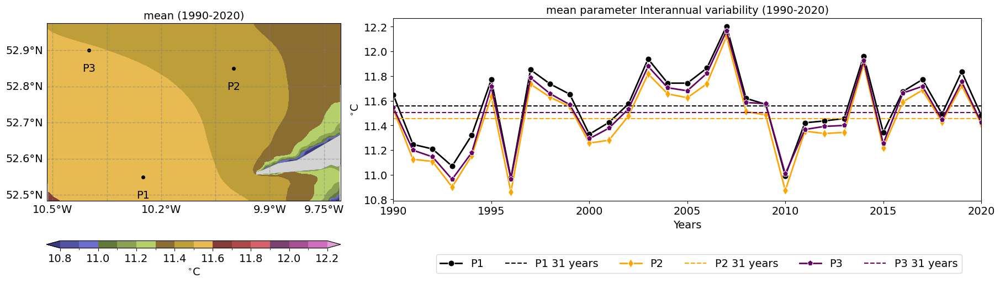

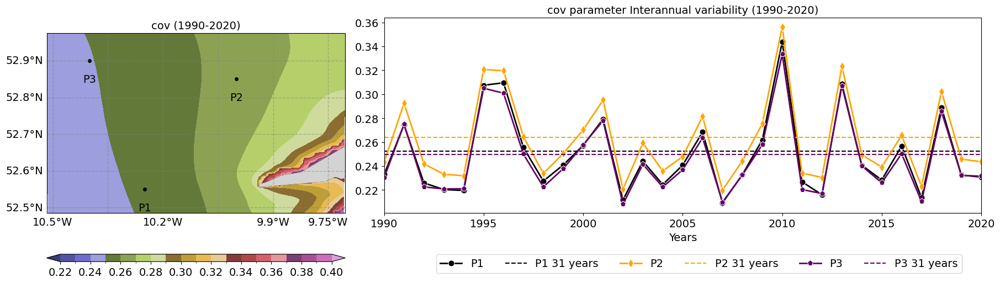

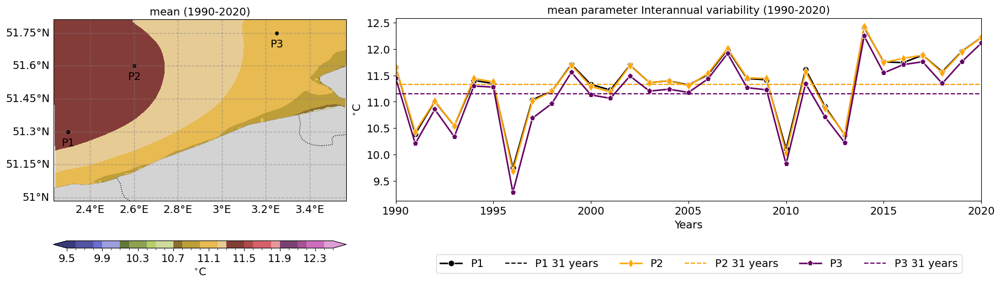

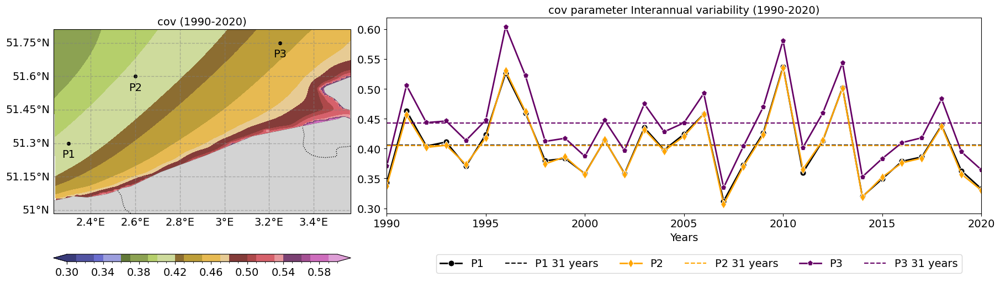

In [9]:
run = 'New_runs'
var = 'T2'
for case in cases:
    # A small problem in the data is that the XLAT and XLONG are missing from T2 and SWDOWN2 source files.
    # Which continued into the statistics as well
    XLAND = xr.open_dataset(f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/variablewise_files/XLAND.nc')
    XLAT = XLAND.XLAT
    XLONG = XLAND.XLONG

    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/{var}'

    for j,parameter in enumerate(['mean', 'cov']):
        ds = xr.open_dataset(f'{target_dir}/{parameter}.nc')
        ds = ds.assign_coords(XLAT=XLAT, XLONG=XLONG)

        fig = plt.figure(figsize=(18, 5), constrained_layout=True)
        gs = fig.add_gridspec(1,3)
    
        clevels = mean_clevels[case] if parameter == 'mean' else cov_clevels[case]
        cmap = cmaps[parameter]
        cbar_args= {'shrink':1,'cbar_label':r'$^{\circ}$C','orientation':'horizontal'} if parameter == 'mean' else {'shrink':1,'cbar_label':'','orientation':'horizontal'}
        map_plotter(fig,gs[0,0],ds.overall_values[10:-10,10:-10],'XLONG','XLAT',
                    clevels,cmap,f'{parameter} (1990-2020)',cbar_args,
                    sample_points = all_sample_points[case])

        overall_df = pd.DataFrame()
        yearly_df = pd.DataFrame()
        for i,key in enumerate(all_sample_points[case].keys()):
            indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

            data = ds.overall_values.sel(south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index([0],name='Overall'))
            overall_df = pd.concat([overall_df, pointwise_df],axis=1)

            data = ds.yearly_values.sel(south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index(ds.year, name='year'))
            yearly_df = pd.concat([yearly_df, pointwise_df],axis=1)
        xlabel = 'Years'
        ylabel = r'$^{\circ}$C' if parameter == 'mean' else ''
        axs = variability_plotter(fig,gs[0,1:3],yearly_df,overall_df,f'{parameter} parameter Interannual variability (1990-2020)',
                            'Years',ylabel,None,None,None)

        # Extract legend from one of the subplots
        handles, labels = axs.get_legend_handles_labels()
        # Create a common legend below the figures
        fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.7, -0.00),fontsize=14)

        plt.savefig(f'{fig_dir}/{case}_overall_{parameter}_and_interannual_{parameter}_T2.png',dpi=300,bbox_inches='tight',pad_inches=0)

### Monthly mean statistics

In [17]:
months_indices = [12,1,2,3,4,5,6,7,8,9,10,11]
months_in_seasonal_order = ['Dec','Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov']
mean_clevels = {'Portugal_coast':np.arange(12,18.1,0.1),
                 'Ireland_coast':np.arange(8,15.1,0.1),
                 'Netherlands_coast':np.arange(5,18.1,0.1)}
cov_clevels = {'Portugal_coast':np.arange(0.06,0.161,0.01),
                 'Ireland_coast':np.arange(0.05,0.251,0.01),
                 'Netherlands_coast':np.arange(0.1,0.51,0.01)}
cmaps = {'mean':'tab20b',
         'cov':'tab20b'}

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (

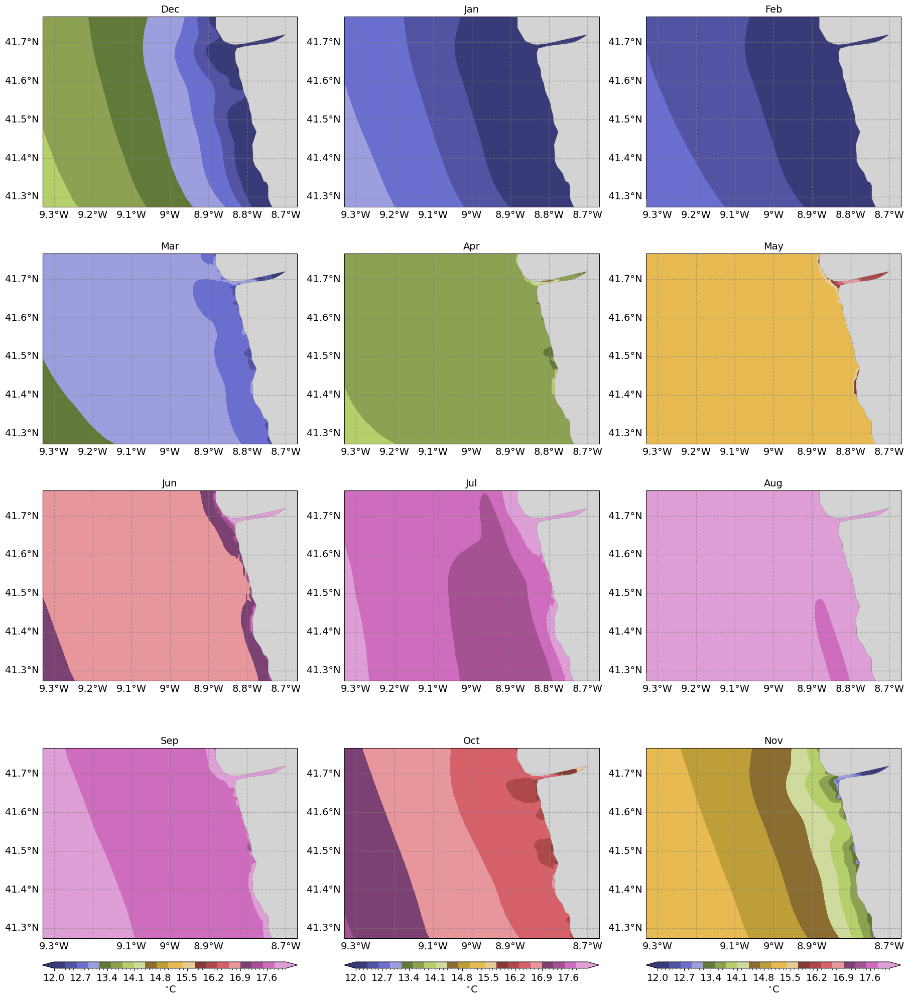

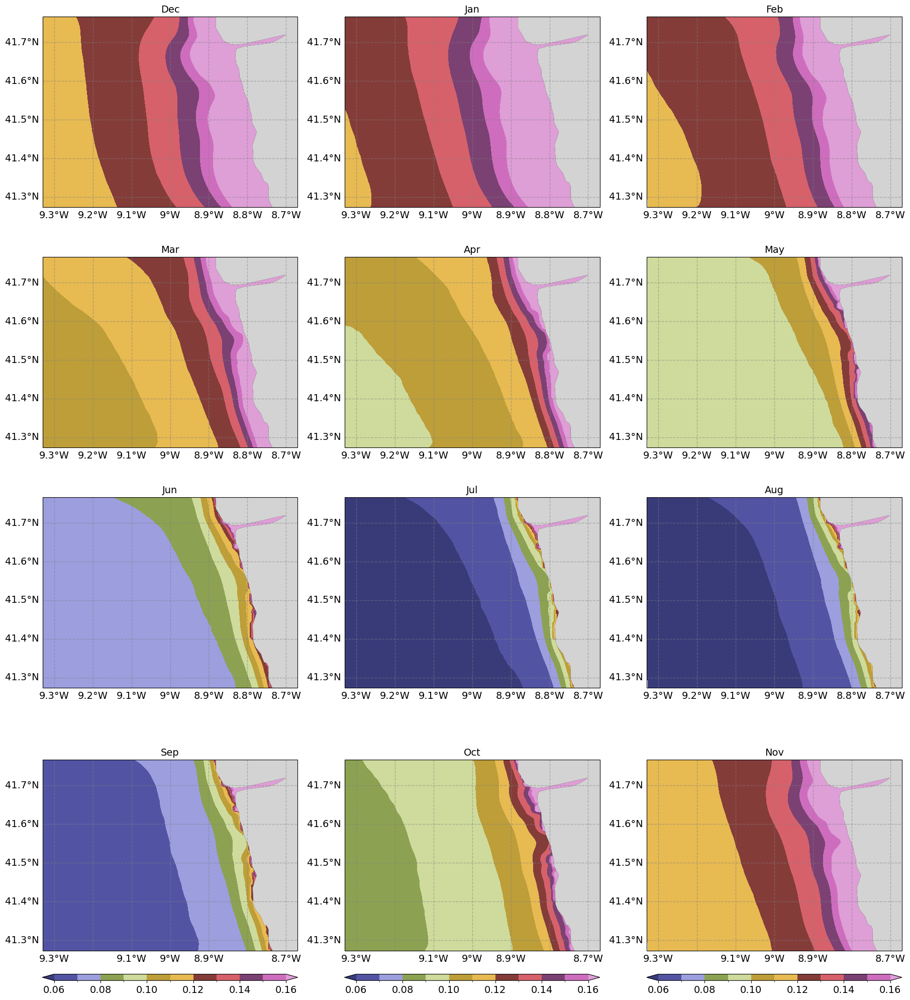

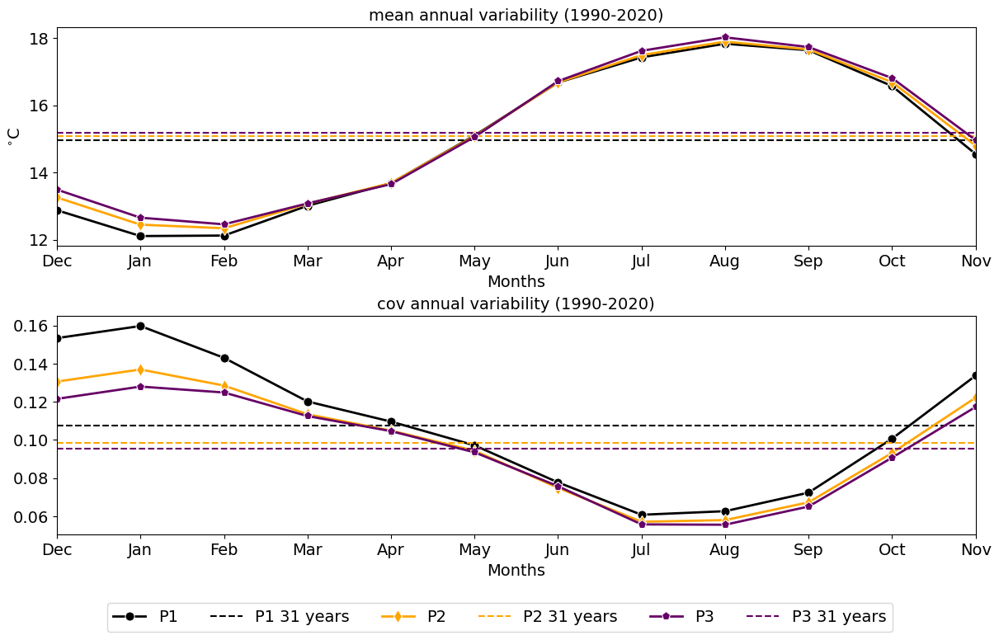

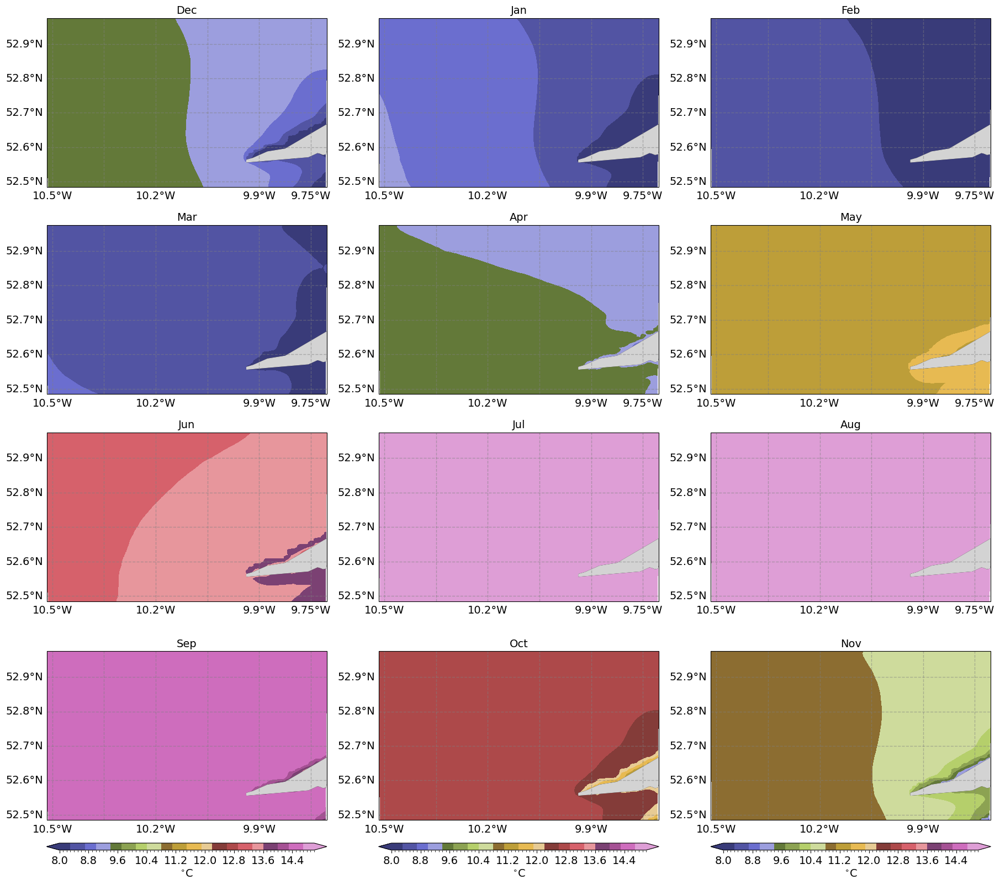

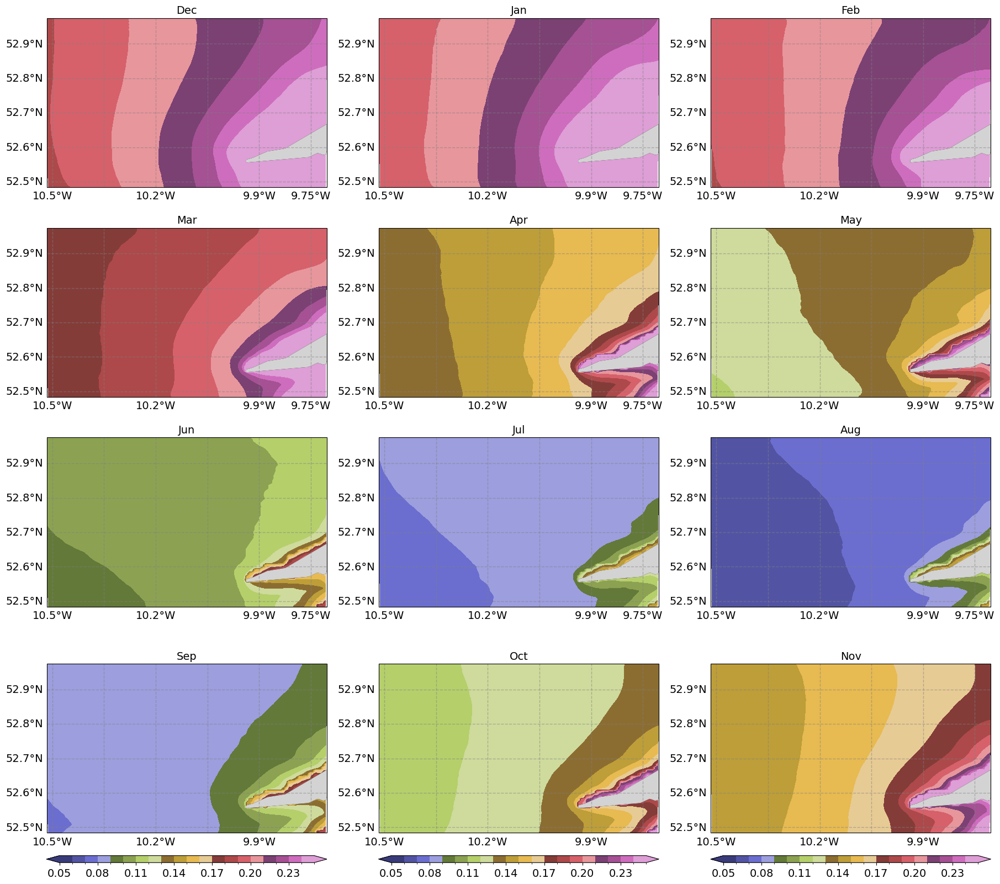

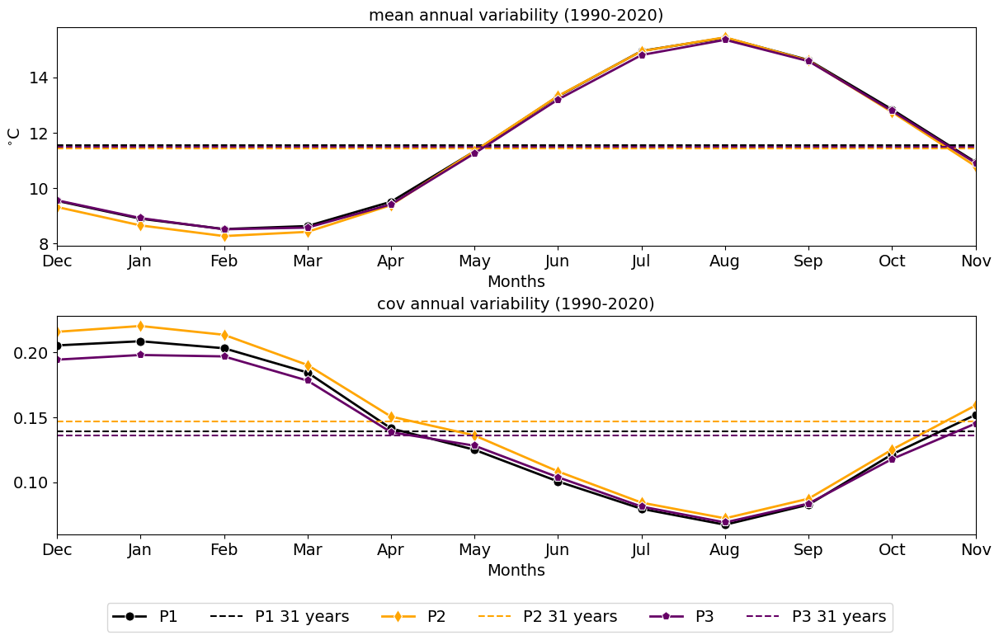

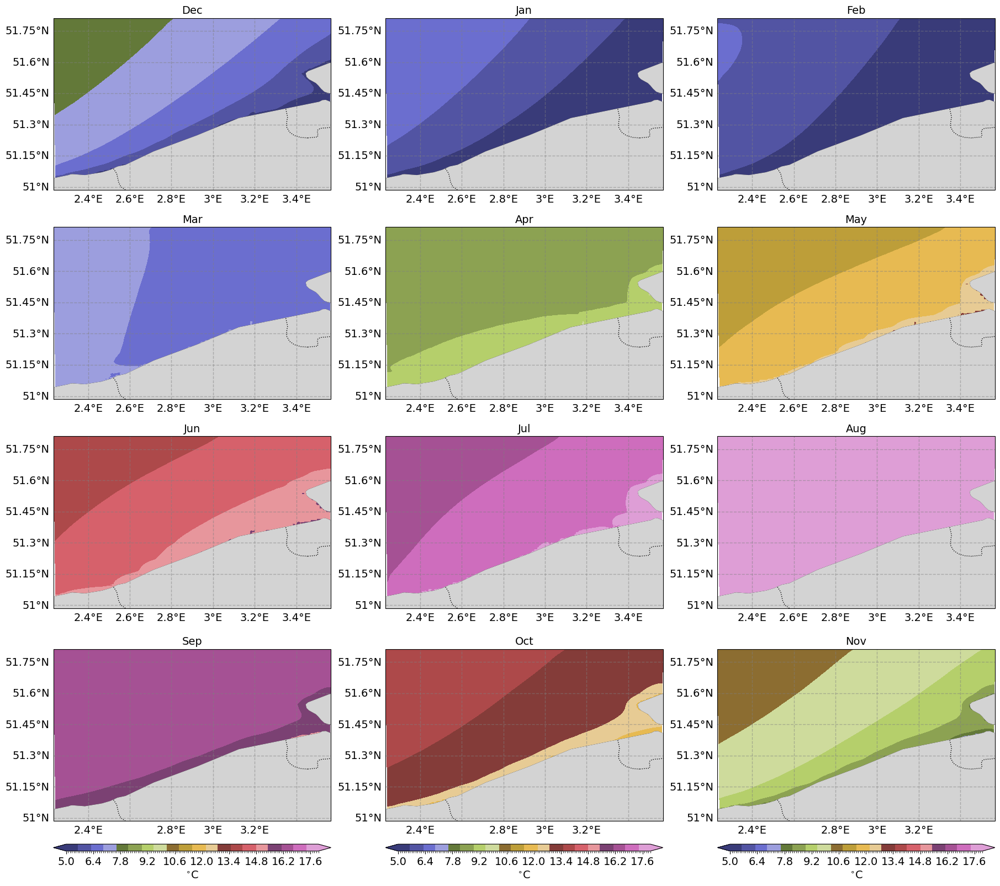

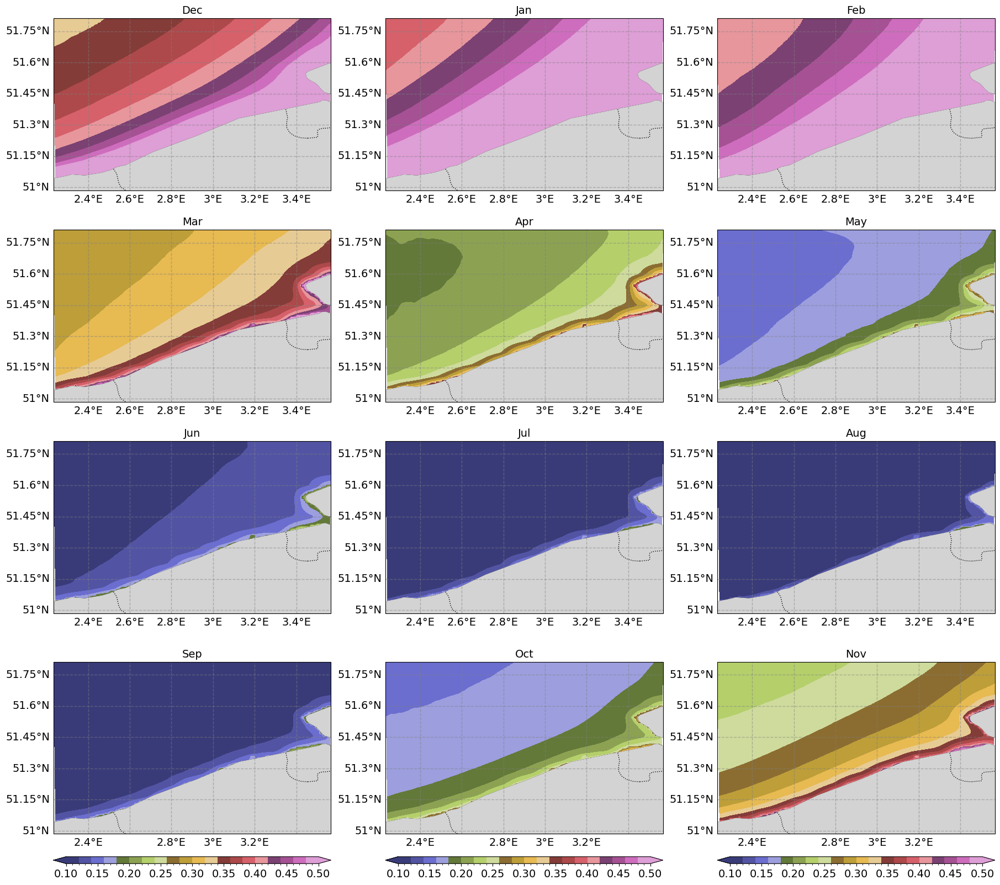

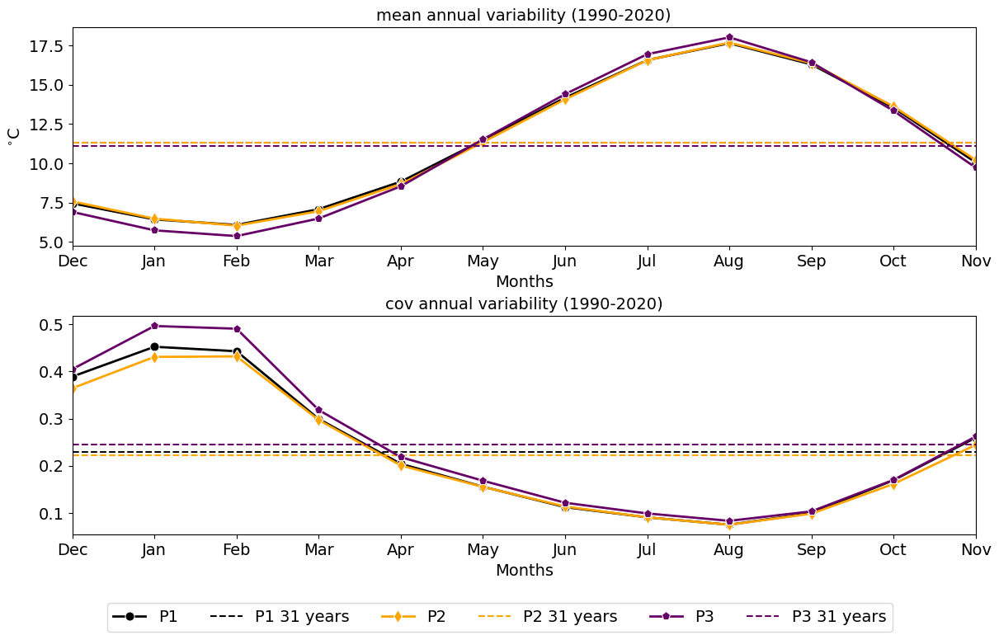

In [18]:
run = 'New_runs'
var = 'T2'
for case in cases:
    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/{var}'

    XLAND = xr.open_dataset(f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/variablewise_files/XLAND.nc')
    XLAT = XLAND.XLAT
    XLONG = XLAND.XLONG

    for j,parameter in enumerate(['mean', 'cov']):
        ds = xr.open_dataset(f'{target_dir}/{parameter}.nc')
        ds = ds.assign_coords(XLAT=XLAT, XLONG=XLONG)
        clevels = mean_clevels[case] if parameter == 'mean' else cov_clevels[case]
        cmap = cmaps[parameter]
        cbar_args_ = {'shrink':1,'cbar_label':r'$^{\circ}$C','orientation':'horizontal'} if parameter == 'mean' else {'shrink':1,'cbar_label':'','orientation':'horizontal'}
        rows, cols = 4,3
        fig = plt.figure(figsize=(6*cols, rows*fig_heights[case]), constrained_layout=True)
        gs = fig.add_gridspec(rows,cols)
        for i,month in enumerate(months_indices):
            cbar_args=cbar_args_ if i//cols == 3 else None
            axs = map_plotter(fig,gs[i//cols,i%cols],ds.monthly_values.sel(month=month)[10:-10,10:-10],'XLONG','XLAT',
                    clevels,cmap,f'{months[month-1]}',cbar_args,
                    sample_points = None)
        plt.savefig(f'{fig_dir}/{case}_monthly_{parameter}_{var}.png',dpi=300,bbox_inches='tight',pad_inches=0)

    fig = plt.figure(figsize=(12, 7), constrained_layout=True)
    gs = fig.add_gridspec(2,1)

    for j,parameter in enumerate(['mean', 'cov']):
        ds = xr.open_dataset(f'{target_dir}/{parameter}.nc')
        ds = ds.assign_coords(XLAT=XLAT, XLONG=XLONG)
        overall_df = pd.DataFrame()
        monthly_df = pd.DataFrame()
        for i,key in enumerate(all_sample_points[case].keys()):
            indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

            data = ds.overall_values.sel(south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index([0],name='Overall'))
            overall_df = pd.concat([overall_df, pointwise_df],axis=1)

            data = ds.monthly_values.sel(south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index(months, name='month'))
            monthly_df = pd.concat([monthly_df, pointwise_df],axis=1)
        monthly_df = monthly_df.reindex(months_in_seasonal_order)

        xlabel = 'Months' if parameter == 'mean' else ''
        xlabel_ticks = months_in_seasonal_order
        ylabel = r'$^{\circ}$C' if parameter == 'mean' else ''
        axs = variability_plotter(fig,gs[j,0],monthly_df,None,f'{parameter} annual variability (1990-2020)',
                            'Months',ylabel,None,None,None,xlabel_ticks=xlabel_ticks)
    # Extract legend from one of the subplots
    handles, labels = axs.get_legend_handles_labels()
    # Create a common legend below the figures
    fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.5, -0.1),fontsize=14)

    plt.savefig(f'{fig_dir}/{case}_{var}_annual_mean_and_cov_variability.png',dpi=300,bbox_inches='tight',pad_inches=0)

### Diurnal mean statistics

In [22]:
months_indices = [12,1,2,3,4,5,6,7,8,9,10,11]
months_in_seasonal_order = ['Dec','Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov']
mean_clevels = {'Portugal_coast':np.arange(14.4,15.61,0.1),
                 'Ireland_coast':np.arange(11.2,11.81,0.1),
                 'Netherlands_coast':np.arange(10.8,11.61,0.1)}
cov_clevels = {'Portugal_coast':np.arange(0.15,0.21,0.01),
                 'Ireland_coast':np.arange(0.245,0.271,0.01),
                 'Netherlands_coast':np.arange(0.39,0.451,0.01)}
cmaps = {'mean':'tab20b',
         'cov':'tab20b'}

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (

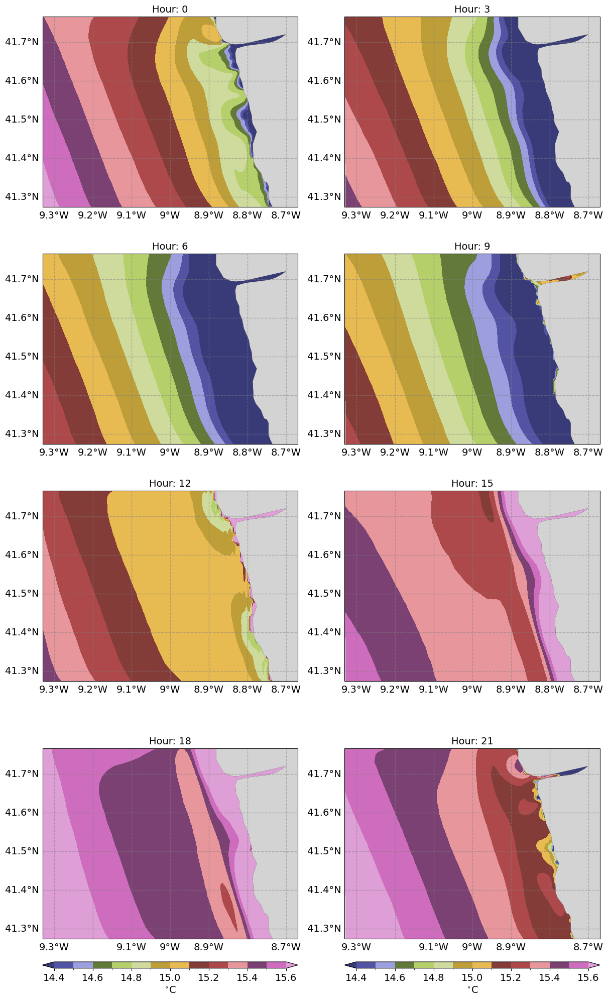

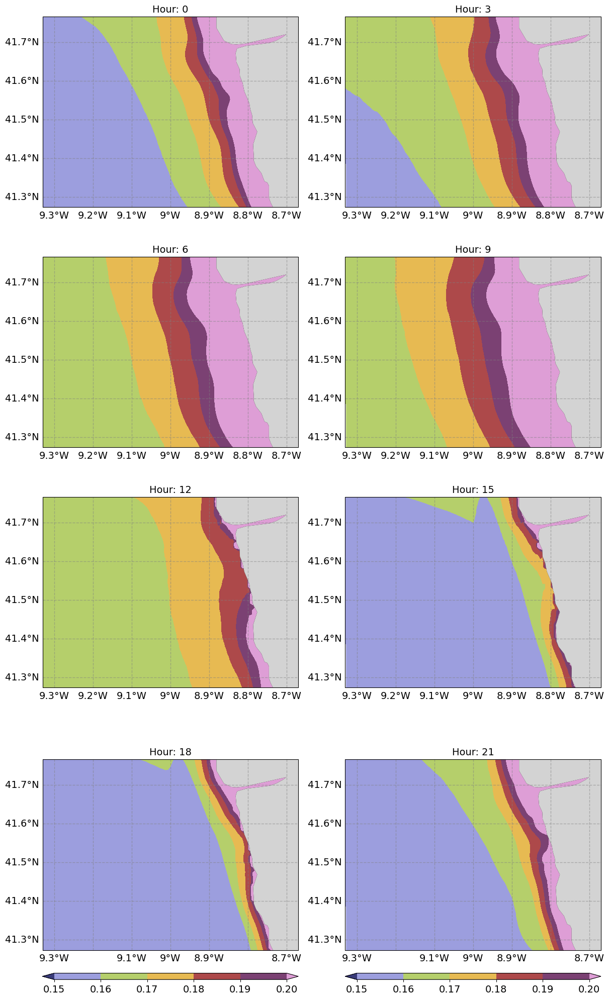

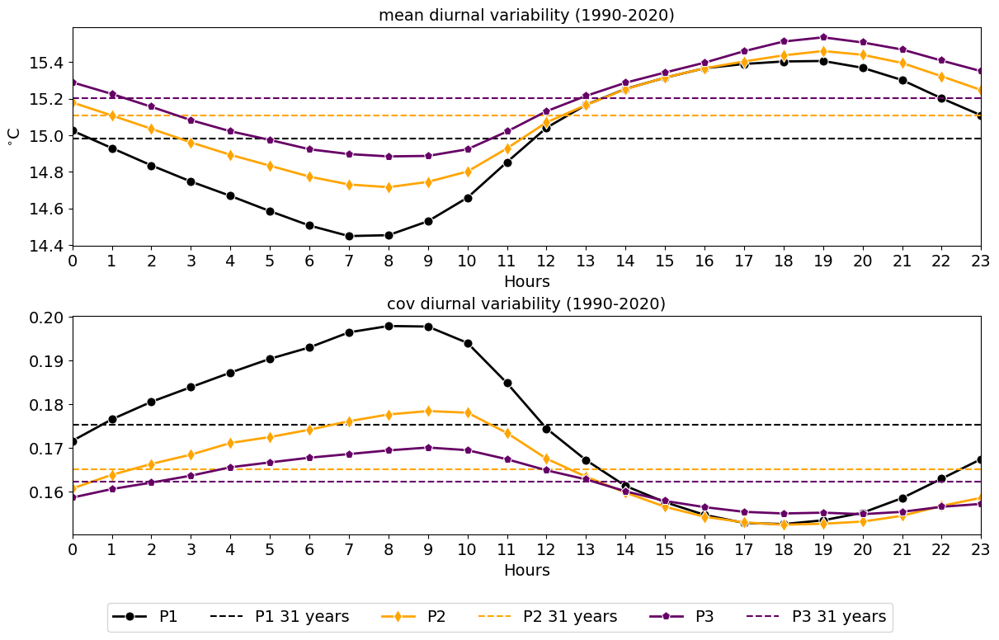

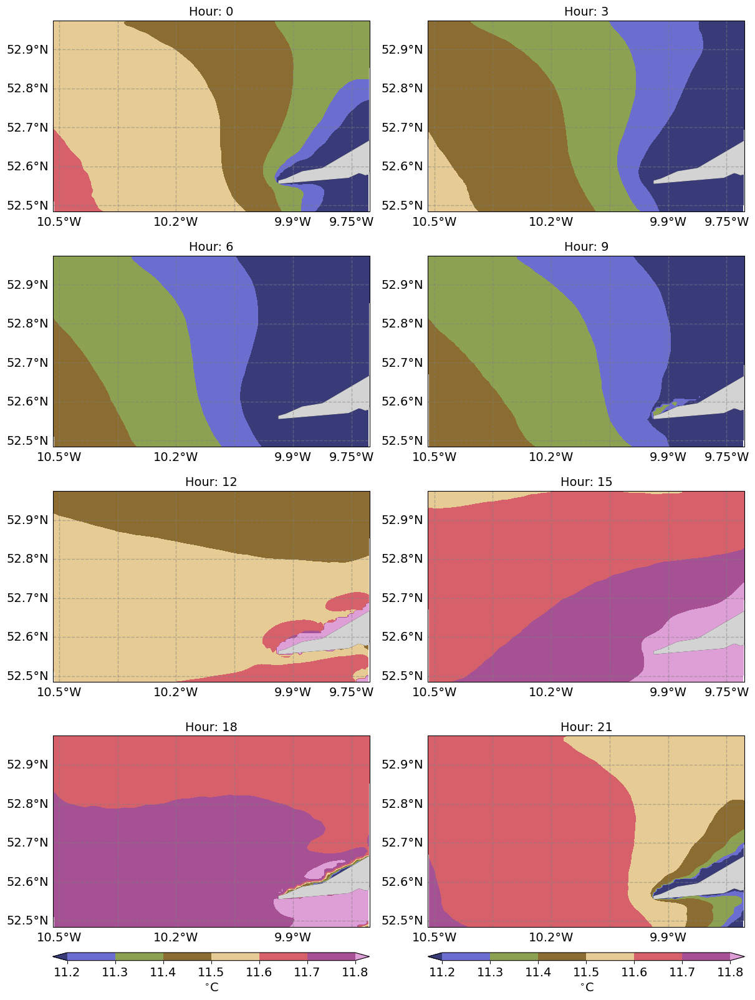

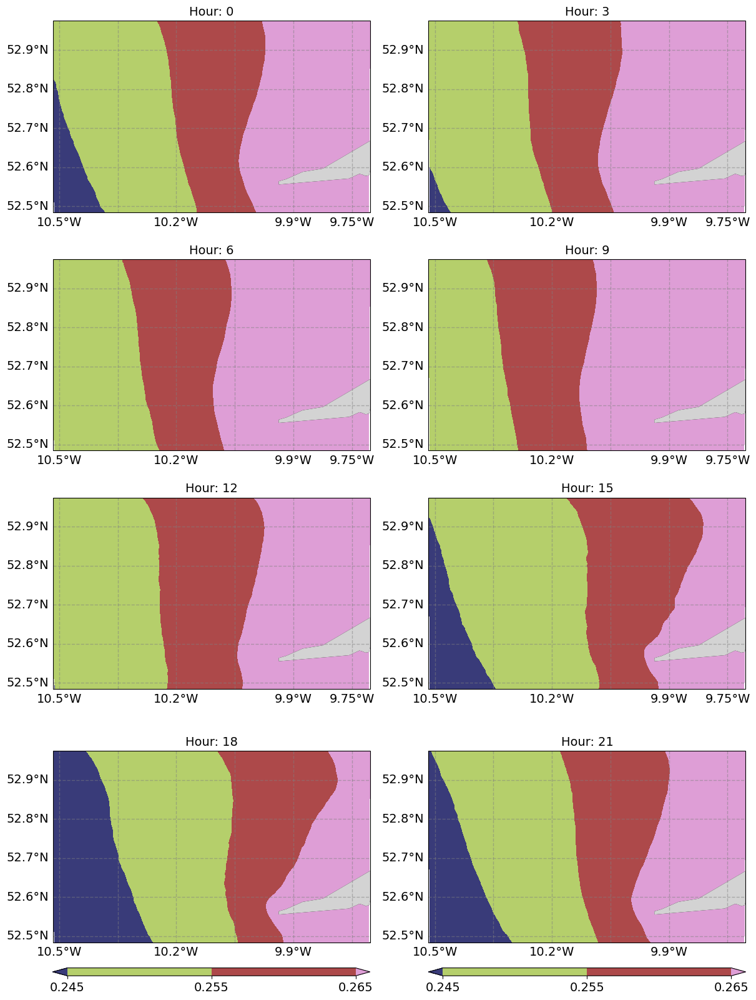

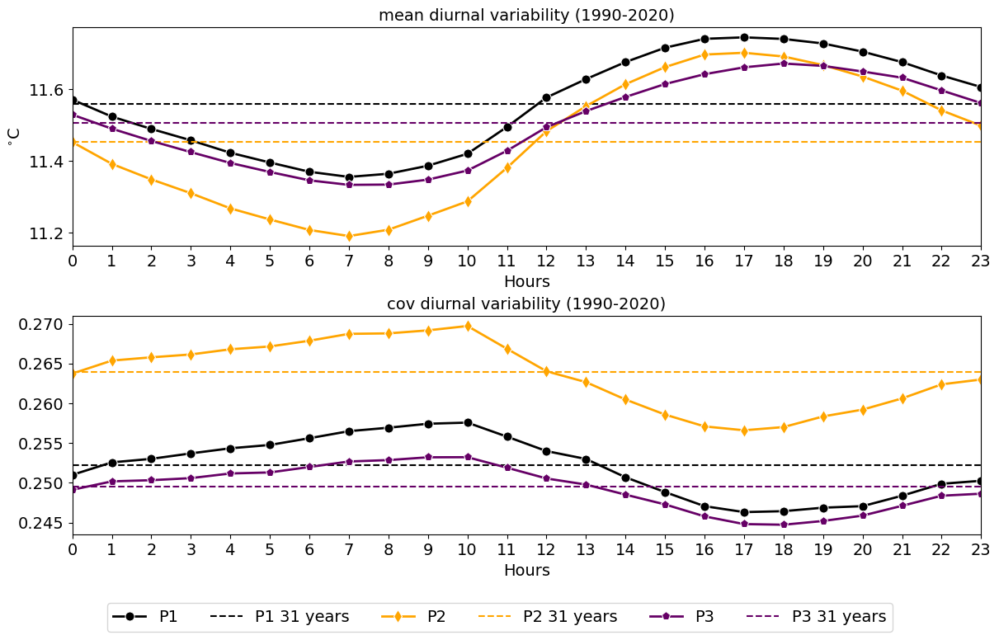

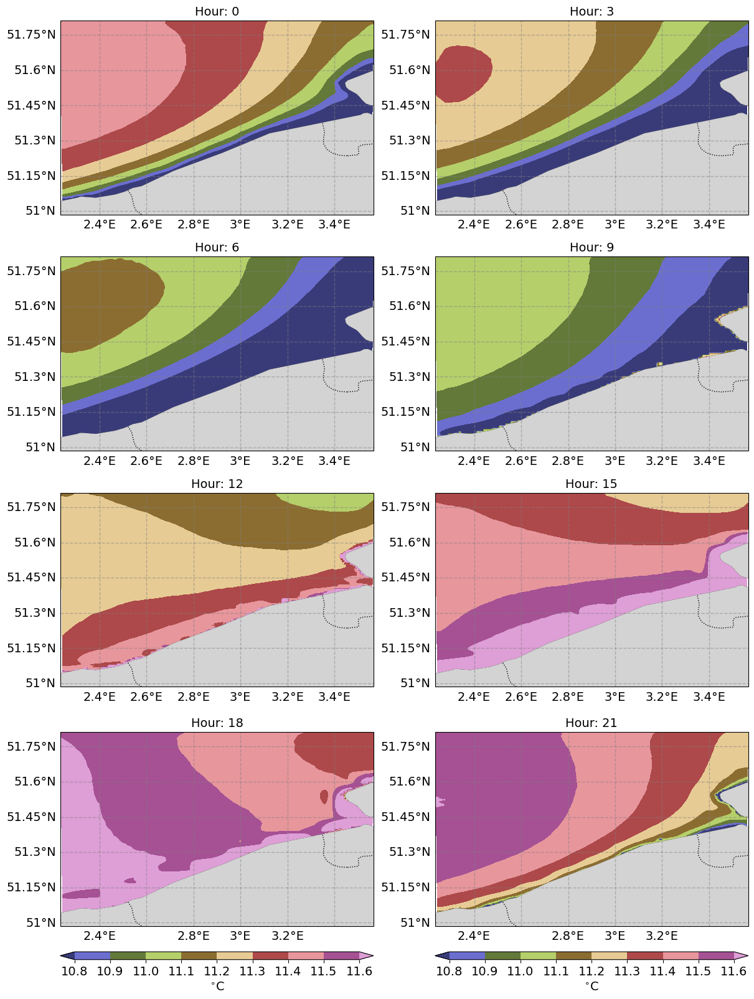

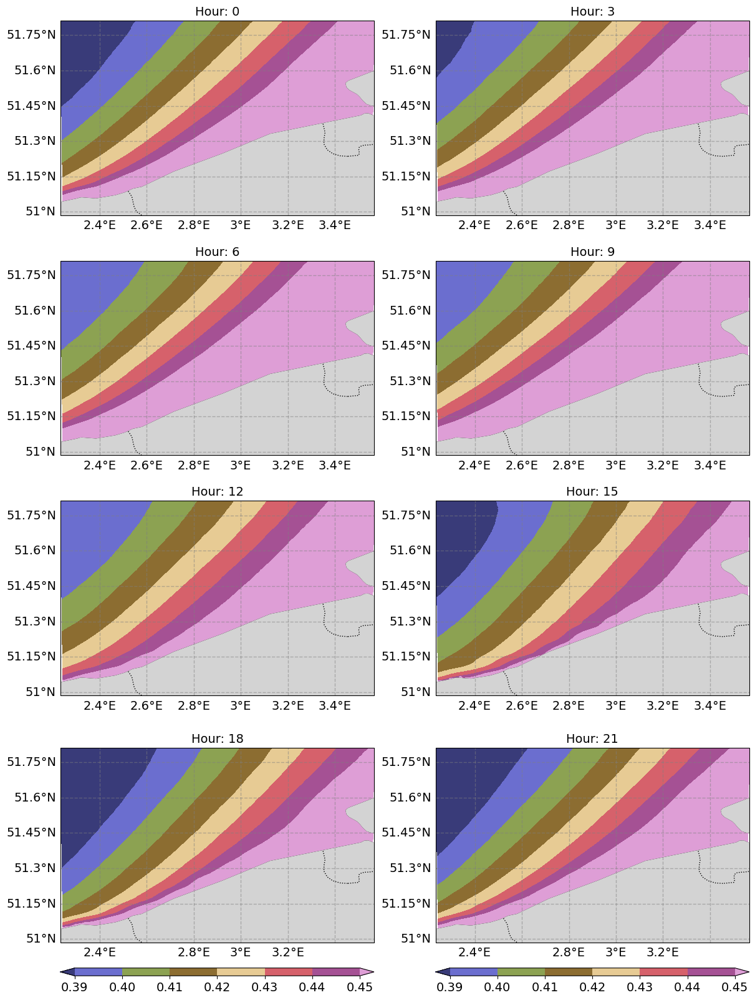

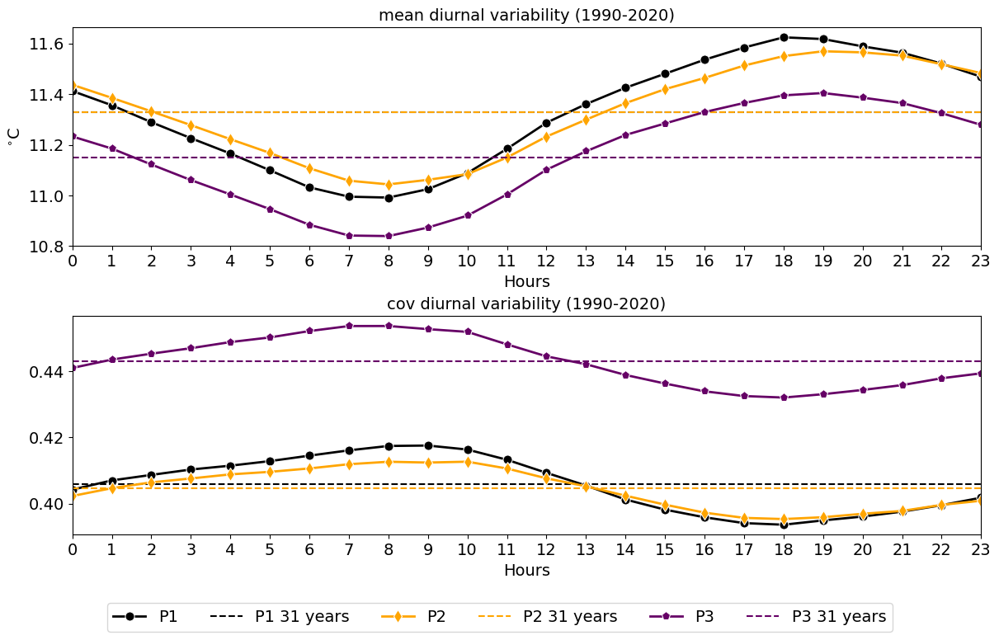

In [23]:
run = 'New_runs'
var = 'T2'
for case in cases:
    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/{var}'
    XLAND = xr.open_dataset(f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/variablewise_files/XLAND.nc')
    XLAT = XLAND.XLAT
    XLONG = XLAND.XLONG

    for j,parameter in enumerate(['mean', 'cov']):
        ds = xr.open_dataset(f'{target_dir}/{parameter}.nc')
        ds = ds.assign_coords(XLAT=XLAT, XLONG=XLONG)
        clevels = mean_clevels[case] if parameter == 'mean' else cov_clevels[case]
        cmap = cmaps[parameter]
        cbar_args_ = {'shrink':1,'cbar_label':r'$^{\circ}$C','orientation':'horizontal'} if parameter == 'mean' else {'shrink':1,'cbar_label':'','orientation':'horizontal'}
        
        rows, cols = 4,2
        fig = plt.figure(figsize=(6*cols, rows*fig_heights[case]), constrained_layout=True)
        gs = fig.add_gridspec(rows,cols)
        for i,hour in enumerate(ds.hour.values[::3]):
            cbar_args=cbar_args_ if i//cols == 3 else None
            axs = map_plotter(fig,gs[i//cols,i%cols],ds.hourly_values.sel(hour=hour)[10:-10,10:-10],'XLONG','XLAT',
                    clevels,cmap,f'Hour: {hour}',cbar_args,
                    sample_points = None)
        plt.savefig(f'{fig_dir}/{case}_hourly_{parameter}_{var}.png',dpi=300,bbox_inches='tight',pad_inches=0)


    fig = plt.figure(figsize=(12, 7), constrained_layout=True)
    gs = fig.add_gridspec(2,1)

    for j,parameter in enumerate(['mean', 'cov']):
        ds = xr.open_dataset(f'{target_dir}/{parameter}.nc')
        ds = ds.assign_coords(XLAT=XLAT, XLONG=XLONG)
        overall_df = pd.DataFrame()
        hourly_df = pd.DataFrame()
        for i,key in enumerate(all_sample_points[case].keys()):
            indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

            data = ds.overall_values.sel(south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index([0],name='Overall'))
            overall_df = pd.concat([overall_df, pointwise_df],axis=1)

            data = ds.hourly_values.sel(south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index(ds.hour, name='hour'))
            hourly_df = pd.concat([hourly_df, pointwise_df],axis=1)

        xlabel = 'Hours' if parameter == 'mean' else ''
        xlabel_ticks = ds.hour.values
        ylabel = r'$^{\circ}$C' if parameter == 'mean' else ''
        axs = variability_plotter(fig,gs[j,0],hourly_df,overall_df,f'{parameter} diurnal variability (1990-2020)',
                            'Hours',ylabel,None,None,None,xlabel_ticks=xlabel_ticks)
    # Extract legend from one of the subplots
    handles, labels = axs.get_legend_handles_labels()
    # Create a common legend below the figures
    fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.5, -0.1),fontsize=14)

    plt.savefig(f'{fig_dir}/{case}_{var}_diurnal_mean_and_cov.png',dpi=300,bbox_inches='tight',pad_inches=0)

## SWDOWN

### Overall mean statistics

In [30]:
cases = ['Portugal_coast','Ireland_coast','Netherlands_coast']
fig_widths = {'Portugal_coast': 6,
              'Ireland_coast': 6,
              'Netherlands_coast': 6}
fig_heights = {'Portugal_coast': 5,
              'Ireland_coast': 4,
              'Netherlands_coast': 4}
mean_clevels = {'Portugal_coast':np.arange(135,165.1,1),
                 'Ireland_coast':np.arange(95,112.1,1),
                 'Netherlands_coast':np.arange(95,115.1,1)}
cov_clevels = {'Portugal_coast':np.arange(1.53,1.671,0.01),
                 'Ireland_coast':np.arange(1.74,1.86,0.01),
                 'Netherlands_coast':np.arange(1.6,01.91,0.01)}
cmaps = {'mean':'tab20b',
         'cov':'tab20b'}

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (

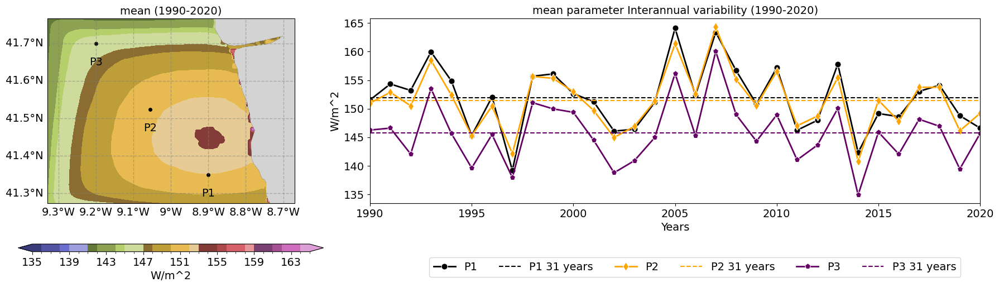

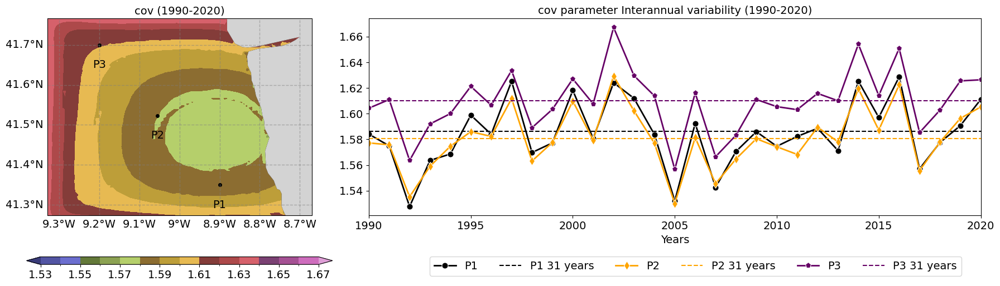

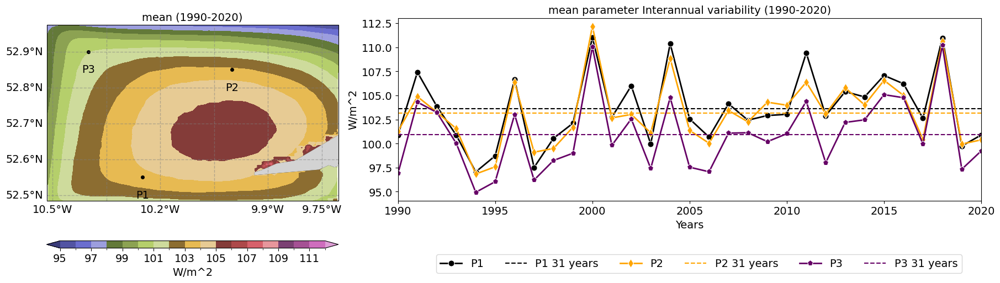

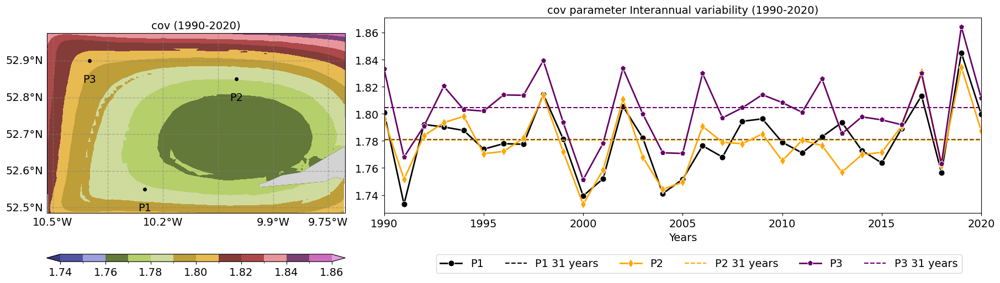

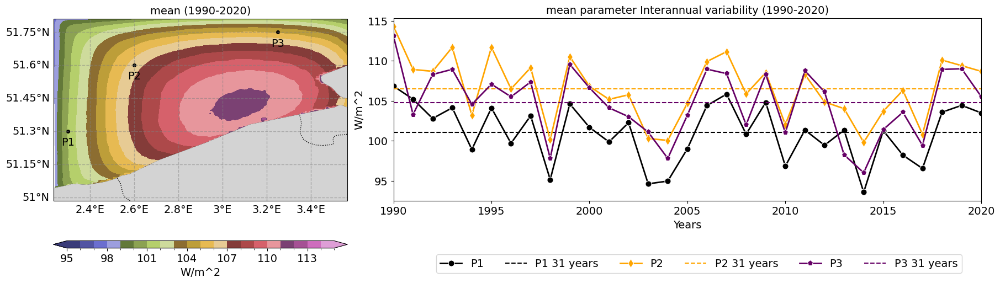

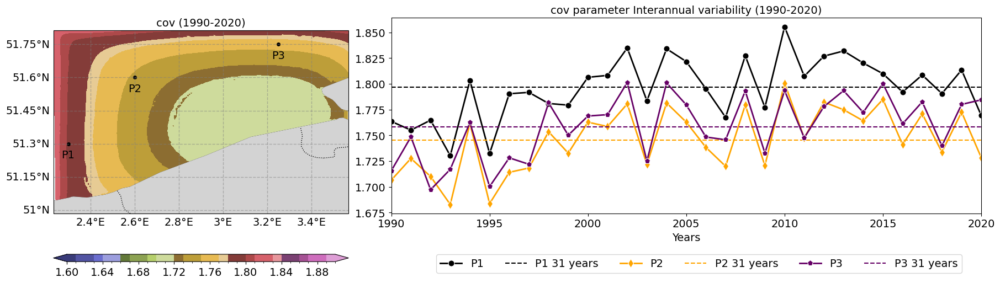

In [31]:
run = 'New_runs'
var = 'SWDOWN2'
for case in cases:
    # A small problem in the data is that the XLAT and XLONG are missing from T2 and SWDOWN2 source files.
    # Which continued into the statistics as well
    XLAND = xr.open_dataset(f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/variablewise_files/XLAND.nc')
    XLAT = XLAND.XLAT
    XLONG = XLAND.XLONG

    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/{var}'

    for j,parameter in enumerate(['mean', 'cov']):
        ds = xr.open_dataset(f'{target_dir}/{parameter}.nc')
        ds = ds.assign_coords(XLAT=XLAT, XLONG=XLONG)

        fig = plt.figure(figsize=(18, 5), constrained_layout=True)
        gs = fig.add_gridspec(1,3)
    
        clevels = mean_clevels[case] if parameter == 'mean' else cov_clevels[case]
        cmap = cmaps[parameter]
        cbar_args= {'shrink':1,'cbar_label':'W/m^2','orientation':'horizontal'} if parameter == 'mean' else {'shrink':1,'cbar_label':'','orientation':'horizontal'}
        map_plotter(fig,gs[0,0],ds.overall_values[10:-10,10:-10],'XLONG','XLAT',
                    clevels,cmap,f'{parameter} (1990-2020)',cbar_args,
                    sample_points = all_sample_points[case])

        overall_df = pd.DataFrame()
        yearly_df = pd.DataFrame()
        for i,key in enumerate(all_sample_points[case].keys()):
            indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

            data = ds.overall_values.sel(south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index([0],name='Overall'))
            overall_df = pd.concat([overall_df, pointwise_df],axis=1)

            data = ds.yearly_values.sel(south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index(ds.year, name='year'))
            yearly_df = pd.concat([yearly_df, pointwise_df],axis=1)
        xlabel = 'Years'
        ylabel = 'W/m^2' if parameter == 'mean' else ''
        axs = variability_plotter(fig,gs[0,1:3],yearly_df,overall_df,f'{parameter} parameter Interannual variability (1990-2020)',
                            'Years',ylabel,None,None,None)

        # Extract legend from one of the subplots
        handles, labels = axs.get_legend_handles_labels()
        # Create a common legend below the figures
        fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.7, -0.00),fontsize=14)

        plt.savefig(f'{fig_dir}/{case}_overall_{parameter}_and_interannual_{parameter}_{var}.png',dpi=300,bbox_inches='tight',pad_inches=0)

### Monthly mean statistics

In [32]:
months_indices = [12,1,2,3,4,5,6,7,8,9,10,11]
months_in_seasonal_order = ['Dec','Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov']
mean_clevels = {'Portugal_coast':np.arange(50,255.1,25),
                 'Ireland_coast':np.arange(25,200.1,25),
                 'Netherlands_coast':np.arange(25,200.1,25)}
cov_clevels = {'Portugal_coast':np.arange(1.2,21,0.01),
                 'Ireland_coast':np.arange(1.2,2.1,0.01),
                 'Netherlands_coast':np.arange(1.2,2.1,0.01)}
cmaps = {'mean':'tab20b',
         'cov':'tab20b'}

Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (

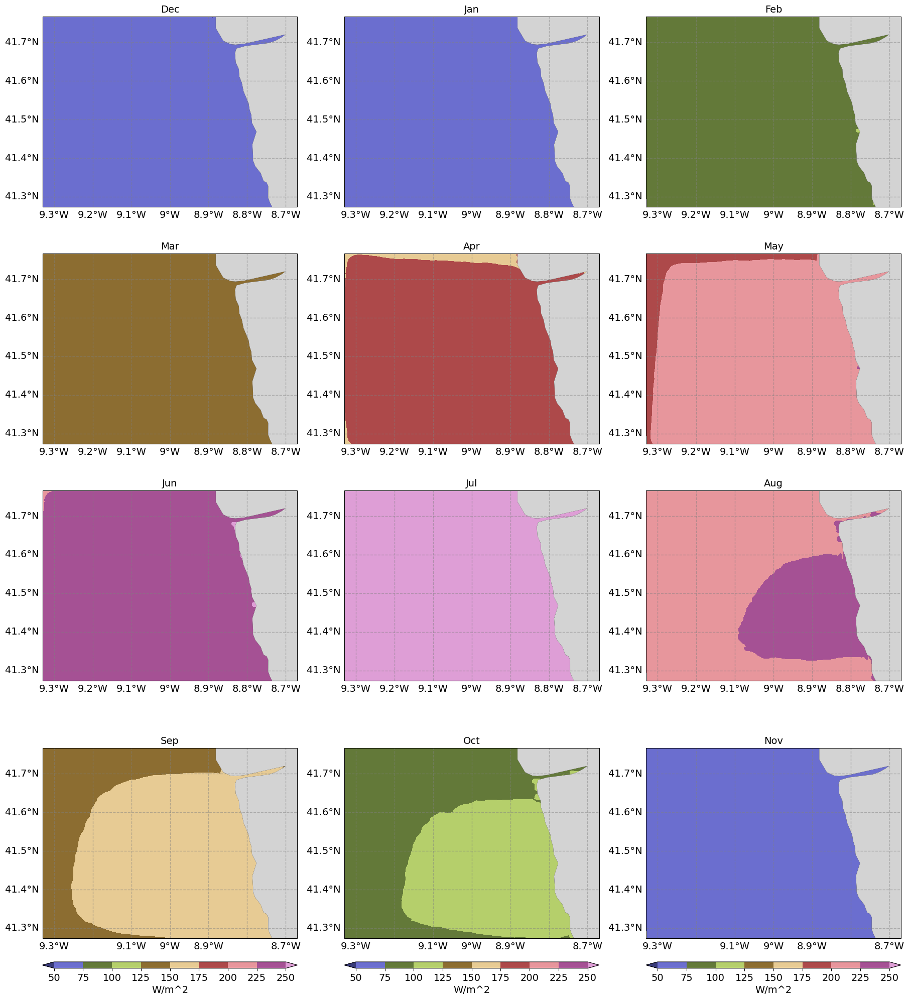

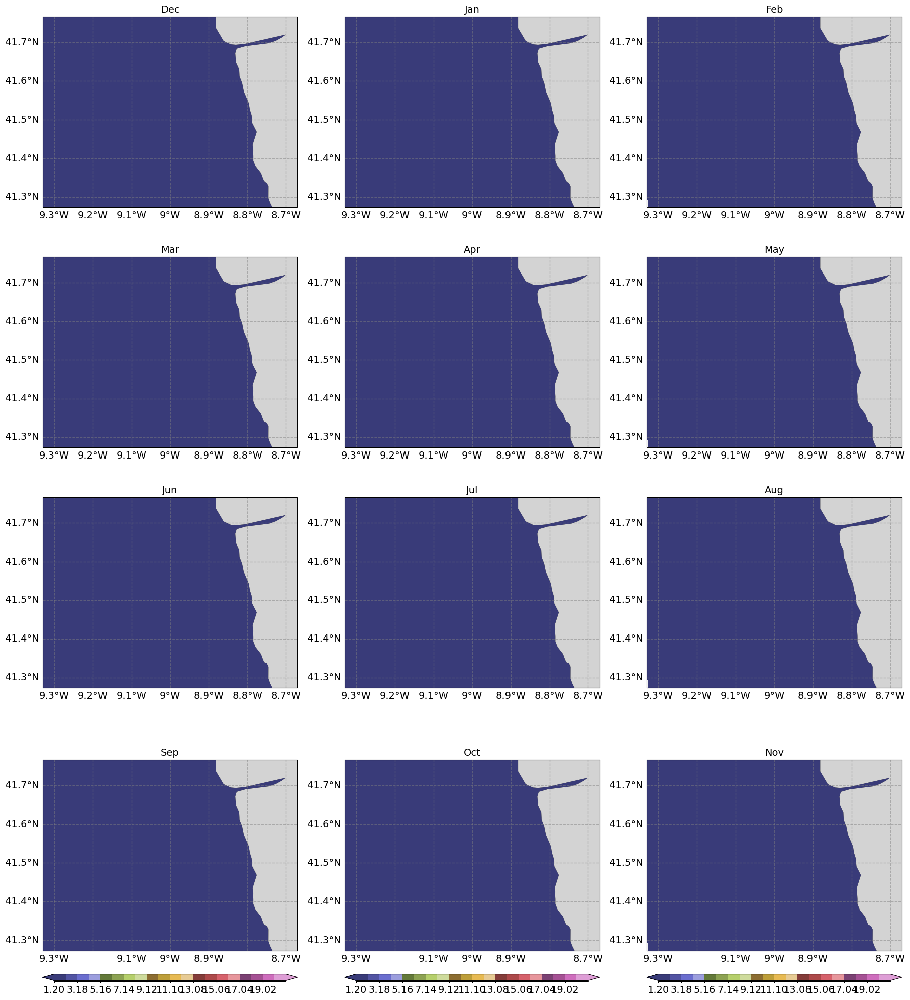

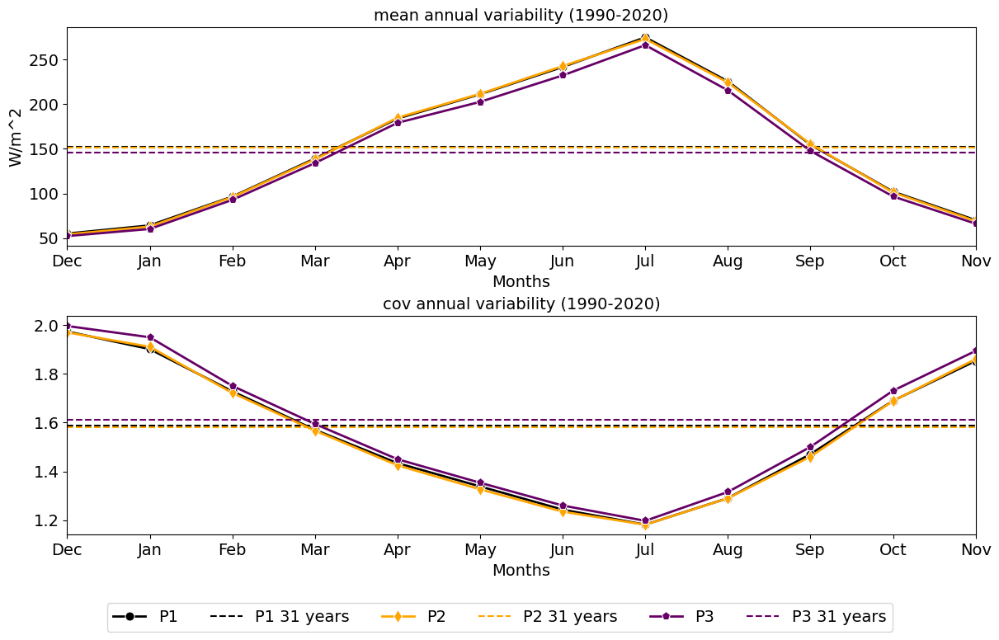

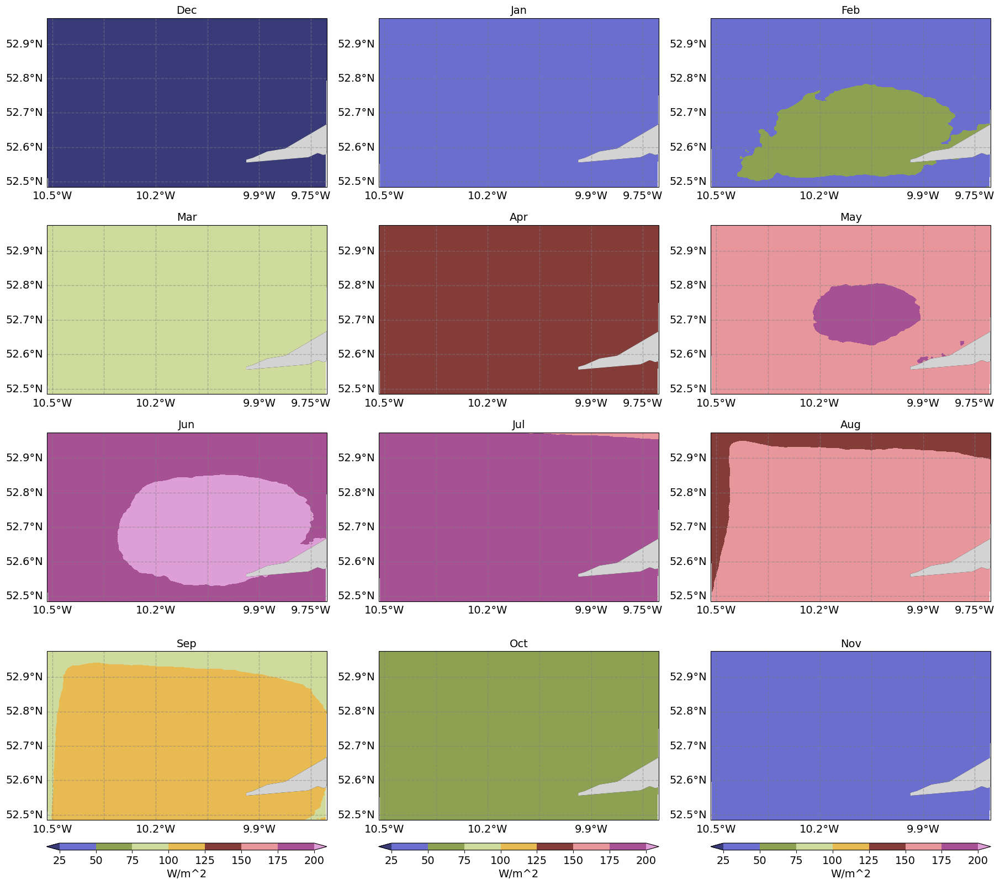

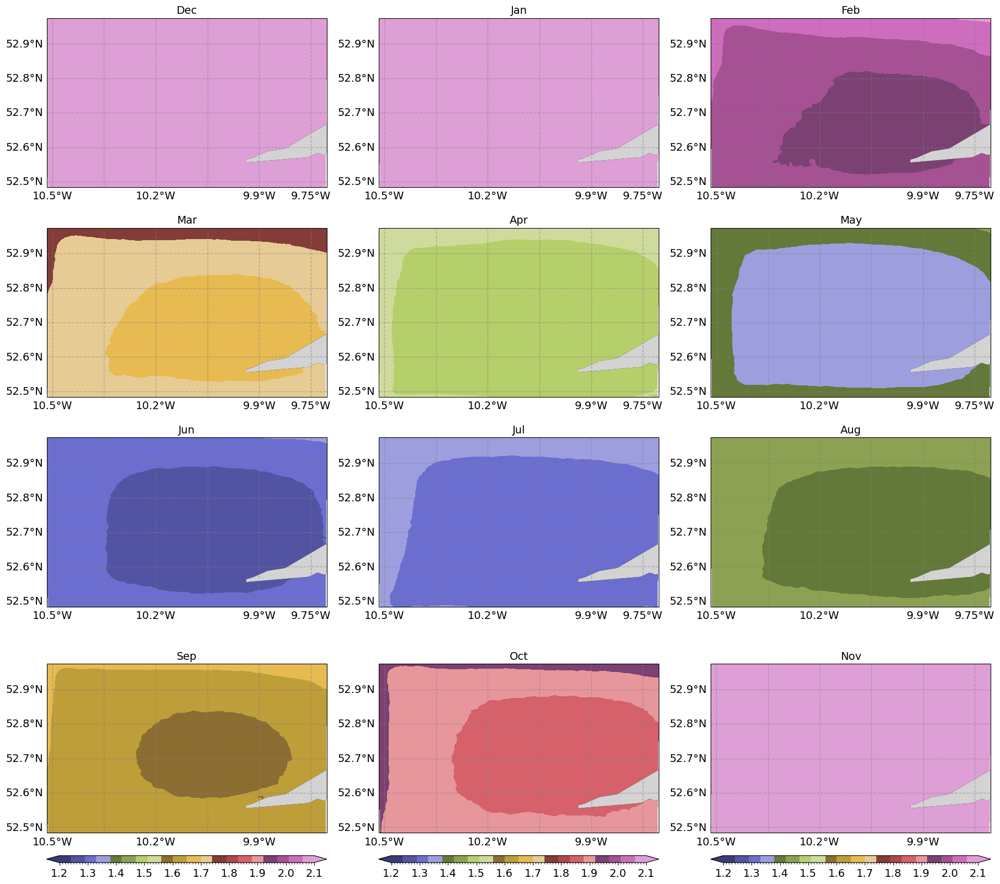

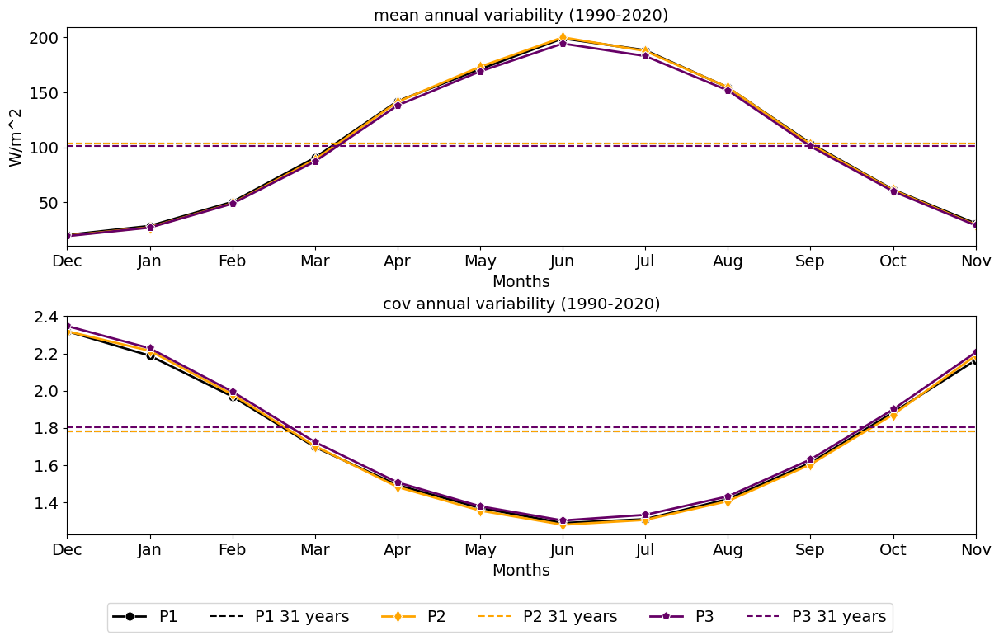

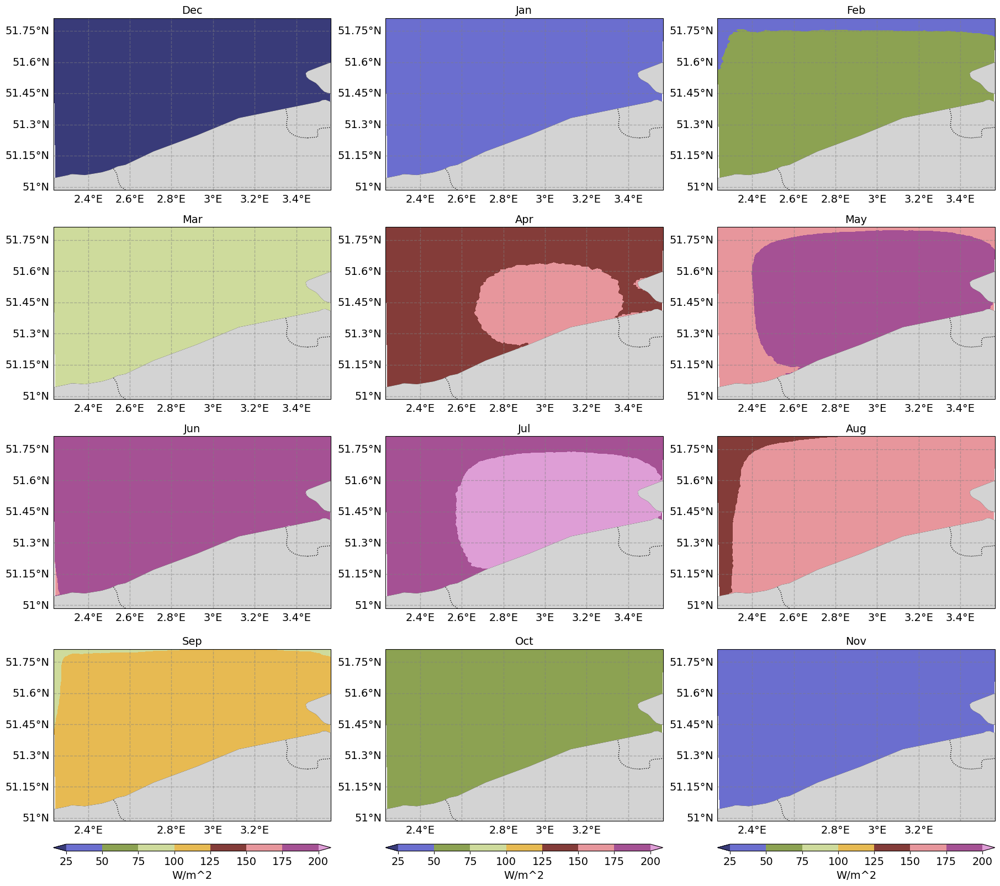

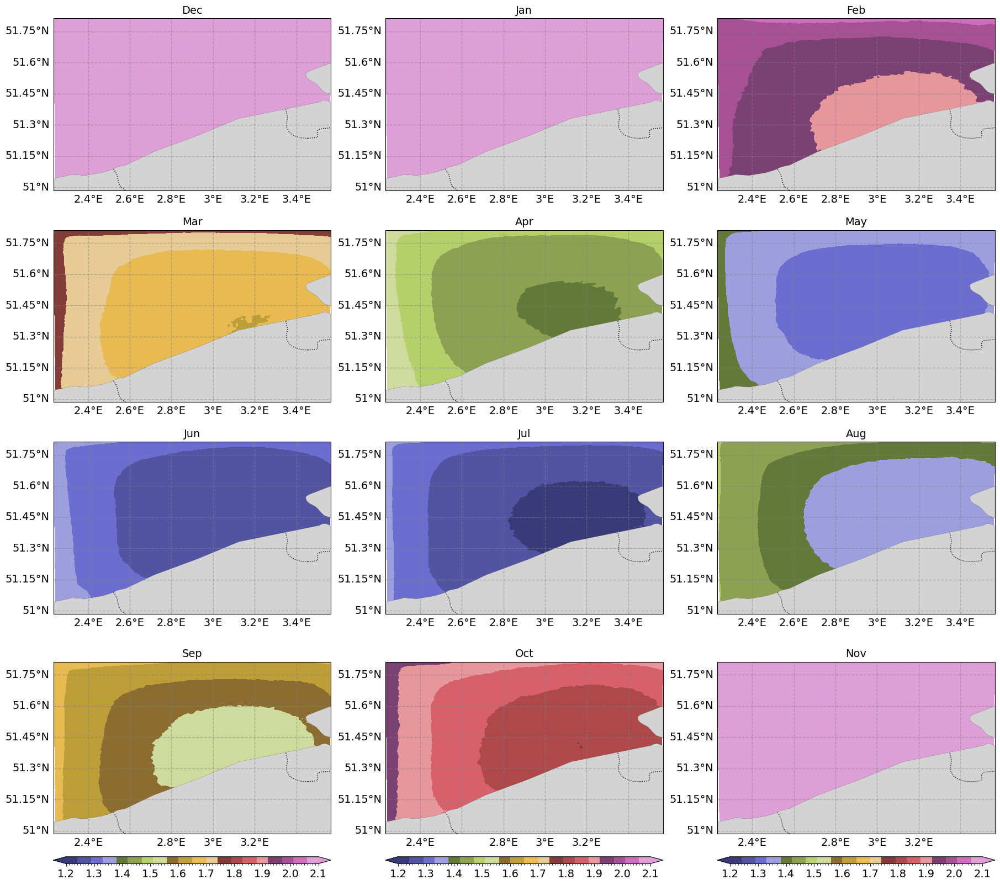

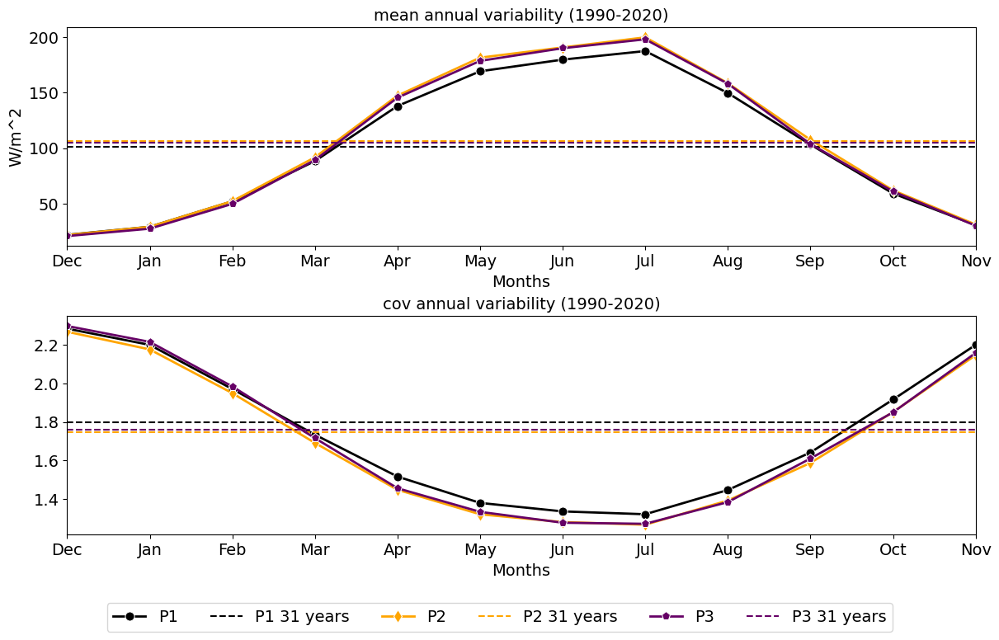

In [33]:
run = 'New_runs'
var = 'SWDOWN2'
for case in cases:
    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/{var}'

    XLAND = xr.open_dataset(f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/variablewise_files/XLAND.nc')
    XLAT = XLAND.XLAT
    XLONG = XLAND.XLONG

    for j,parameter in enumerate(['mean', 'cov']):
        ds = xr.open_dataset(f'{target_dir}/{parameter}.nc')
        ds = ds.assign_coords(XLAT=XLAT, XLONG=XLONG)
        clevels = mean_clevels[case] if parameter == 'mean' else cov_clevels[case]
        cmap = cmaps[parameter]
        cbar_args_ = {'shrink':1,'cbar_label':'W/m^2','orientation':'horizontal'} if parameter == 'mean' else {'shrink':1,'cbar_label':'','orientation':'horizontal'}
        rows, cols = 4,3
        fig = plt.figure(figsize=(6*cols, rows*fig_heights[case]), constrained_layout=True)
        gs = fig.add_gridspec(rows,cols)
        for i,month in enumerate(months_indices):
            cbar_args=cbar_args_ if i//cols == 3 else None
            axs = map_plotter(fig,gs[i//cols,i%cols],ds.monthly_values.sel(month=month)[10:-10,10:-10],'XLONG','XLAT',
                    clevels,cmap,f'{months[month-1]}',cbar_args,
                    sample_points = None)
        plt.savefig(f'{fig_dir}/{case}_monthly_{parameter}_{var}.png',dpi=300,bbox_inches='tight',pad_inches=0)

    fig = plt.figure(figsize=(12, 7), constrained_layout=True)
    gs = fig.add_gridspec(2,1)

    for j,parameter in enumerate(['mean', 'cov']):
        ds = xr.open_dataset(f'{target_dir}/{parameter}.nc')
        ds = ds.assign_coords(XLAT=XLAT, XLONG=XLONG)
        overall_df = pd.DataFrame()
        monthly_df = pd.DataFrame()
        for i,key in enumerate(all_sample_points[case].keys()):
            indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

            data = ds.overall_values.sel(south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index([0],name='Overall'))
            overall_df = pd.concat([overall_df, pointwise_df],axis=1)

            data = ds.monthly_values.sel(south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index(months, name='month'))
            monthly_df = pd.concat([monthly_df, pointwise_df],axis=1)
        monthly_df = monthly_df.reindex(months_in_seasonal_order)

        xlabel = 'Months' if parameter == 'mean' else ''
        xlabel_ticks = months_in_seasonal_order
        ylabel = 'W/m^2' if parameter == 'mean' else ''
        axs = variability_plotter(fig,gs[j,0],monthly_df,overall_df,f'{parameter} annual variability (1990-2020)',
                            'Months',ylabel,None,None,None,xlabel_ticks=xlabel_ticks)
    # Extract legend from one of the subplots
    handles, labels = axs.get_legend_handles_labels()
    # Create a common legend below the figures
    fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.5, -0.1),fontsize=14)

    plt.savefig(f'{fig_dir}/{case}_{var}_annual_mean_and_cov_variability.png',dpi=300,bbox_inches='tight',pad_inches=0)

### Diurnal mean statistics

In [37]:
months_indices = [12,1,2,3,4,5,6,7,8,9,10,11]
months_in_seasonal_order = ['Dec','Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov']
mean_clevels = {'Portugal_coast':np.arange(50.,500.1,10),
                 'Ireland_coast':np.arange(50,300.1,10),
                 'Netherlands_coast':np.arange(50,300.1,10)}
cov_clevels = {'Portugal_coast':np.arange(0.15,0.21,0.01),
                 'Ireland_coast':np.arange(0.245,0.271,0.01),
                 'Netherlands_coast':np.arange(0.39,0.451,0.01)}
cmaps = {'mean':'tab20b',
         'cov':'tab20b'}

/home/harish/.conda/envs/wrf-python-stable/lib/python3.10/site-packages/matplotlib/contour.py:1479: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/home/harish/.conda/envs/wrf-python-stable/lib/python3.10/site-packages/matplotlib/contour.py:1480: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())


Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)
Closest indices in the order of latitude (y) and longitude (x) are : (26, 79)
Closest indices in the order of latitude (y) and longitude (x) are : (64, 54)
Closest indices in the order of latitude (y) and longitude (x) are : (102, 31)


/home/harish/.conda/envs/wrf-python-stable/lib/python3.10/site-packages/matplotlib/contour.py:1479: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/home/harish/.conda/envs/wrf-python-stable/lib/python3.10/site-packages/matplotlib/contour.py:1480: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())


Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)
Closest indices in the order of latitude (y) and longitude (x) are : (24, 45)
Closest indices in the order of latitude (y) and longitude (x) are : (89, 77)
Closest indices in the order of latitude (y) and longitude (x) are : (100, 25)


/home/harish/.conda/envs/wrf-python-stable/lib/python3.10/site-packages/matplotlib/contour.py:1479: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/home/harish/.conda/envs/wrf-python-stable/lib/python3.10/site-packages/matplotlib/contour.py:1480: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())


Closest indices in the order of latitude (y) and longitude (x) are : (78, 18)
Closest indices in the order of latitude (y) and longitude (x) are : (142, 59)
Closest indices in the order of latitude (y) and longitude (x) are : (175, 146)
Closest indices in the order of latitude (y) and longitude (x) are : (78, 18)
Closest indices in the order of latitude (y) and longitude (x) are : (142, 59)
Closest indices in the order of latitude (y) and longitude (x) are : (175, 146)


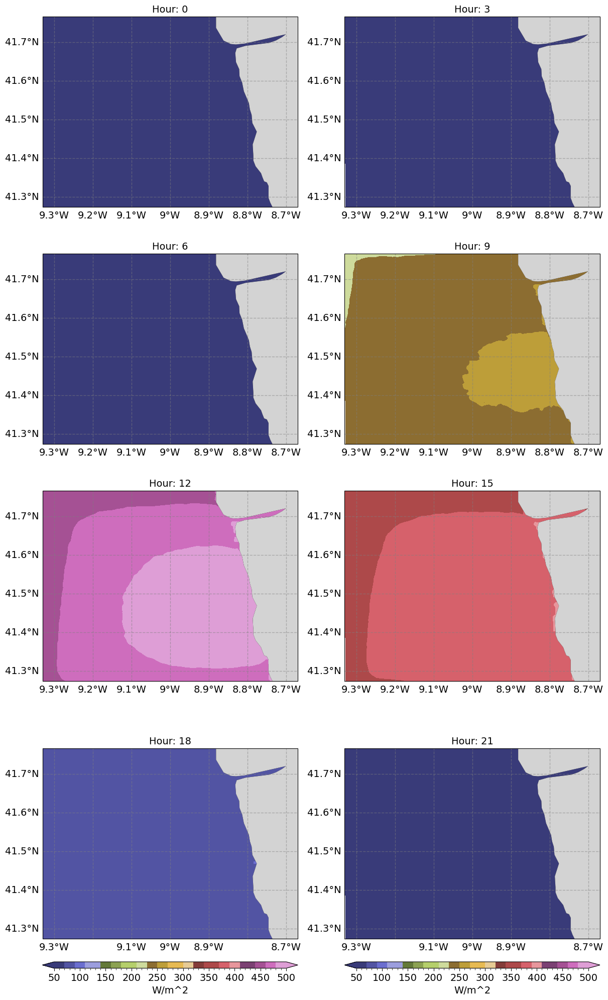

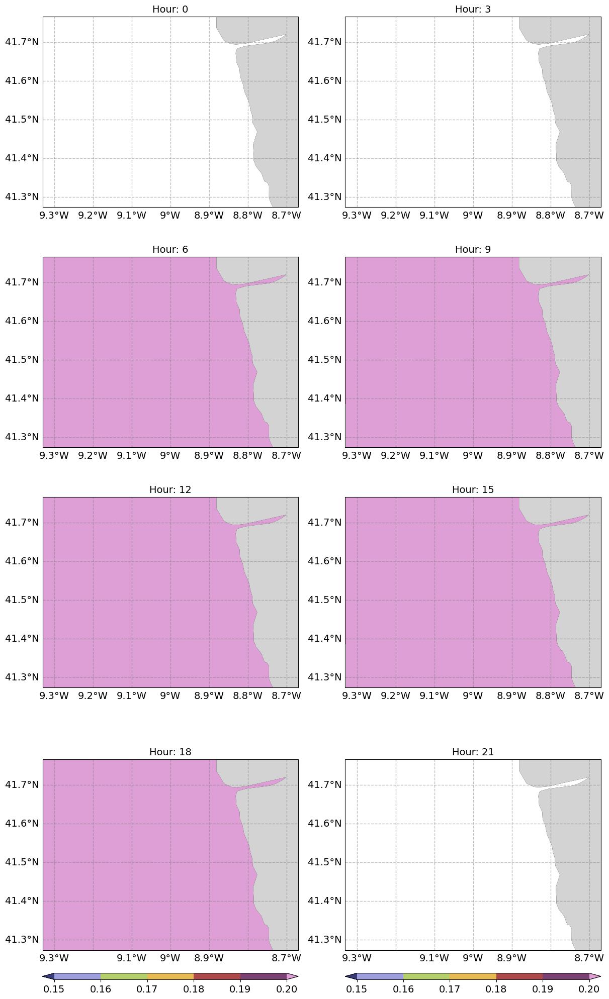

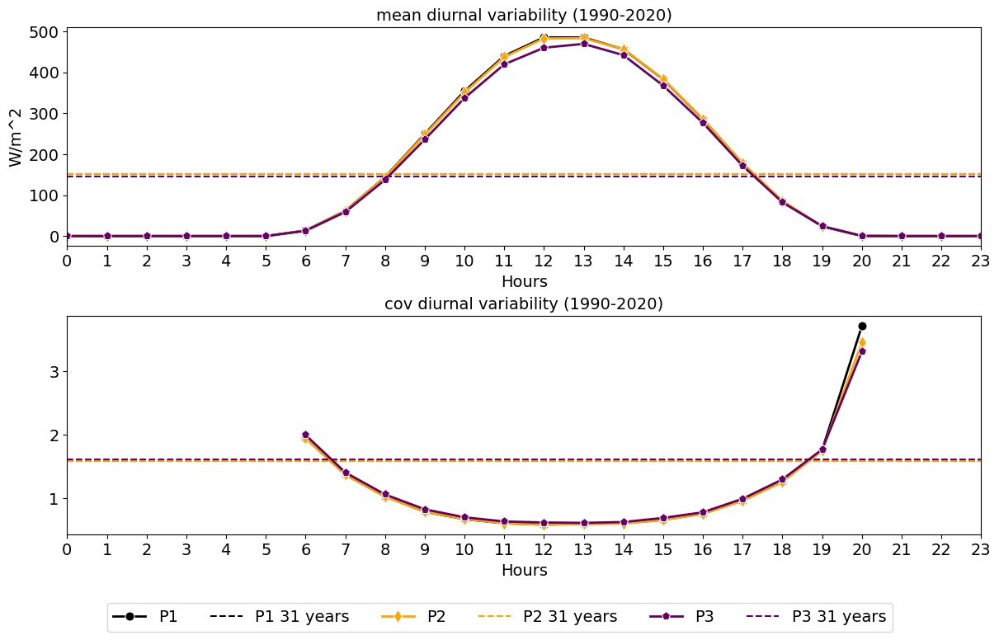

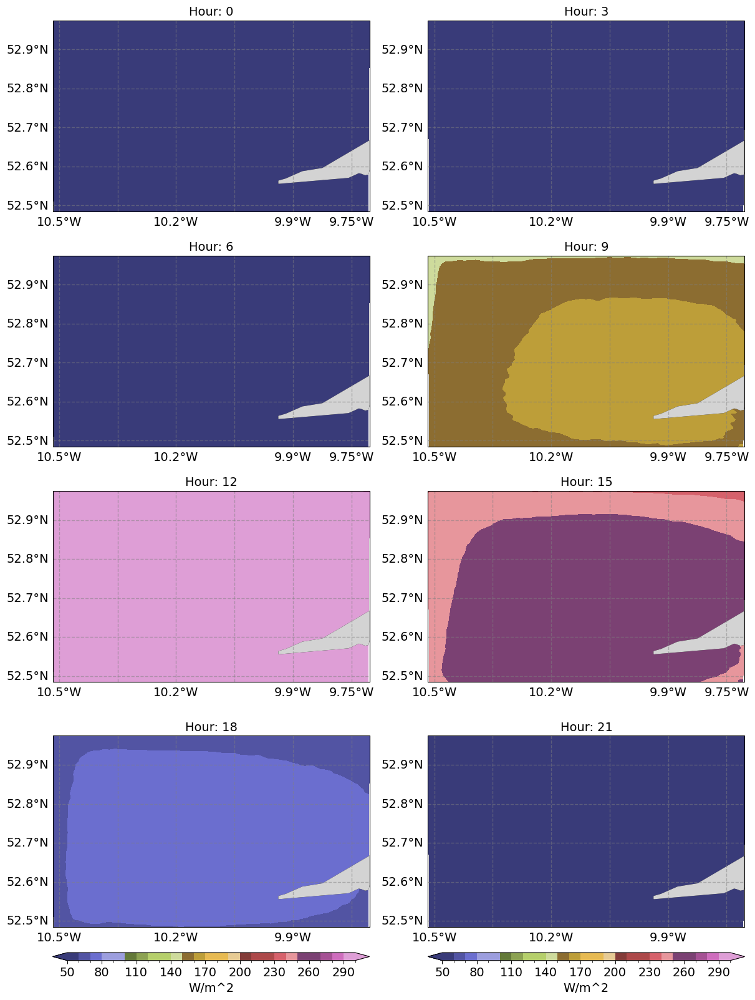

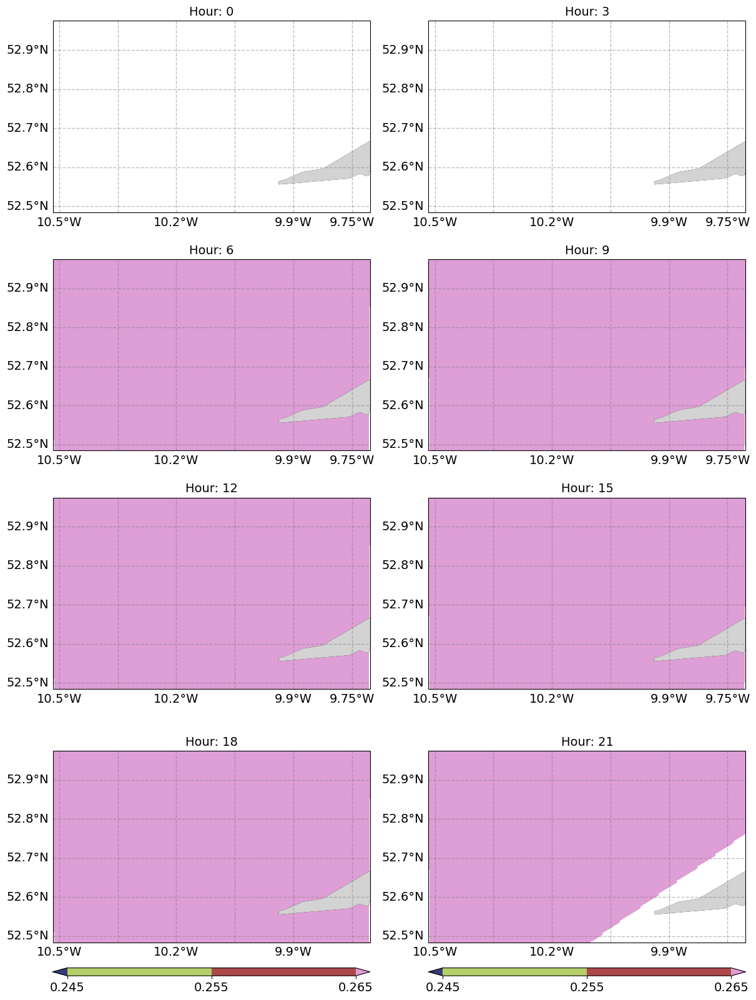

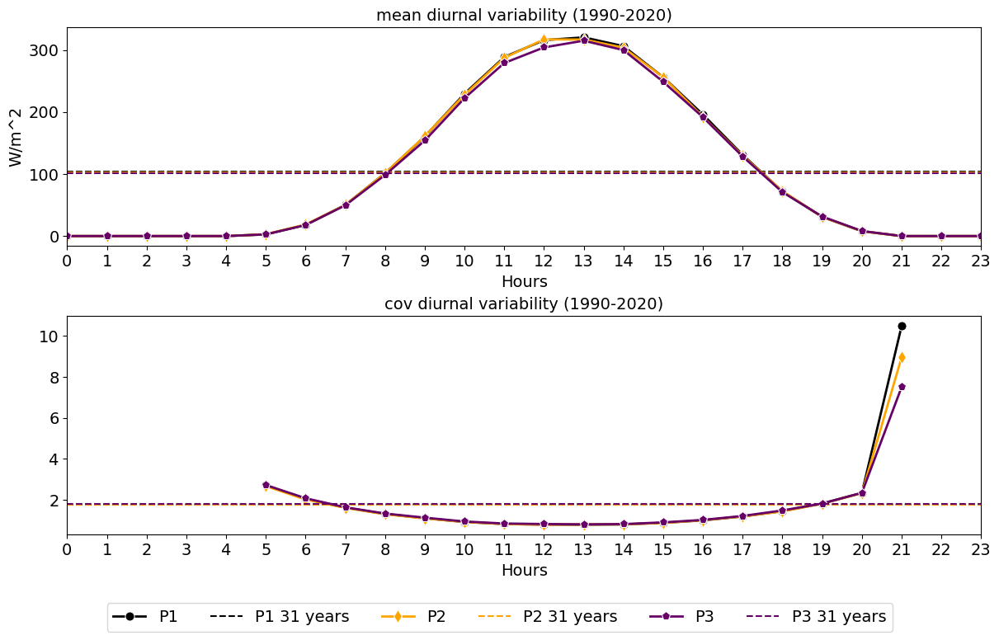

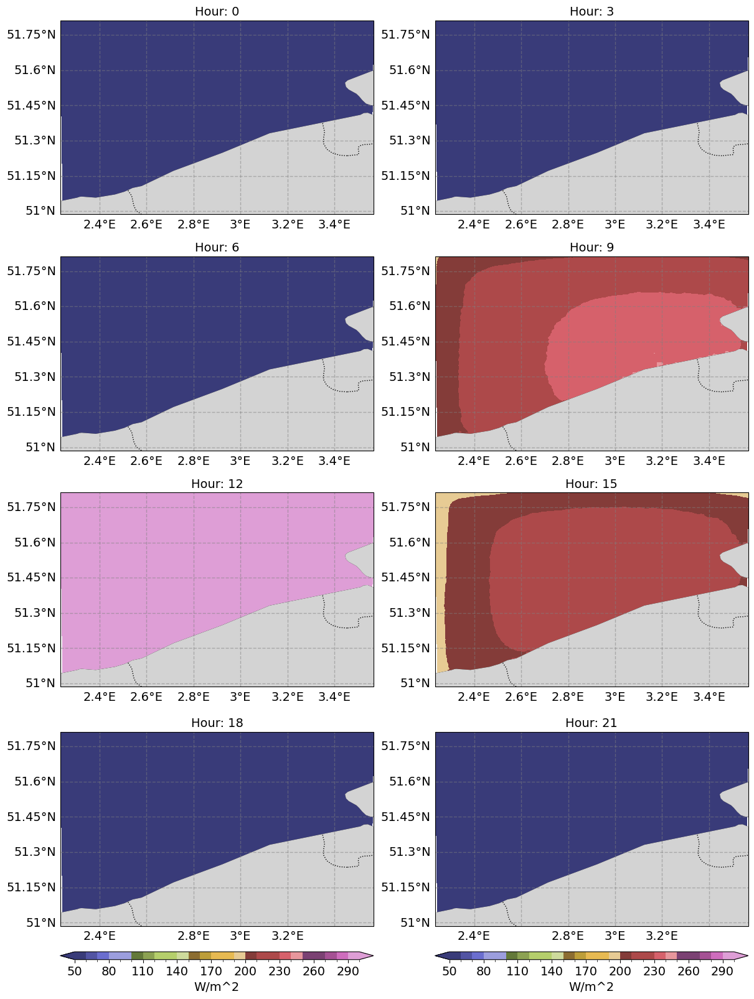

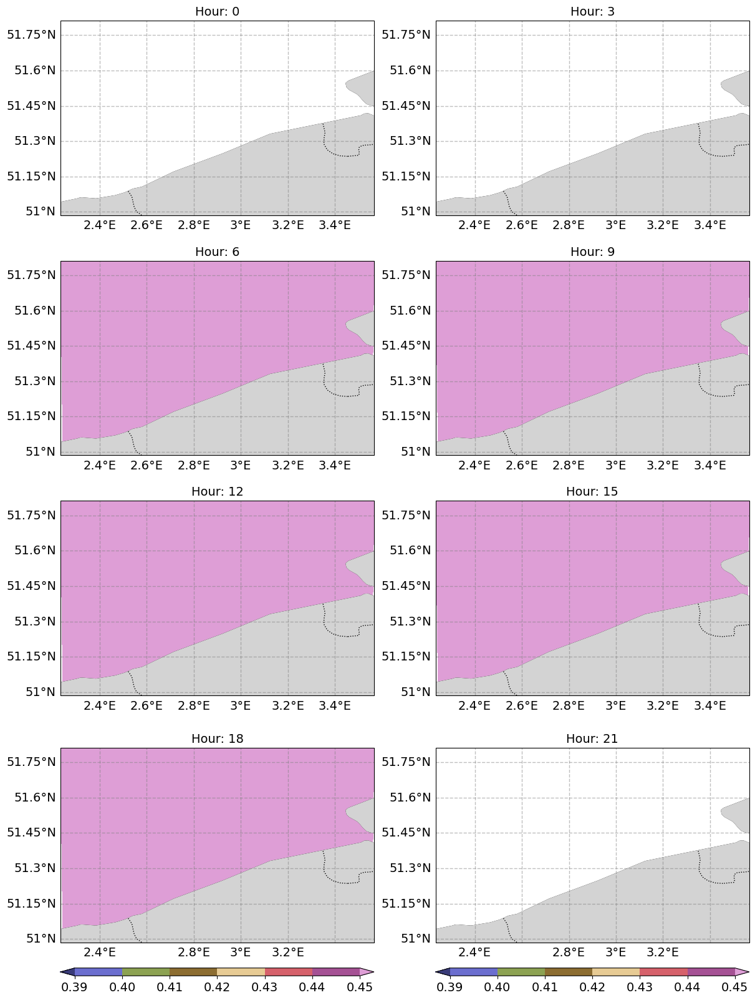

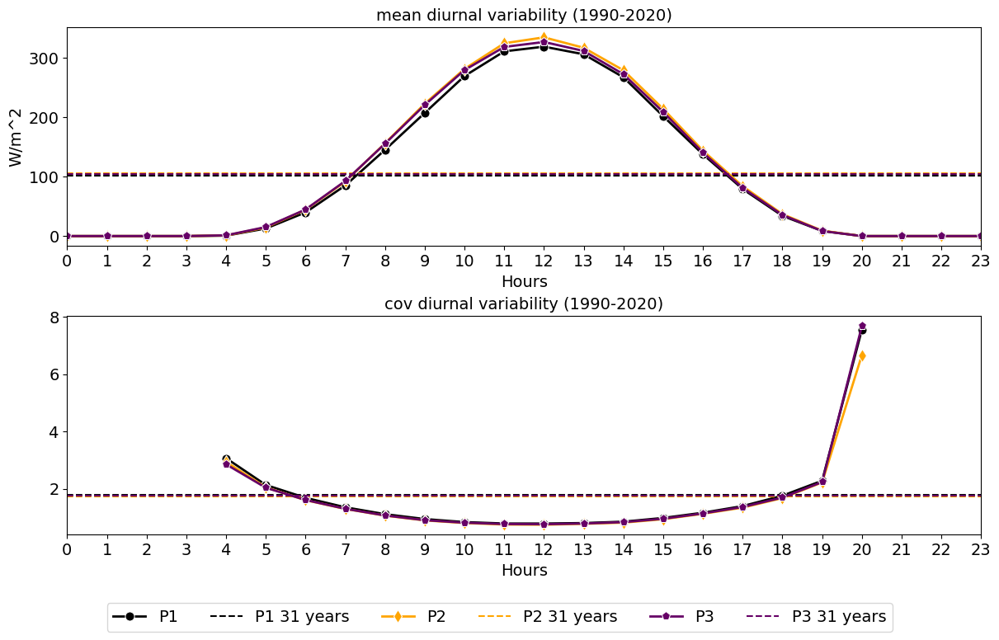

In [38]:
run = 'New_runs'
var = 'SWDOWN2'
for case in cases:
    target_dir=f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/statistics_files/{var}'
    XLAND = xr.open_dataset(f'{root_dir}/WRFV4.4/EU_SCORES/{run}/{case}/Postprocessed/variablewise_files/XLAND.nc')
    XLAT = XLAND.XLAT
    XLONG = XLAND.XLONG

    for j,parameter in enumerate(['mean', 'cov']):
        ds = xr.open_dataset(f'{target_dir}/{parameter}.nc')
        ds = ds.assign_coords(XLAT=XLAT, XLONG=XLONG)
        clevels = mean_clevels[case] if parameter == 'mean' else cov_clevels[case]
        cmap = cmaps[parameter]
        cbar_args_ = {'shrink':1,'cbar_label':'W/m^2','orientation':'horizontal'} if parameter == 'mean' else {'shrink':1,'cbar_label':'','orientation':'horizontal'}
        
        rows, cols = 4,2
        fig = plt.figure(figsize=(6*cols, rows*fig_heights[case]), constrained_layout=True)
        gs = fig.add_gridspec(rows,cols)
        for i,hour in enumerate(ds.hour.values[::3]):
            cbar_args=cbar_args_ if i//cols == 3 else None
            axs = map_plotter(fig,gs[i//cols,i%cols],ds.hourly_values.sel(hour=hour)[10:-10,10:-10],'XLONG','XLAT',
                    clevels,cmap,f'Hour: {hour}',cbar_args,
                    sample_points = None)
        plt.savefig(f'{fig_dir}/{case}_hourly_{parameter}_{var}.png',dpi=300,bbox_inches='tight',pad_inches=0)


    fig = plt.figure(figsize=(12, 7), constrained_layout=True)
    gs = fig.add_gridspec(2,1)

    for j,parameter in enumerate(['mean', 'cov']):
        ds = xr.open_dataset(f'{target_dir}/{parameter}.nc')
        ds = ds.assign_coords(XLAT=XLAT, XLONG=XLONG)
        overall_df = pd.DataFrame()
        hourly_df = pd.DataFrame()
        for i,key in enumerate(all_sample_points[case].keys()):
            indices = find_nearest_indice(ds.XLAT,ds.XLONG,all_sample_points[case][key][0],all_sample_points[case][key][1])

            data = ds.overall_values.sel(south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index([0],name='Overall'))
            overall_df = pd.concat([overall_df, pointwise_df],axis=1)

            data = ds.hourly_values.sel(south_north=indices[0],west_east=indices[1]).values
            pointwise_df = pd.DataFrame({key: data}, index=pd.Index(ds.hour, name='hour'))
            hourly_df = pd.concat([hourly_df, pointwise_df],axis=1)

        xlabel = 'Hours' if parameter == 'mean' else ''
        xlabel_ticks = ds.hour.values
        ylabel = 'W/m^2' if parameter == 'mean' else ''
        axs = variability_plotter(fig,gs[j,0],hourly_df,overall_df,f'{parameter} diurnal variability (1990-2020)',
                            'Hours',ylabel,None,None,None,xlabel_ticks=xlabel_ticks)
    # Extract legend from one of the subplots
    handles, labels = axs.get_legend_handles_labels()
    # Create a common legend below the figures
    fig.legend(handles, labels, loc='lower center', ncol=len(labels), bbox_to_anchor=(0.5, -0.1),fontsize=14)

    plt.savefig(f'{fig_dir}/{case}_{var}_diurnal_mean_and_cov.png',dpi=300,bbox_inches='tight',pad_inches=0)